## Imports

In [25]:
# data pre-processing
import pickle
import numpy as np
import pandas as pd
from epiweeks import Week
from datetime import timedelta
import os

# pipeline
from sklearn.compose import make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV

# evaluation
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# custom functions
import sys
sys.path.append(r"C:\Users\User\Documents\projects\LHL_final_project_influenza_forecasting\src")
from evaluate_model import *
from prediction_intervals import *

# Interactivity
from ipywidgets import interact, widgets

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
# sns.set()
sns.set_theme(style="white", context='poster')
plt.rcParams['figure.figsize'] = [20,10]
COLOR = 'black'
plt.rcParams['text.color'] = COLOR
plt.rcParams['axes.labelcolor'] = COLOR
plt.rcParams['xtick.color'] = COLOR
plt.rcParams['ytick.color'] = COLOR

# Plotly
import plotly.graph_objs as go
from plotly.offline import iplot, plot, init_notebook_mode
init_notebook_mode(connected=True)
import plotly_express as px

# cufflinks is a wrapper on plotly
import cufflinks as cf
cf.go_offline(connected=True)

## Add New Data

In [2]:
# add new week of data

new_data = {'Surveillance Week':[47],
            'A(H1N1)pdm09':[119],
            'A(H3N2)':	[2214],
            'A(Unsubtyped)':[5424],
            'Influenza B':[16],
            'Percent Positive A':[23.1],
            'Percent Positive B':[0.0]}

In [3]:
# add new data

new_data_df = pd.DataFrame.from_dict(new_data)
new_data_df = new_data_df.iloc[:,0:5]

# add year
for i in range(len(new_data_df)):
    if int(new_data_df['Surveillance Week'][i]) >= 35 & int(new_data_df['Surveillance Week'][i]) <= 53:
        new_data_df['Year'] = "2022"
    else:
        new_data_df['Year'] = "2023"

# get total cases
sum_list = new_data_df.columns[1:5]
new_data_df['Total Cases'] = new_data_df[sum_list].sum(axis=1)

# get epiweek
new_data_df['Surveillance Week'] = new_data_df['Surveillance Week'].astype(int).astype(str)
new_data_df['Surveillance Week'] = new_data_df['Surveillance Week'].str.pad(2, fillchar='0')
new_data_df['Year'] = new_data_df['Year'].astype(int).astype(str)
new_data_df['Epiweek'] = new_data_df['Year'] + new_data_df['Surveillance Week'].astype(str)

# get date
new_data_df['Week Ending'] = new_data_df['Epiweek'].apply(lambda x: Week.fromstring(x).enddate())
new_data_df['Week Ending'] = pd.to_datetime(new_data_df['Week Ending'], format="%Y-%m-%d")

# save to 
df_flu = pickle.load(open(r"..\data\flu_cases\df_flu.pkl", "rb" ))
df_flu.loc[len(df_flu.index)] = np.nan
df_flu['Week Ending'].iloc[-1] = df_flu['Week Ending'].iloc[-2] + timedelta(weeks=1)
df_flu['Week Ending'].iloc[-1]
pickle.dump(df_flu, open(r"..\data\flu_cases\df_flu.pkl", "wb" ))
df_flu = df_flu[['Week Ending', 'Total Cases']]
df_flu = df_flu.set_index('Week Ending')
pickle.dump(df_flu, open(r"..\data\flu_cases\df_flu_total.pkl", "wb" ))


# TO UPDATE ALL DATAFRAMES - RE-RUN _2_Feature_Engineering Notebook

## Load Data

In [ ]:
# basic time series with total cases
df_flu = pickle.load(open(r"..\data\flu_cases\df_flu_total.pkl", "rb" ))
df_flu_subtypes = pickle.load(open(r"..\data\flu_cases\df_flu.pkl", "rb" ))

# full feature set - full time series, pre-COVID, post-COVID
df_features = pickle.load(open(r"..\data\df_flu_all_features.pkl", "rb" ))
df_features_pre_COVID = pickle.load(open(r"..\data\df_flu_pre_COVID_all_features.pkl", "rb" ))
df_features_COVID = pickle.load(open(r"..\data\df_flu_COVID_all_features.pkl", "rb" ))

# to get column names for individual feature sets
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))

In [135]:
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, df_air_travel]
df_list = 
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

## Train / Test Split

In [136]:
train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

## Training Model

In [26]:
# numeric_transform = Pipeline([('scaling', MinMaxScaler())])

# categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

# ct = make_column_transformer(
# (categorical_transform, cat_feats),
# (numeric_transform, num_feats),   
# remainder='drop')

# pipeline = Pipeline(steps=[('preprocessing', ct), 
#                           ('model', GradientBoostingRegressor(random_state=2023))])

# param_grid = {'model__learning_rate': [0.15, 0.1, 0.05],
#               'model__n_estimators': [100,120,140],
#               'model__max_depth': [3]
#               'model__'}
# grid = GridSearchCV(pipeline, param_grid=param_grid, cv=5)
# grid.fit(train_X, train_y['y1'])

# preds_test = grid.predict(test_X)

In [27]:
# grid.best_params_

{'model__alpha': 0.0001,
 'model__learning_rate': 0.1,
 'model__max_depth': 3,
 'model__n_estimators': 120}

In [28]:
# RMSE_test = round(mean_squared_error(test_y['y1'], preds_test, squared=False),2)
# RMSE_test

229.87

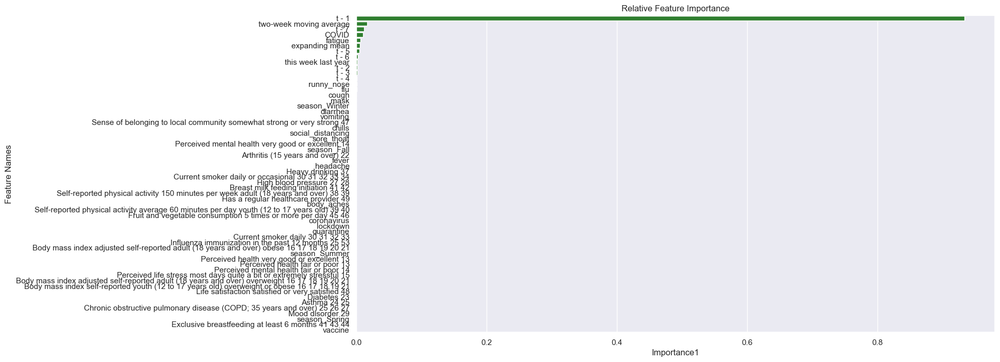

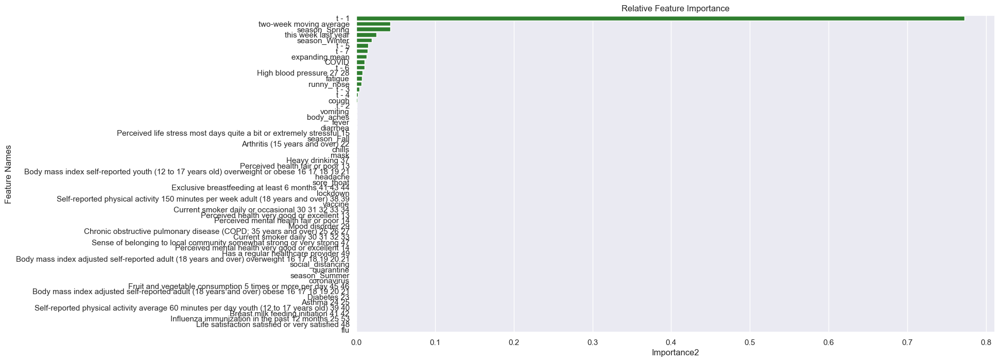

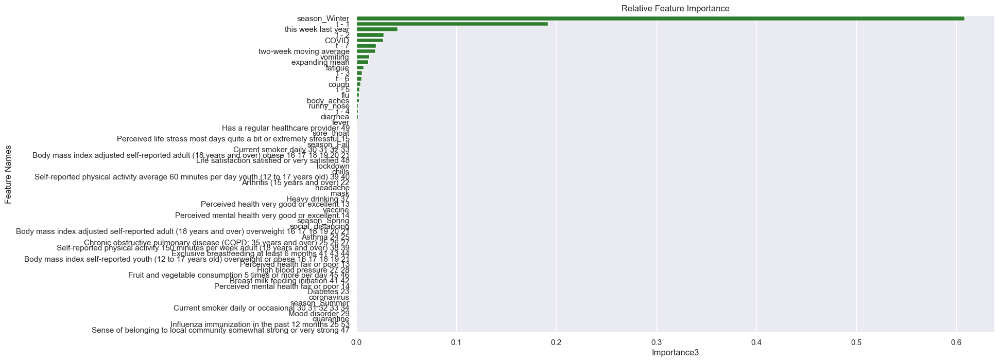

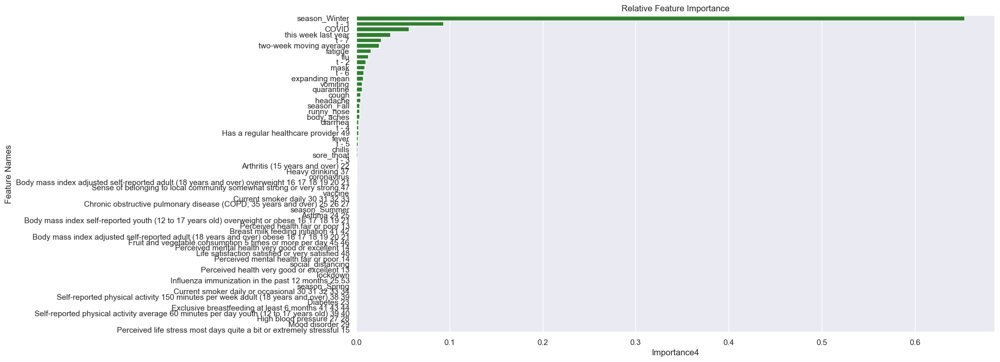

In [137]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [138]:
feature_to_drop

'Influenza immunization in the past 12 months 25 53'

In [139]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

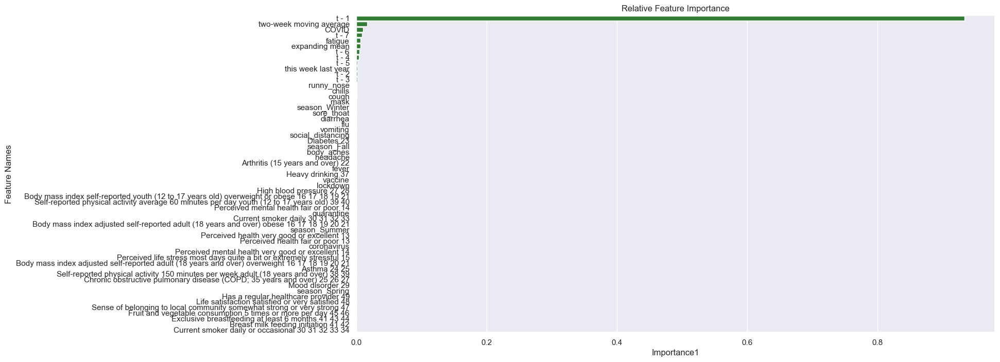

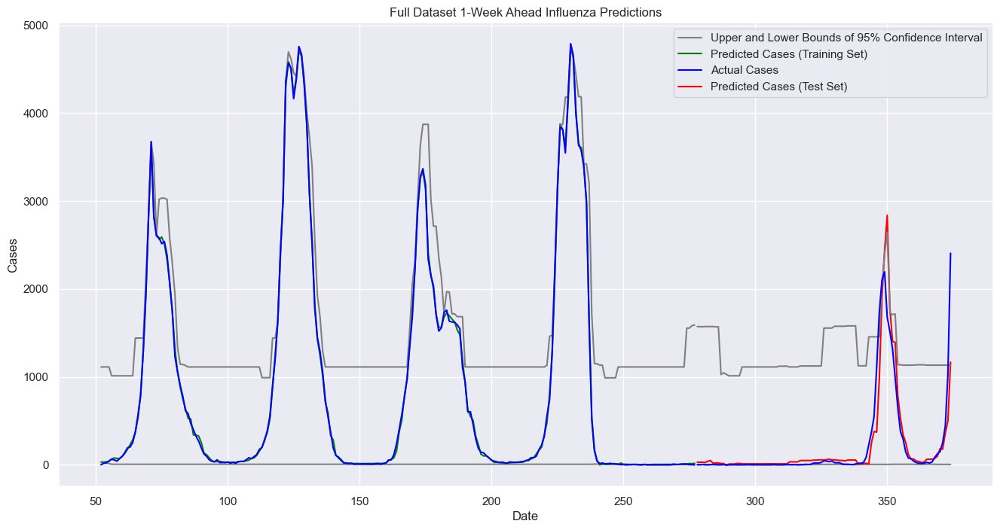

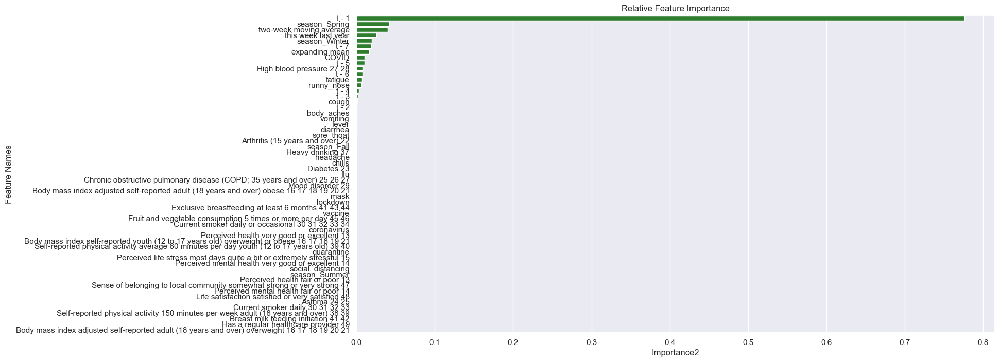

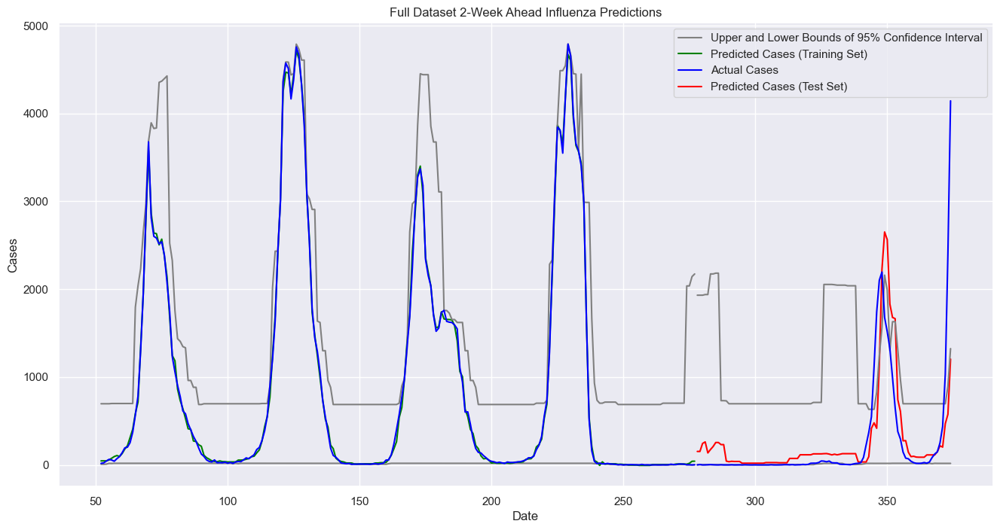

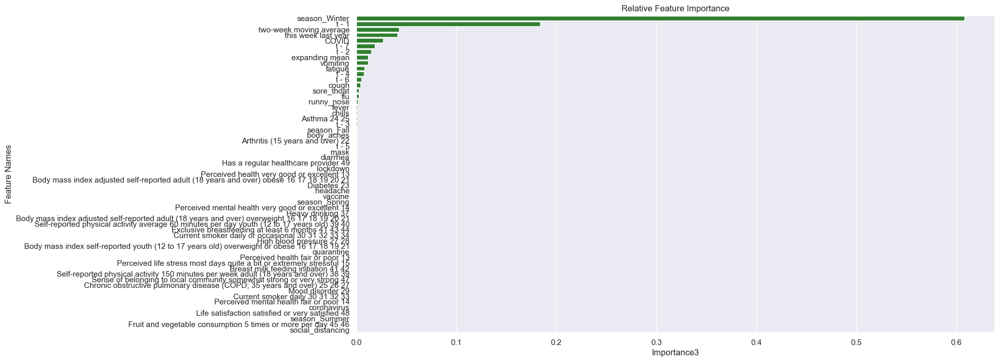

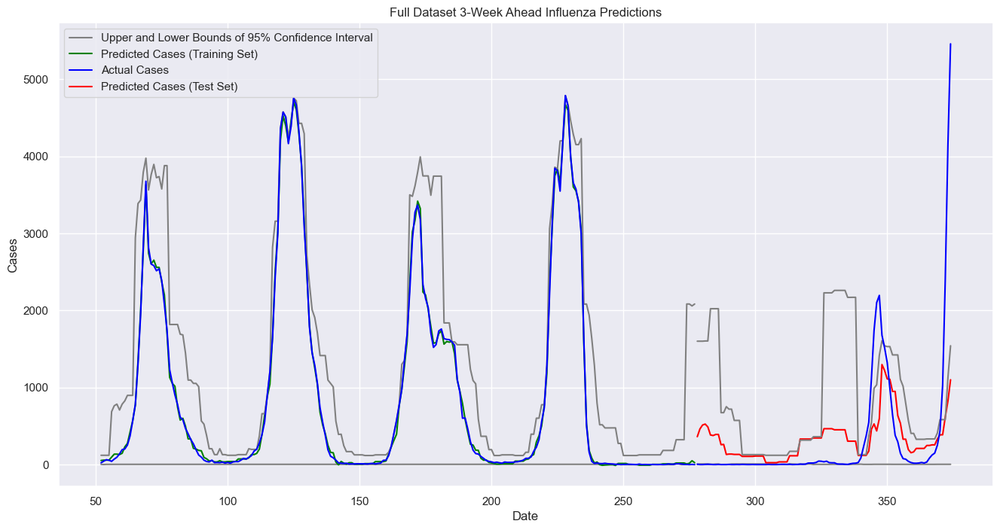

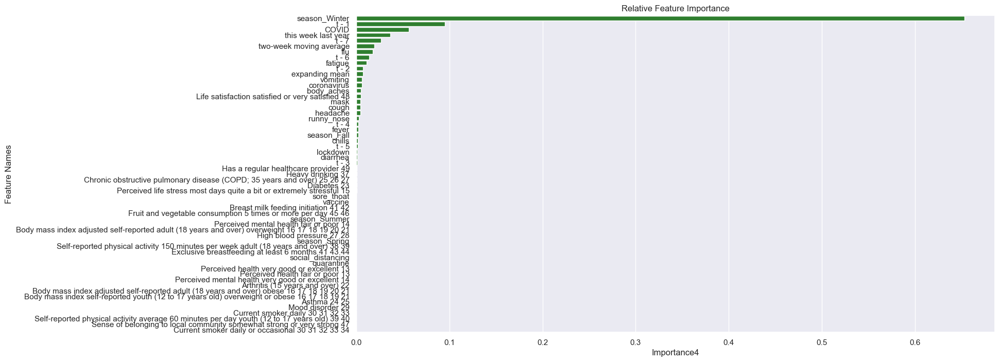

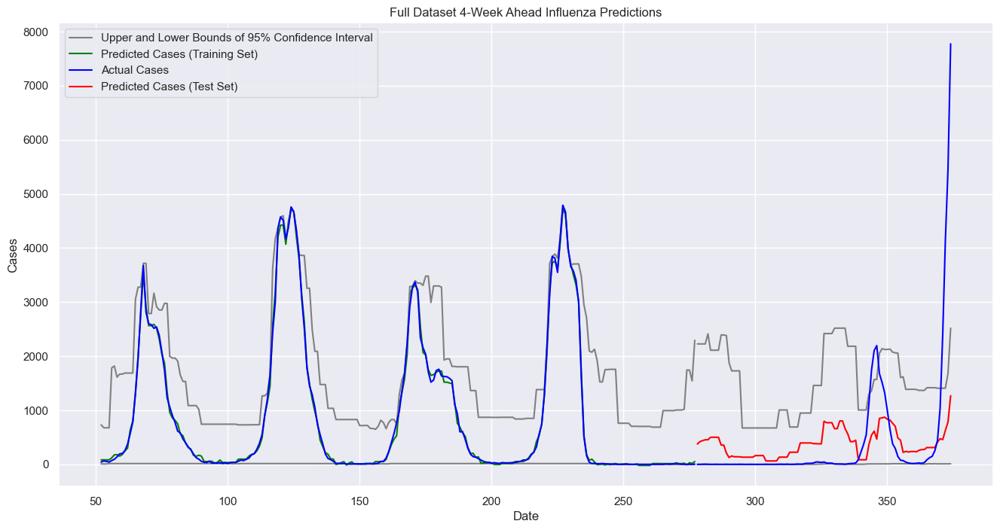

In [140]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [141]:
feature_to_drop

'Current smoker daily 30 31 32 33'

In [142]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

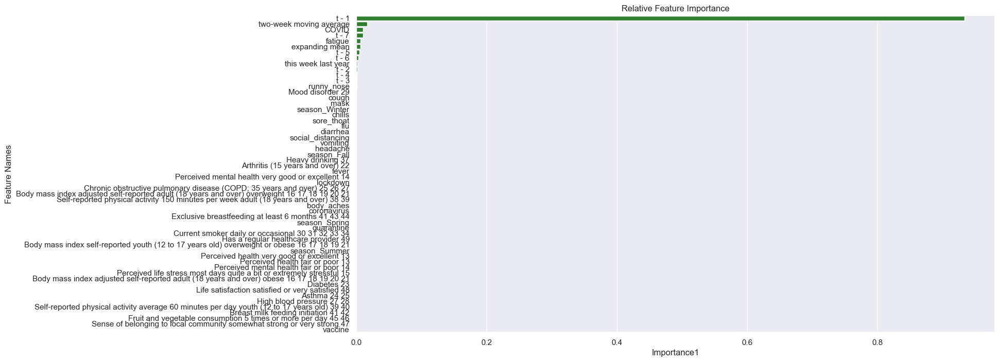

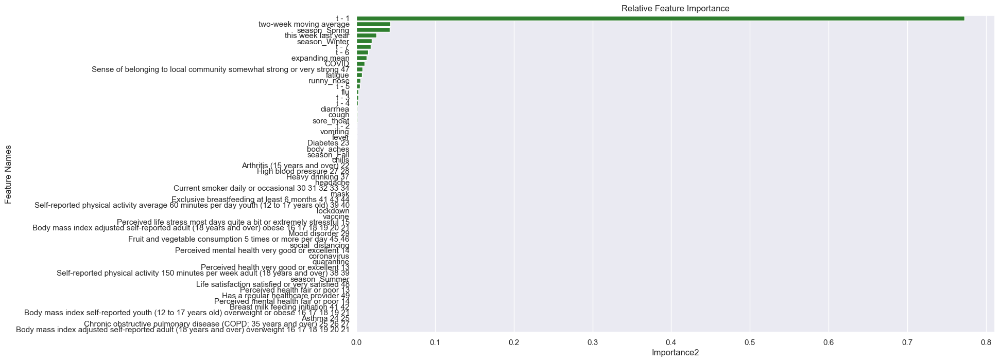

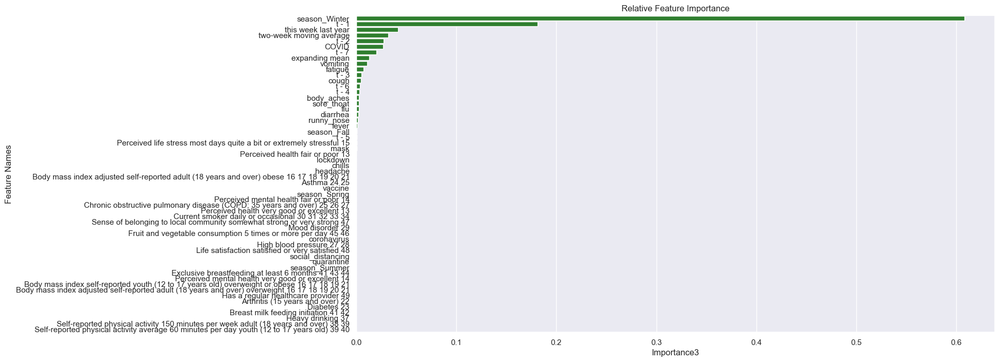

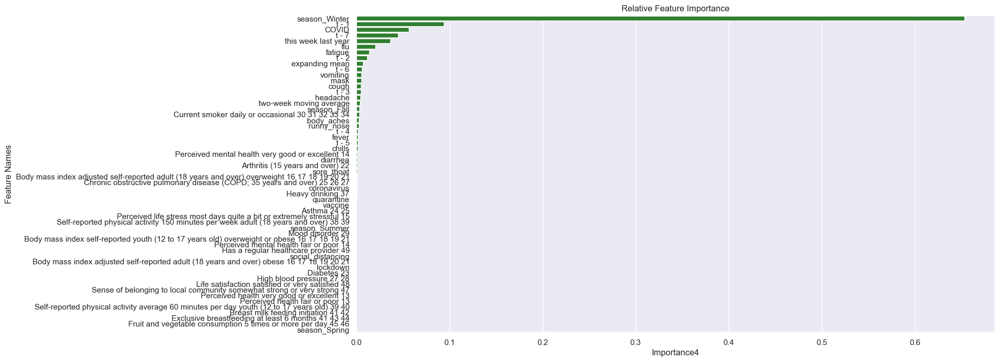

In [143]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [144]:
feature_to_drop

'Breast milk feeding initiation 41 42'

In [145]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [146]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [147]:
feature_to_drop

'Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21'

In [148]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [149]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [150]:
feature_to_drop

'Has a regular healthcare provider 49'

In [151]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [152]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [153]:
feature_to_drop

'Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39'

In [154]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,4176.36,992165.07,64.62,996.07,44.55,443.64,0.997614,0.212445
0,Gradient Boost,Full Dataset,1,942.15,52706.65,30.69,229.58,20.96,89.74,0.999462,0.798027
0,Gradient Boost,Full Dataset,2,1706.79,219549.84,41.31,468.56,27.71,208.53,0.999025,0.474722
0,Gradient Boost,Full Dataset,3,2398.12,436536.29,48.97,660.71,34.01,304.62,0.99863,0.370379


In [155]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [156]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [157]:
feature_to_drop

'Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40'

In [158]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39','Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39','Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [159]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [160]:
feature_to_drop

'Perceived mental health fair or poor 14'

In [161]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,4176.36,1011924.27,64.62,1005.94,44.55,501.35,0.997614,0.196761
0,Gradient Boost,Full Dataset,1,942.15,51925.58,30.69,227.87,20.96,92.02,0.999462,0.80102
0,Gradient Boost,Full Dataset,2,1706.79,217948.39,41.31,466.85,27.71,205.99,0.999025,0.478554
0,Gradient Boost,Full Dataset,3,2398.12,477535.81,48.97,691.04,34.01,365.43,0.99863,0.311245


In [162]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39','Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40','Perceived mental health fair or poor 14'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39','Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40','Perceived mental health fair or poor 14'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [163]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [164]:
feature_to_drop

'Perceived health fair or poor 13'

In [165]:
df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','index','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39','Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40','Perceived mental health fair or poor 14','Perceived health fair or poor 13'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','Influenza immunization in the past 12 months 25 53','Current smoker daily 30 31 32 33','Breast milk feeding initiation 41 42','Body mass index adjusted self-reported adult (18 years and over) obese 16 17 18 19 20 21','Has a regular healthcare provider 49','Self-reported physical activity 150 minutes per week adult (18 years and over) 38 39','Self-reported physical activity average 60 minutes per day youth (12 to 17 years old) 39 40','Perceived mental health fair or poor 14','Perceived health fair or poor 13'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [166]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [167]:
feature_to_drop

'Life satisfaction satisfied or very satisfied 48'

In [168]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [169]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [170]:
feature_to_drop

'season_Summer'

In [171]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,4176.36,1025695.48,64.62,1012.77,44.55,516.64,0.997614,0.185829
0,Gradient Boost,Full Dataset,1,996.66,52249.76,31.57,228.58,21.61,91.49,0.999431,0.799778
0,Gradient Boost,Full Dataset,2,1888.39,237048.34,43.46,486.88,28.96,214.87,0.998921,0.432857
0,Gradient Boost,Full Dataset,3,2375.2,456676.46,48.74,675.78,33.78,312.17,0.998643,0.341331


In [172]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [173]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [174]:
feature_to_drop

'vaccine'

In [175]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,4542.1,999524.47,67.4,999.76,44.24,447.16,0.997405,0.206603
0,Gradient Boost,Full Dataset,1,1050.46,52845.02,32.41,229.88,22.2,95.56,0.9994,0.797497
0,Gradient Boost,Full Dataset,2,1753.18,231830.32,41.87,481.49,27.88,215.31,0.998998,0.445341
0,Gradient Boost,Full Dataset,3,1723.52,447426.76,41.52,668.9,28.65,316.88,0.999015,0.354672


In [176]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [177]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [178]:
feature_to_drop

'quarantine'

In [179]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [180]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [181]:
feature_to_drop

'social_distancing'

In [182]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3519.14,949201.23,59.32,974.27,39.52,574.15,0.99799,0.246549
0,Gradient Boost,Full Dataset,1,1050.46,56989.66,32.41,238.73,22.2,95.1,0.9994,0.781614
0,Gradient Boost,Full Dataset,2,1753.18,235080.7,41.87,484.85,27.88,226.61,0.998998,0.437565
0,Gradient Boost,Full Dataset,3,1723.52,432687.16,41.52,657.79,28.65,313.08,0.999015,0.375931


In [183]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

In [184]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # # Plot
    # plt.figure()
    # plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    # plt.plot(predictions_test['lower'], color='grey')
    # plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # plt.plot(predictions_test['upper'], color='grey')
    # plt.plot(predictions_test['actual'], color='blue')
    # # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    # plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    # plt.xlabel('Date')
    # plt.ylabel('Cases')
    # plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [185]:
feature_to_drop

'coronavirus'

In [186]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3519.14,947778.07,59.32,973.54,39.52,571.35,0.99799,0.247678
0,Gradient Boost,Full Dataset,1,963.97,53913.65,31.05,232.19,21.13,106.87,0.999449,0.793402
0,Gradient Boost,Full Dataset,2,1784.23,233869.54,42.24,483.6,27.79,219.2,0.998981,0.440462
0,Gradient Boost,Full Dataset,3,1723.52,455833.18,41.52,675.15,28.65,325.11,0.999015,0.342547


In [ ]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

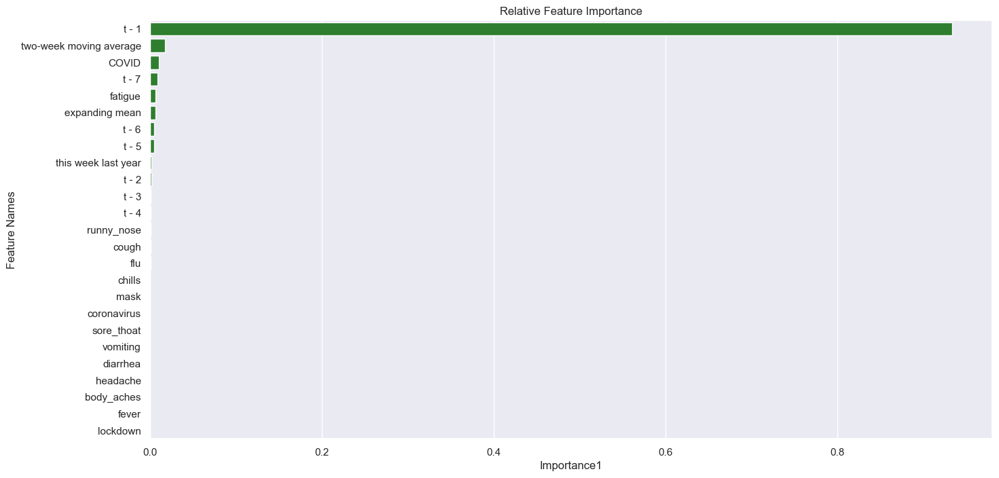

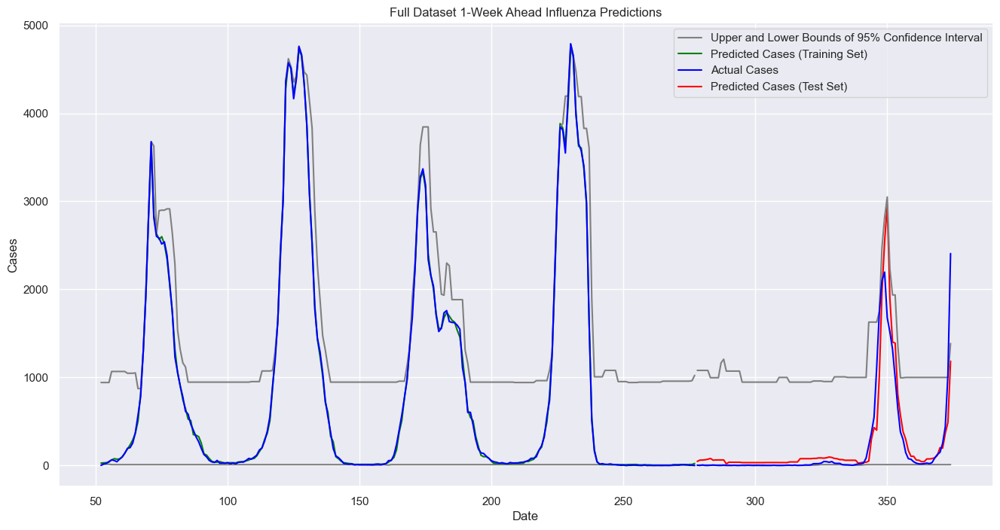

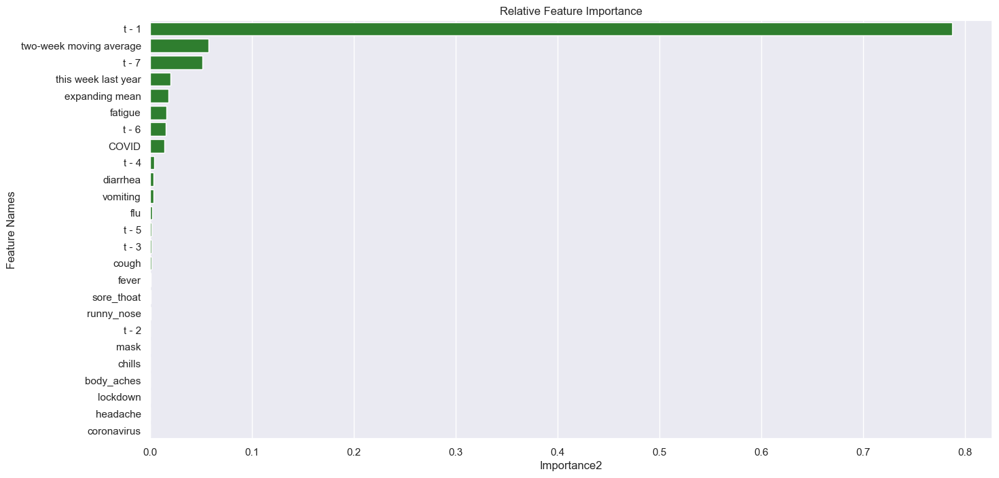

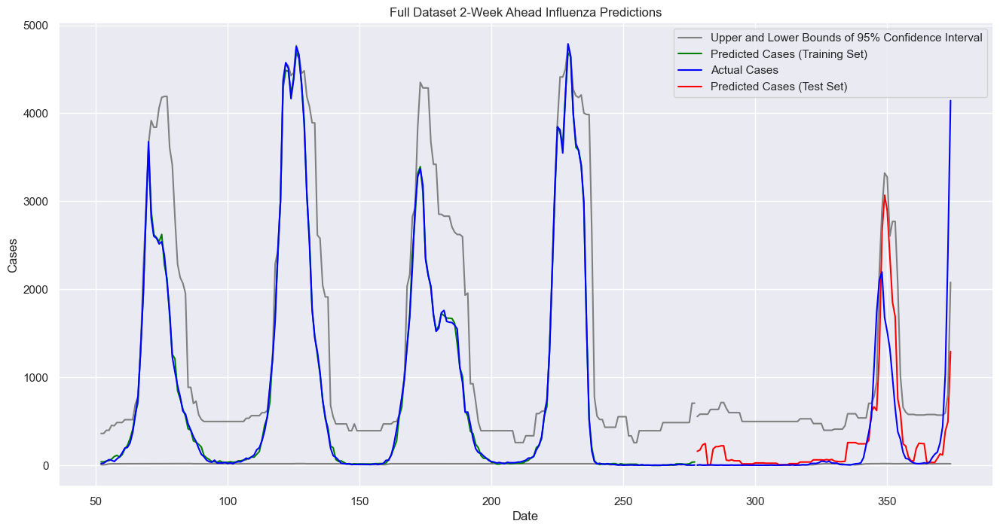

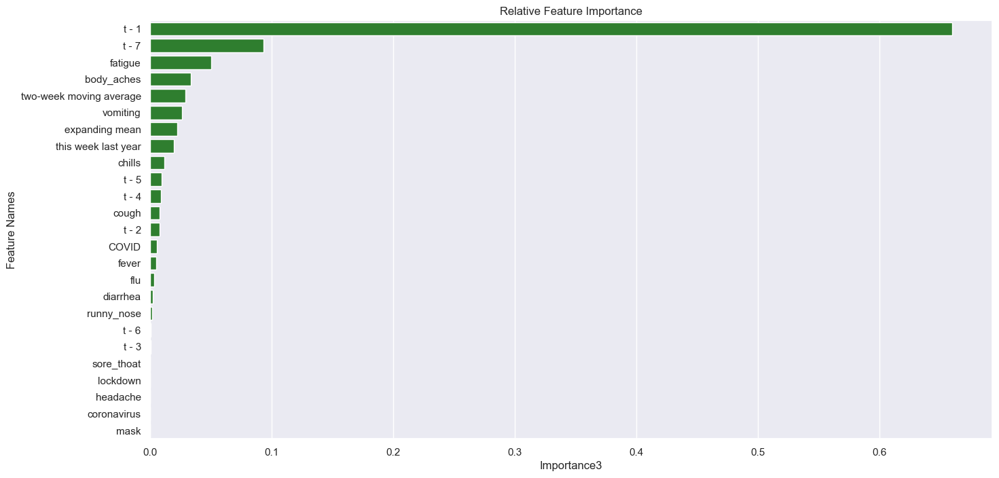

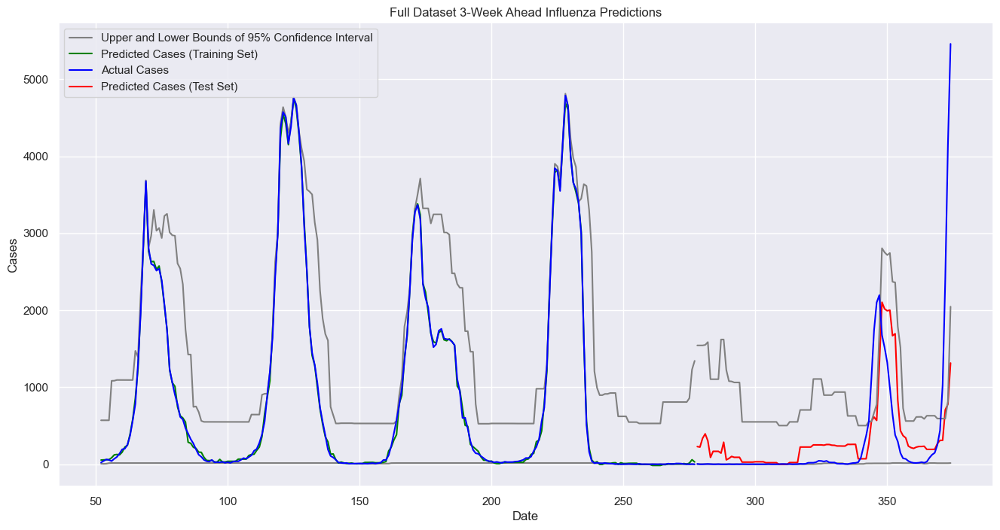

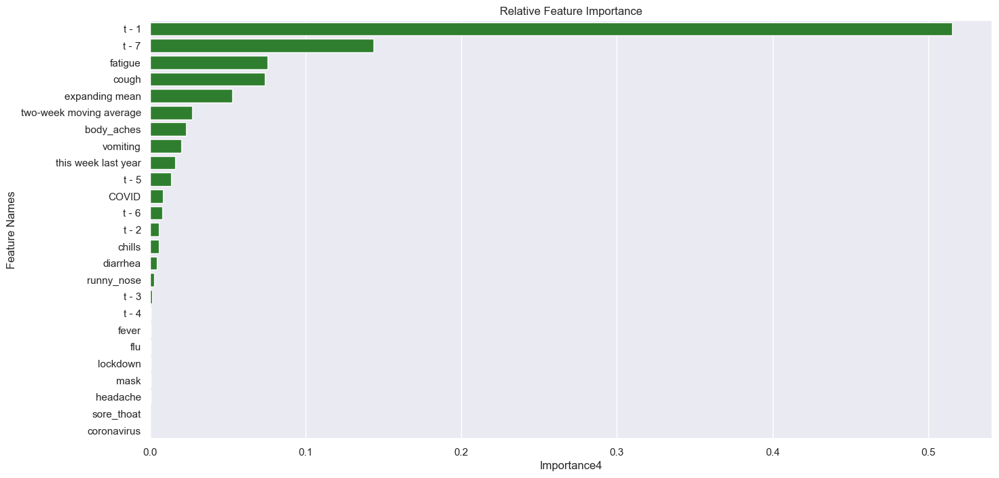

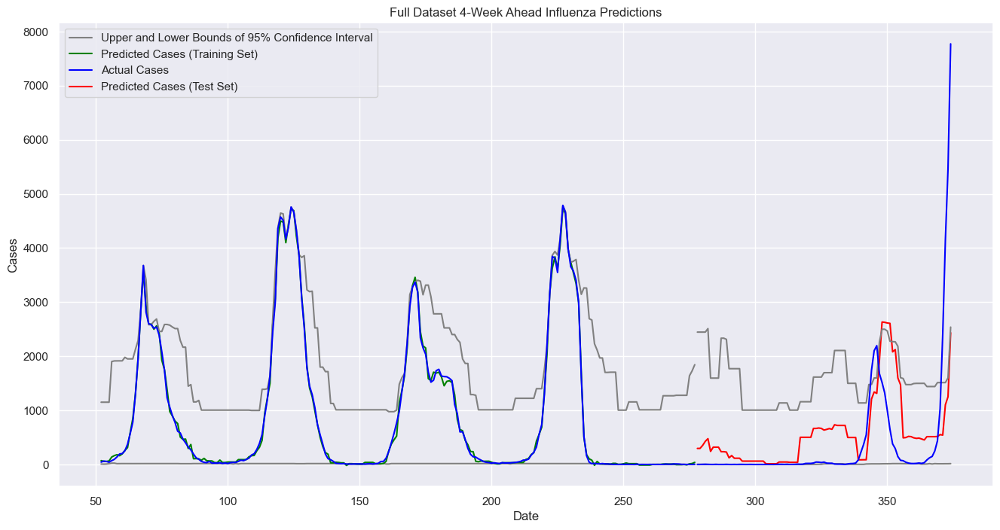

In [187]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [188]:
feature_to_drop

'coronavirus'

In [189]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3519.14,956589.8,59.32,978.05,39.52,567.7,0.99799,0.240684
0,Gradient Boost,Full Dataset,1,963.97,53913.65,31.05,232.19,21.13,106.87,0.999449,0.793402
0,Gradient Boost,Full Dataset,2,1784.23,233869.54,42.24,483.6,27.79,219.2,0.998981,0.440462
0,Gradient Boost,Full Dataset,3,1723.52,455833.18,41.52,675.15,28.65,325.11,0.999015,0.342547


In [190]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

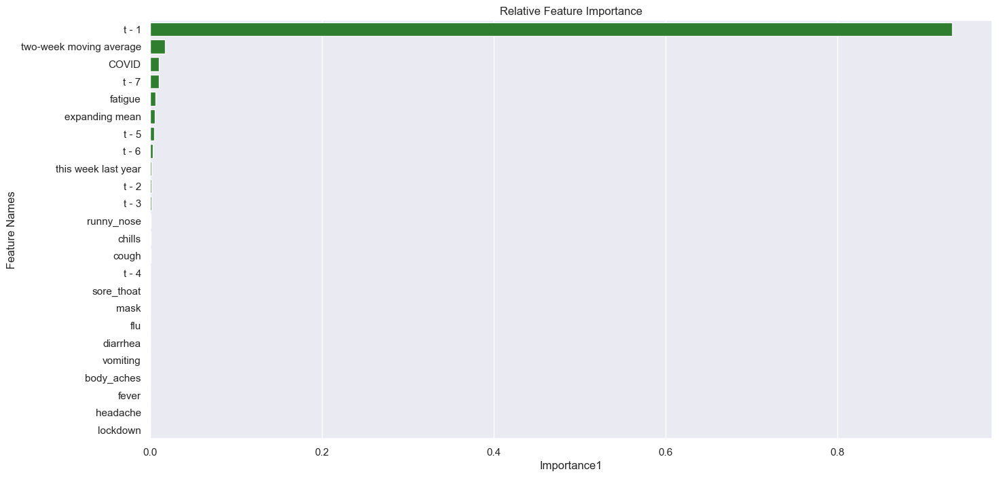

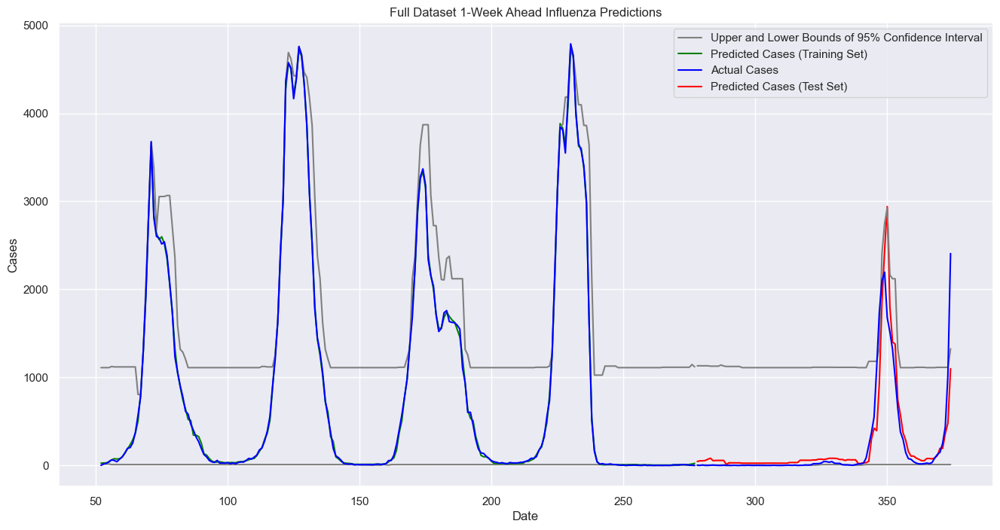

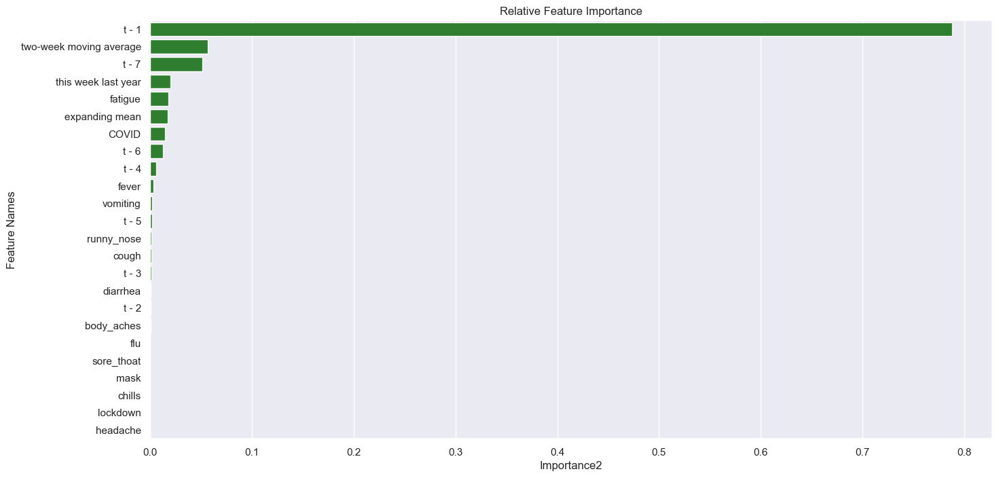

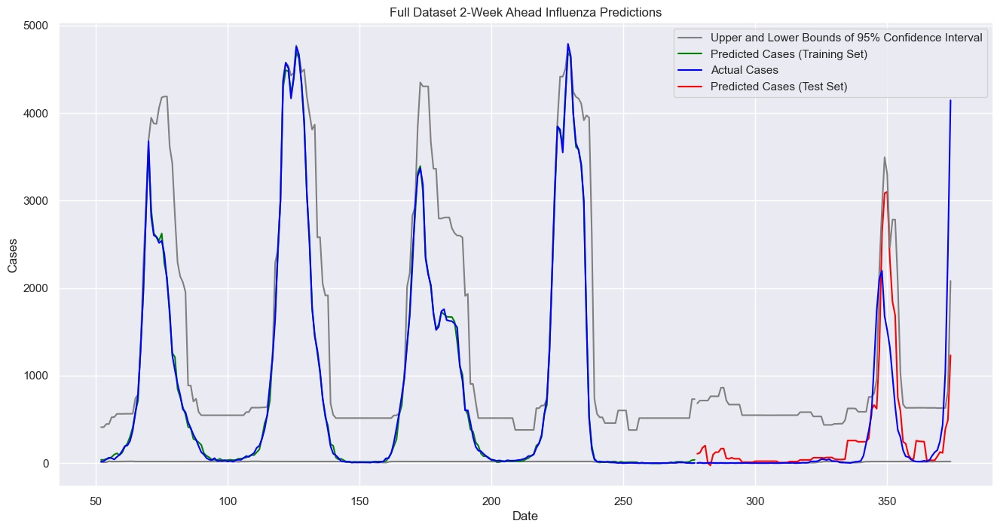

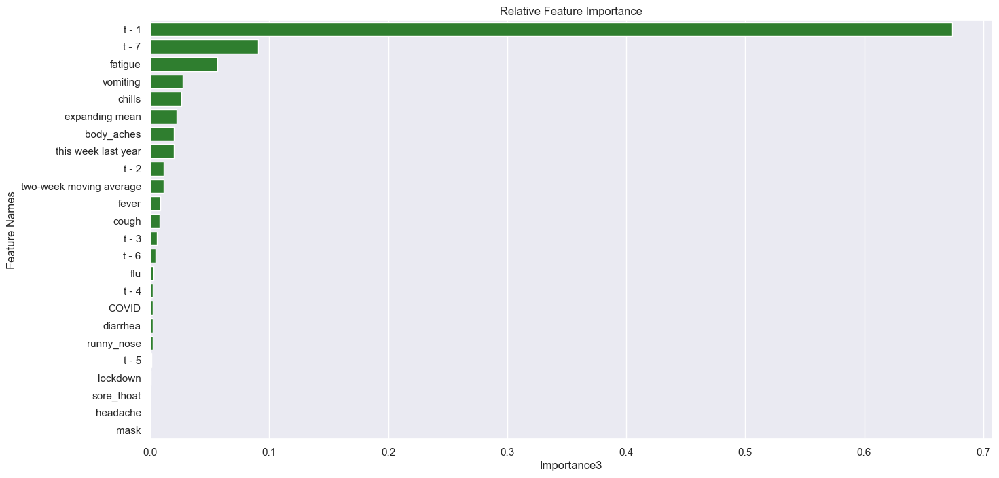

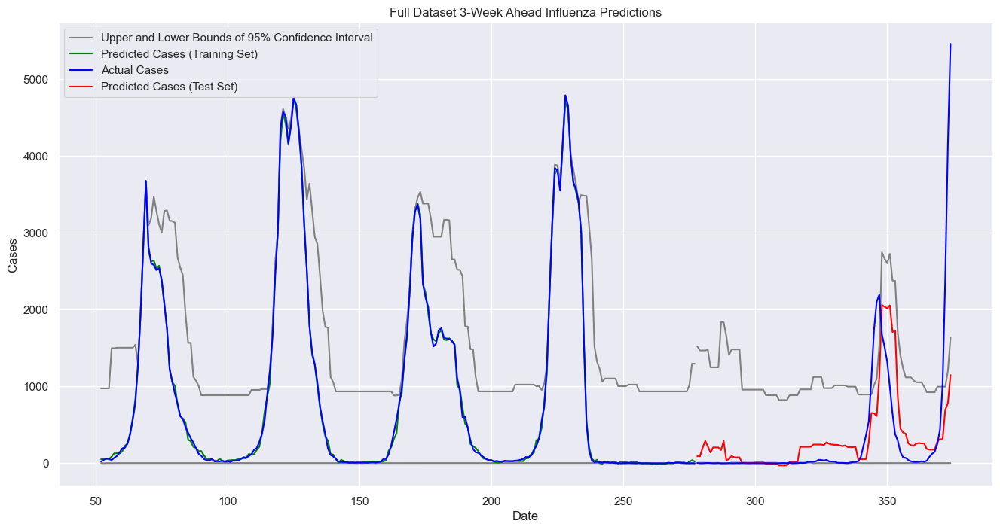

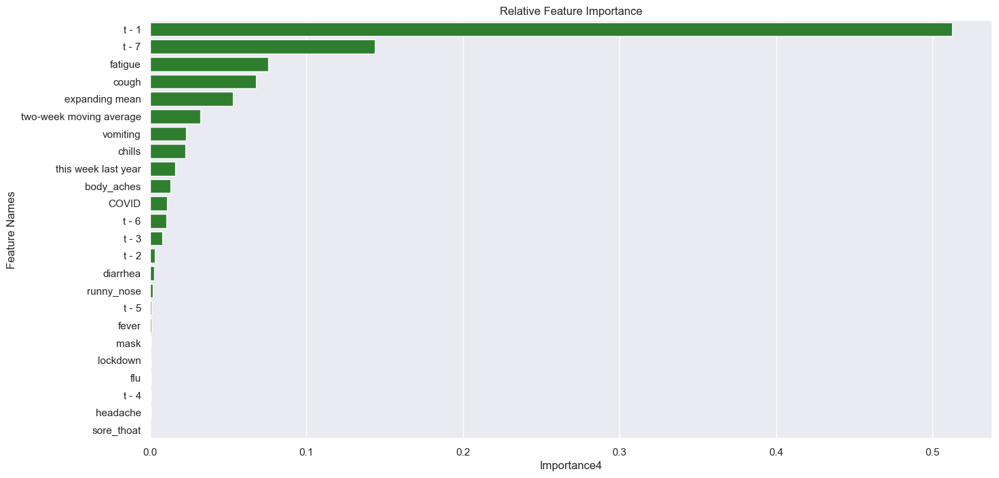

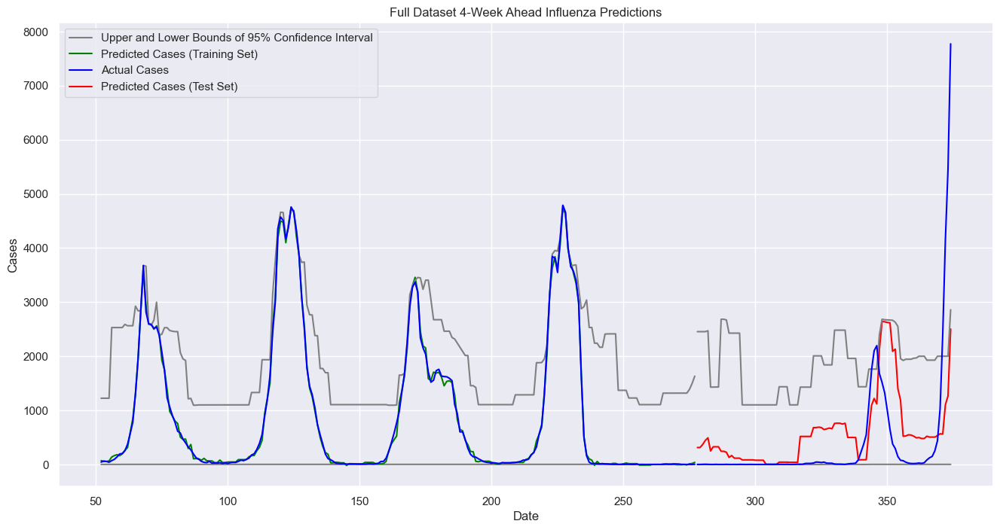

In [191]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [192]:
feature_to_drop

'headache'

In [193]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3519.14,956589.8,59.32,978.05,39.52,567.7,0.99799,0.240684
0,Gradient Boost,Full Dataset,1,995.53,55781.6,31.55,236.18,21.31,102.88,0.999431,0.786244
0,Gradient Boost,Full Dataset,2,1784.23,240912.53,42.24,490.83,27.79,216.2,0.998981,0.423612
0,Gradient Boost,Full Dataset,3,1838.25,471859.97,42.87,686.92,28.86,320.87,0.99895,0.319432


In [194]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

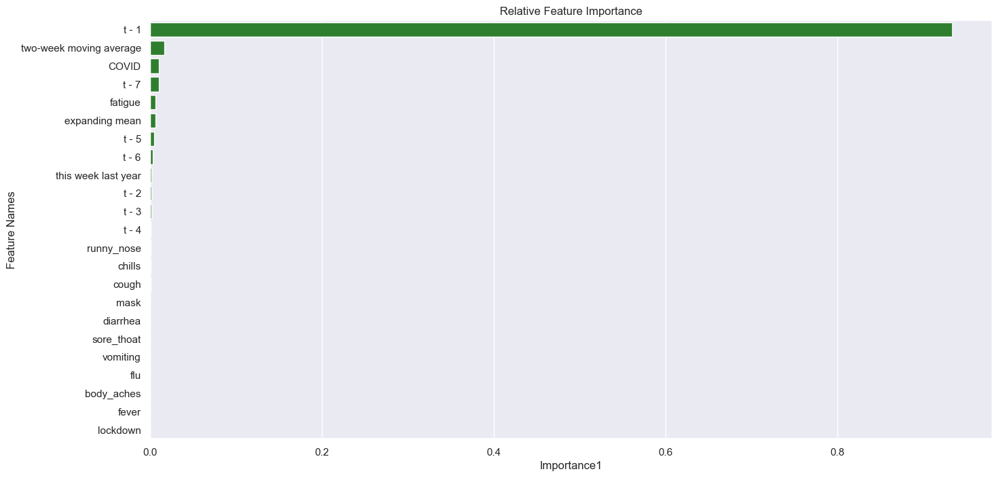

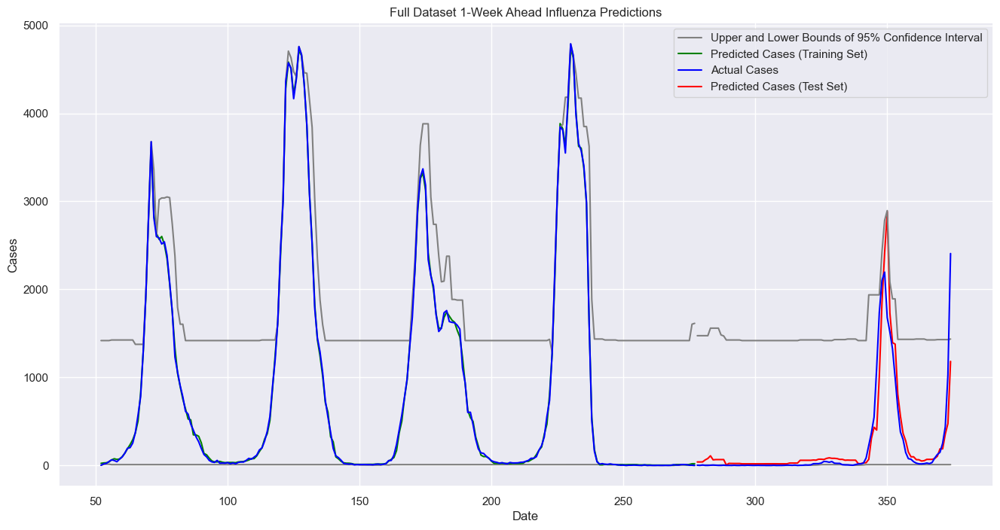

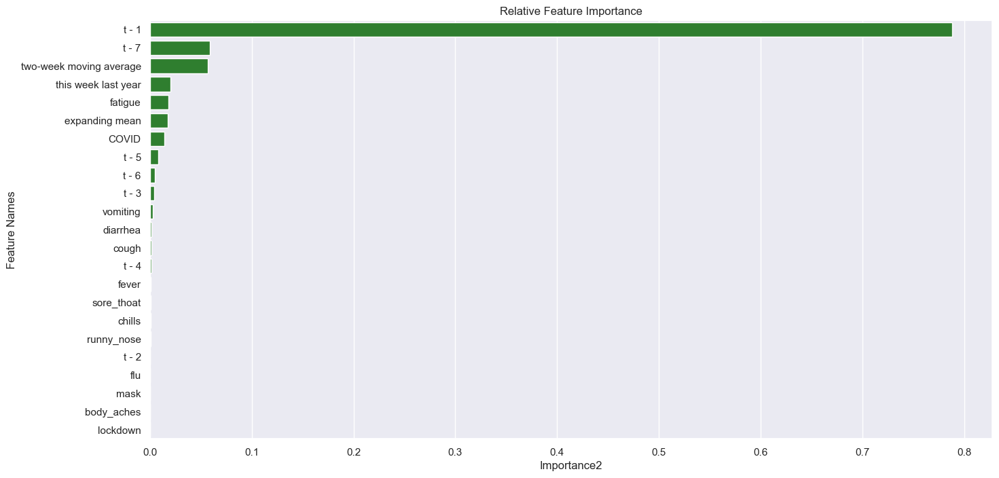

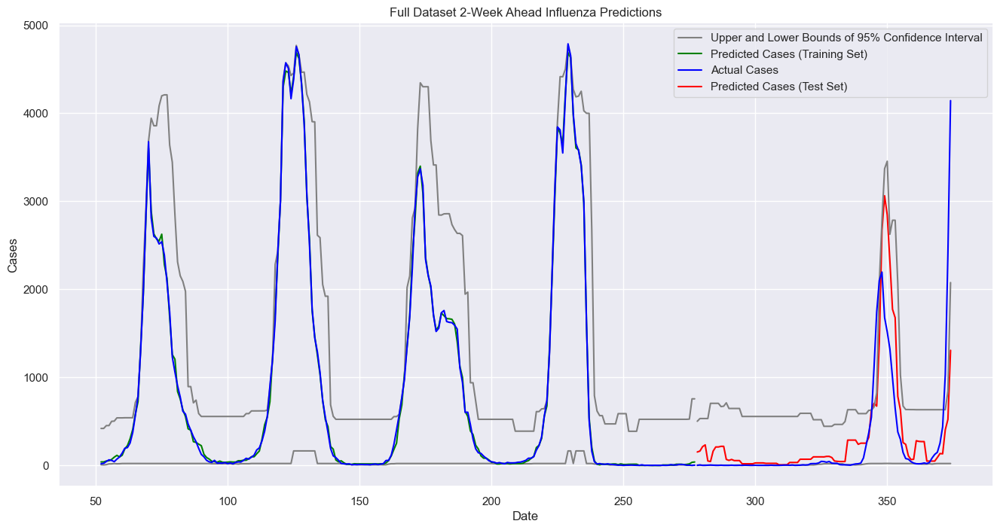

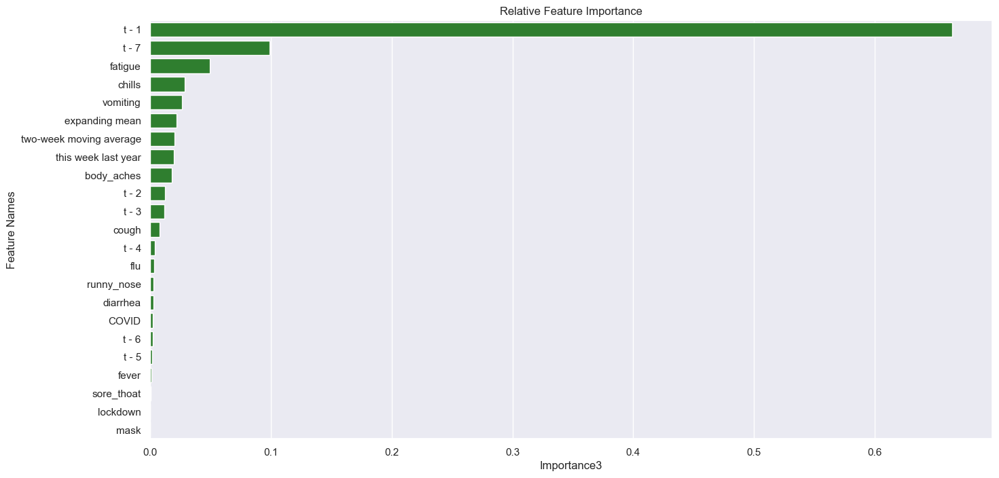

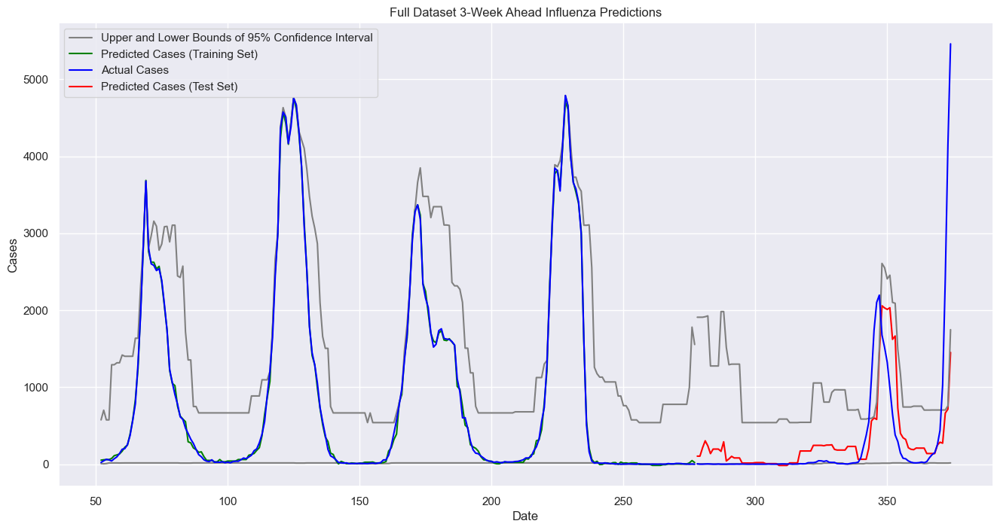

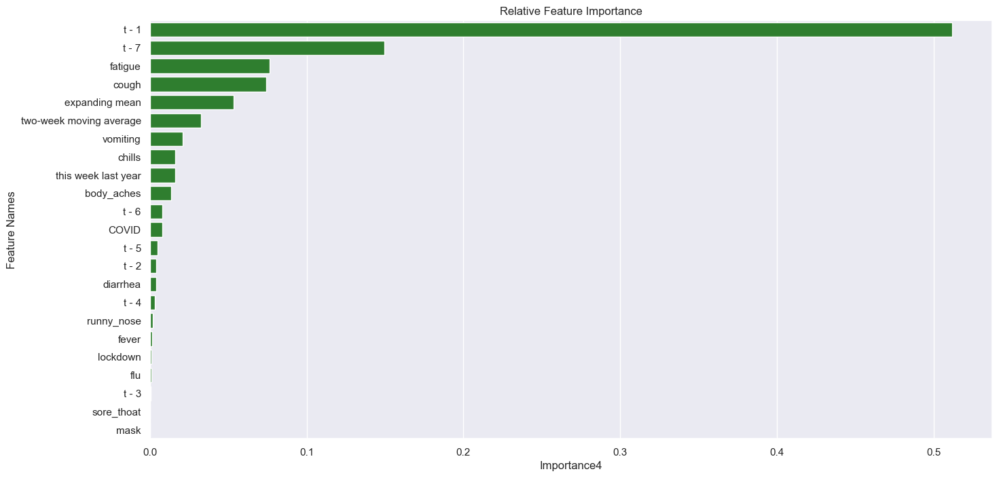

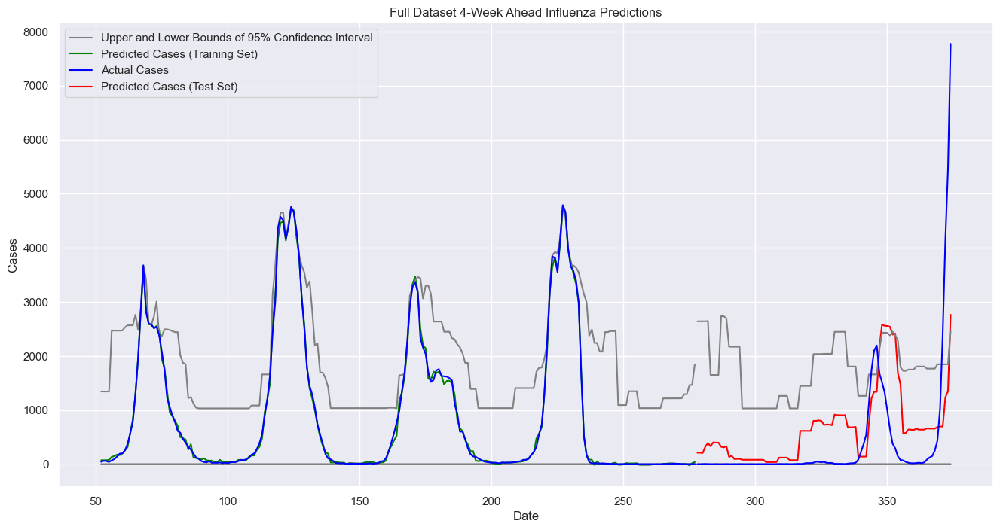

In [195]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [196]:
feature_to_drop

'mask'

In [197]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3519.14,952645.45,59.32,976.04,39.52,577.13,0.99799,0.243815
0,Gradient Boost,Full Dataset,1,1052.85,50161.89,32.45,223.97,22.0,97.25,0.999398,0.807779
0,Gradient Boost,Full Dataset,2,1752.08,226156.23,41.86,475.56,27.88,224.76,0.998999,0.458916
0,Gradient Boost,Full Dataset,3,1750.7,440380.65,41.84,663.61,28.6,305.43,0.999,0.364835


In [198]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

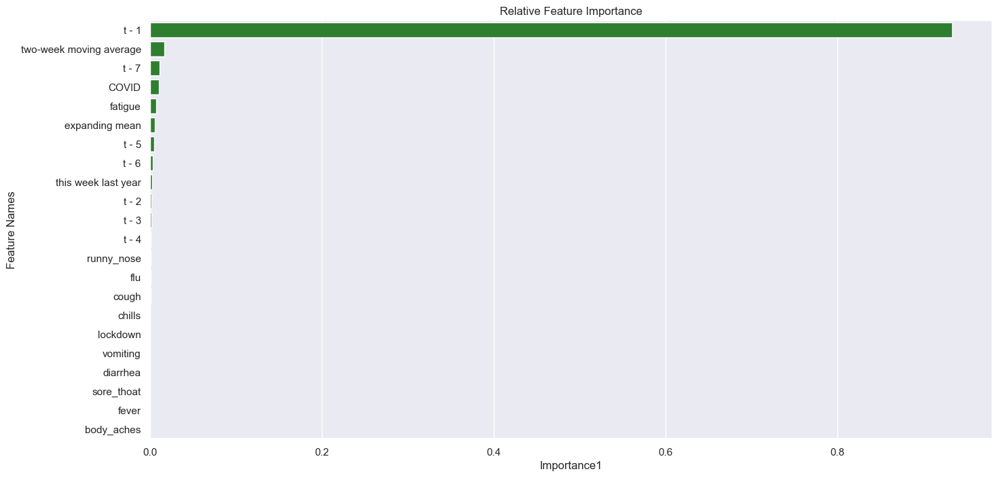

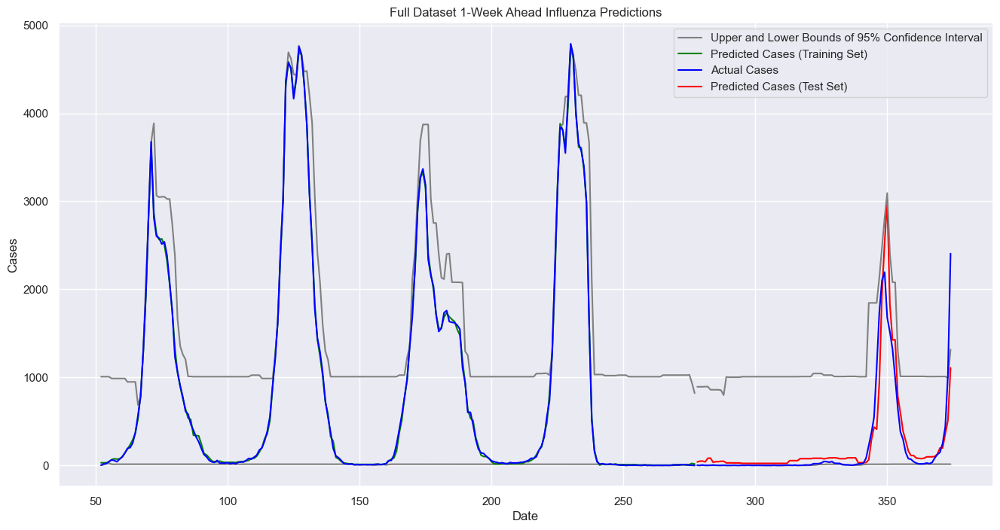

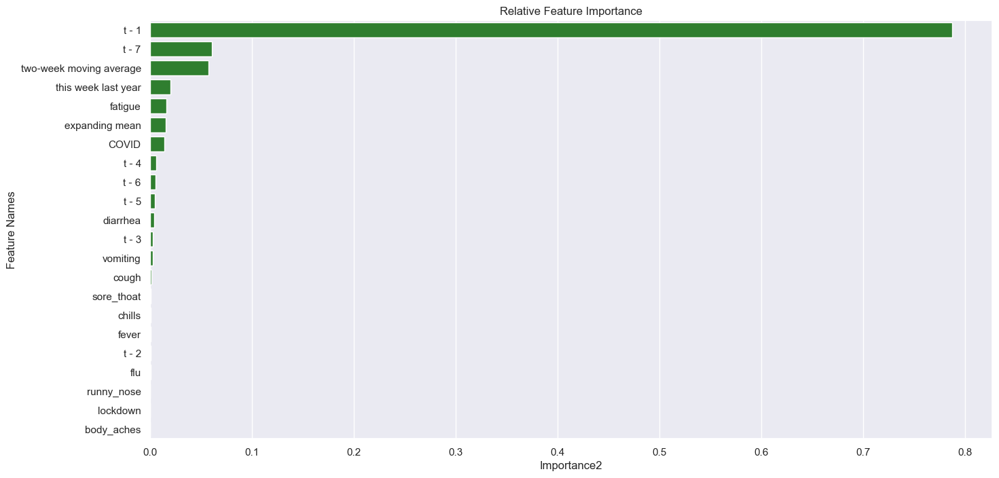

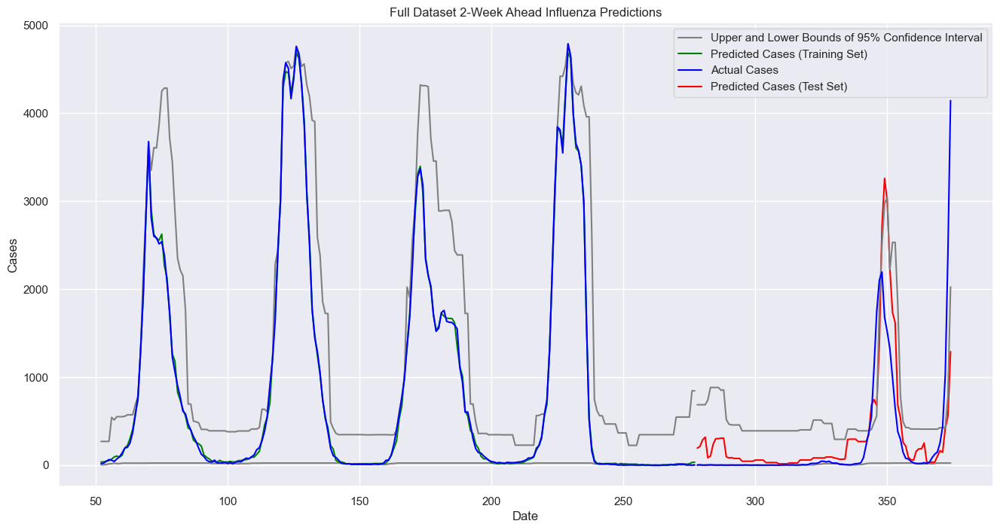

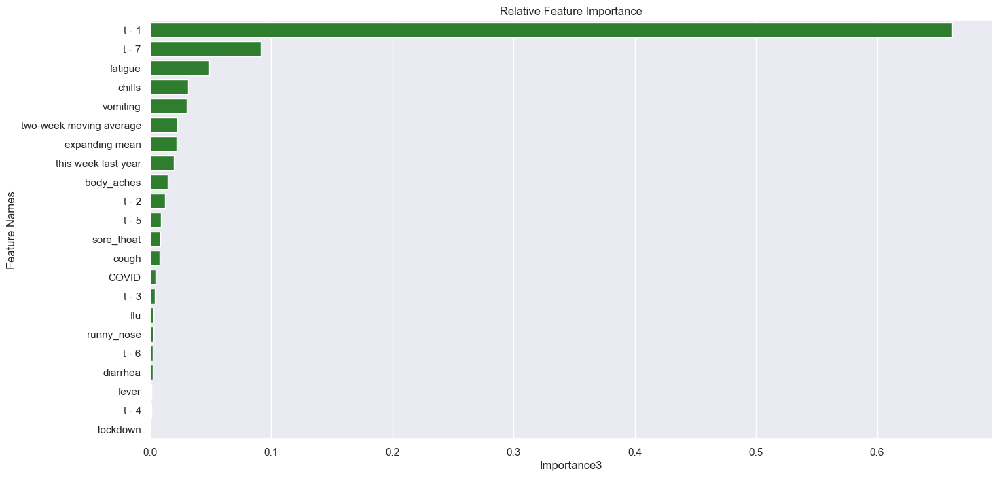

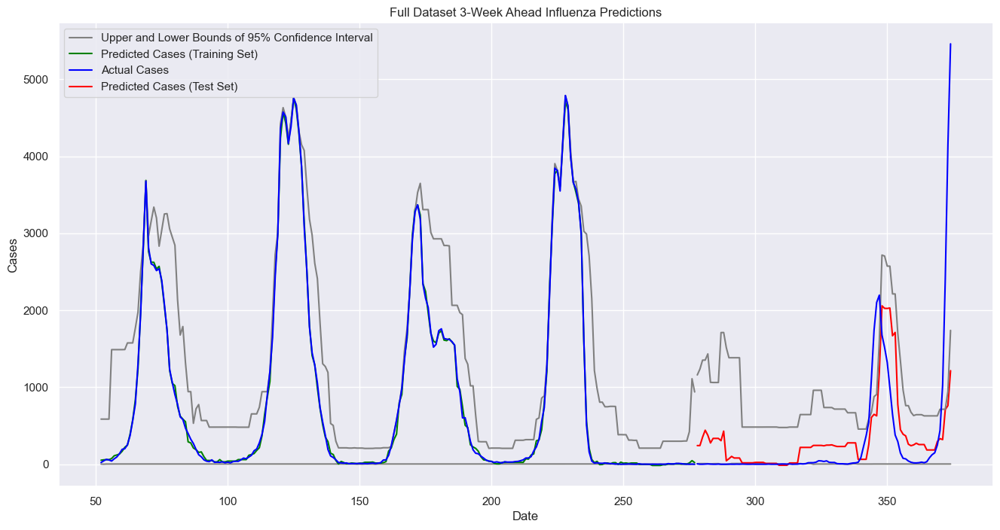

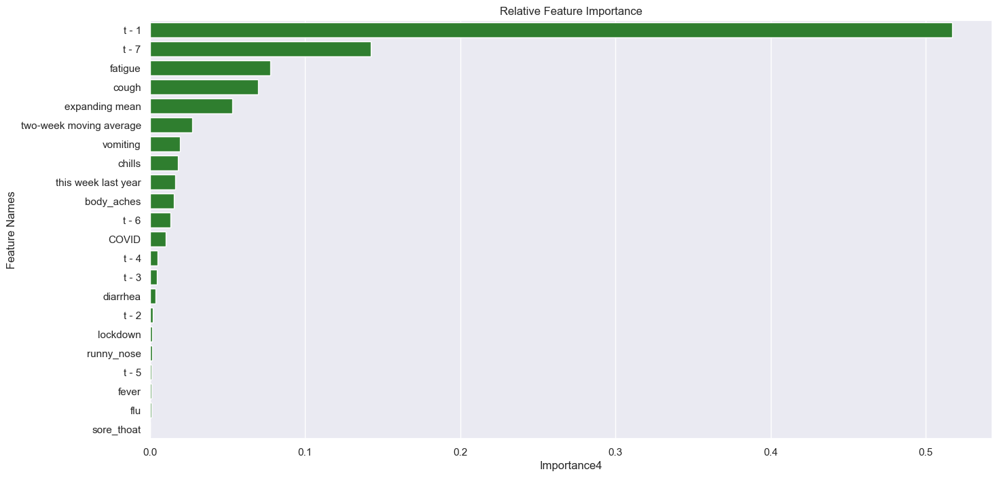

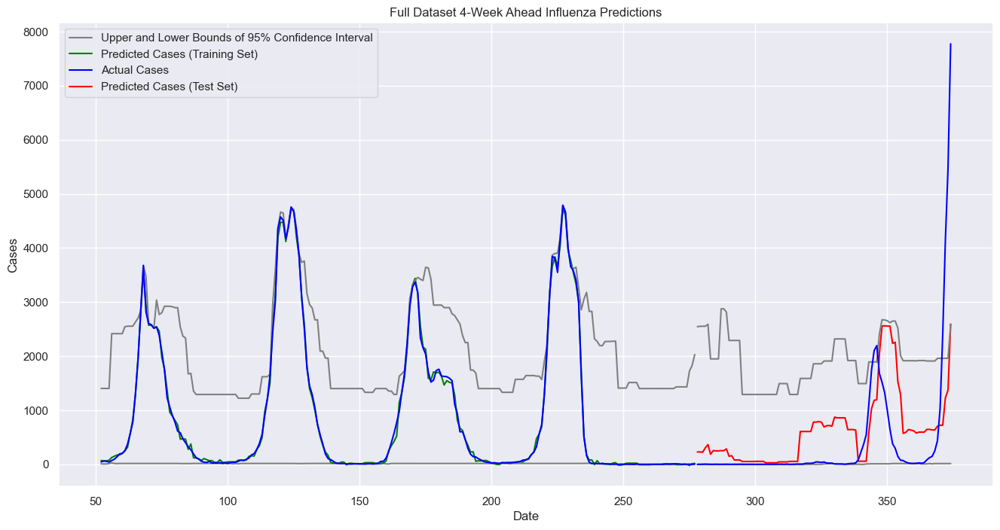

In [199]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [200]:
feature_to_drop

'lockdown'

In [201]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3789.54,980027.93,61.56,989.96,41.28,623.8,0.997835,0.222079
0,Gradient Boost,Full Dataset,1,1035.62,58052.97,32.18,240.94,22.27,109.16,0.999408,0.77754
0,Gradient Boost,Full Dataset,2,1855.67,234614.2,43.08,484.37,28.67,233.71,0.99894,0.438681
0,Gradient Boost,Full Dataset,3,1750.7,472108.3,41.84,687.1,28.6,338.26,0.999,0.319073


In [202]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

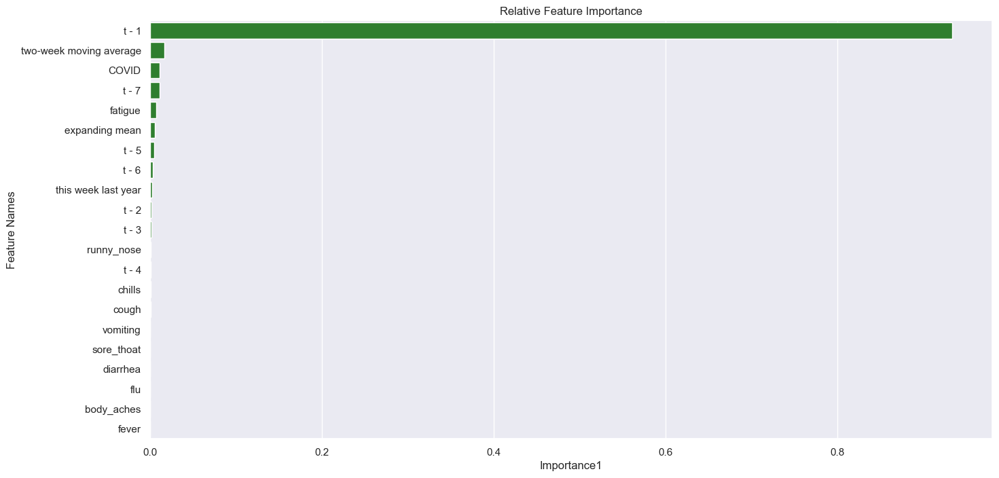

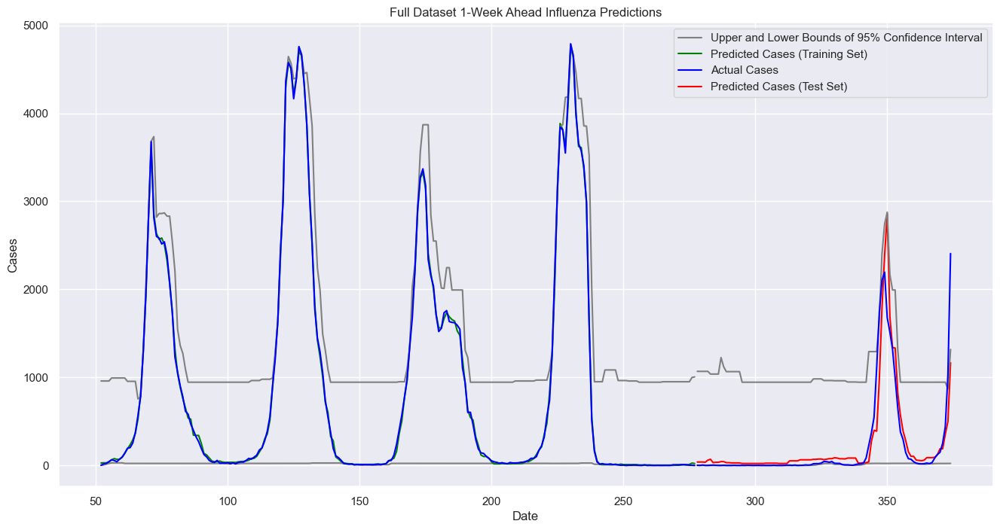

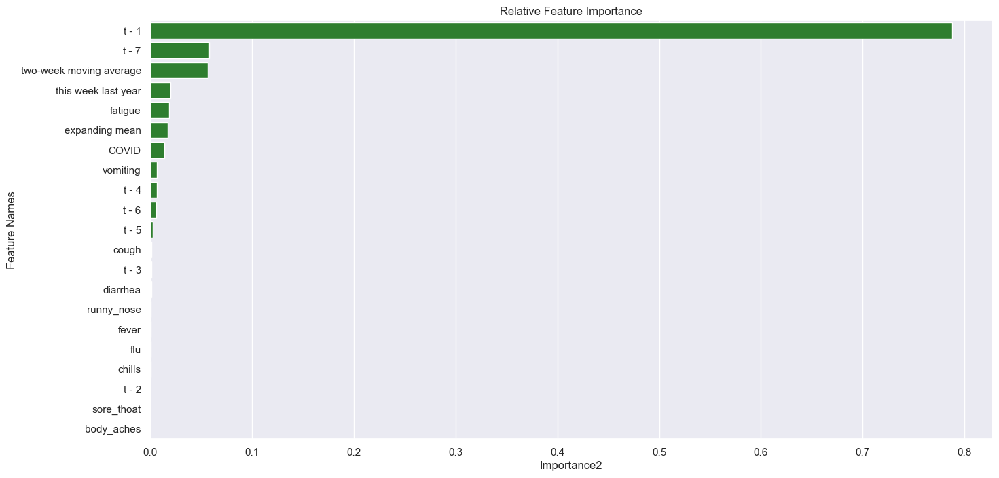

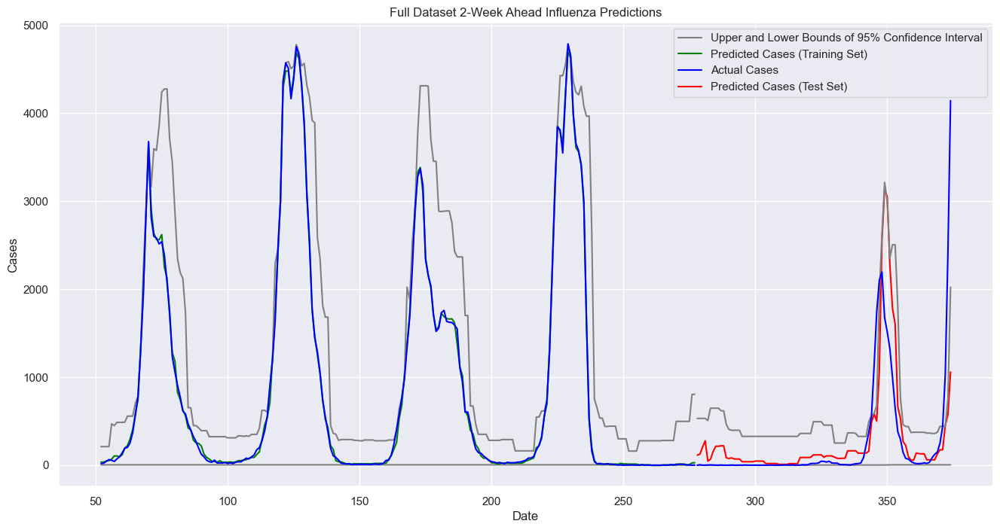

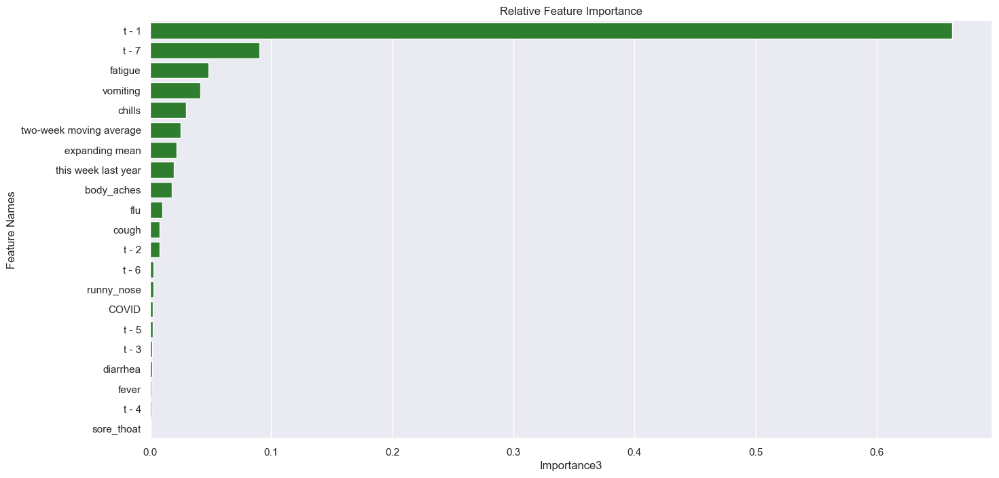

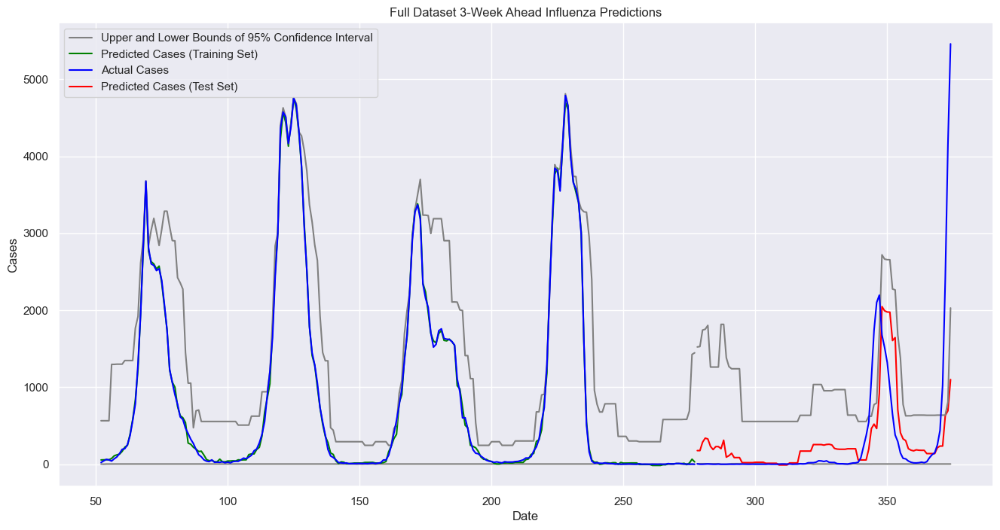

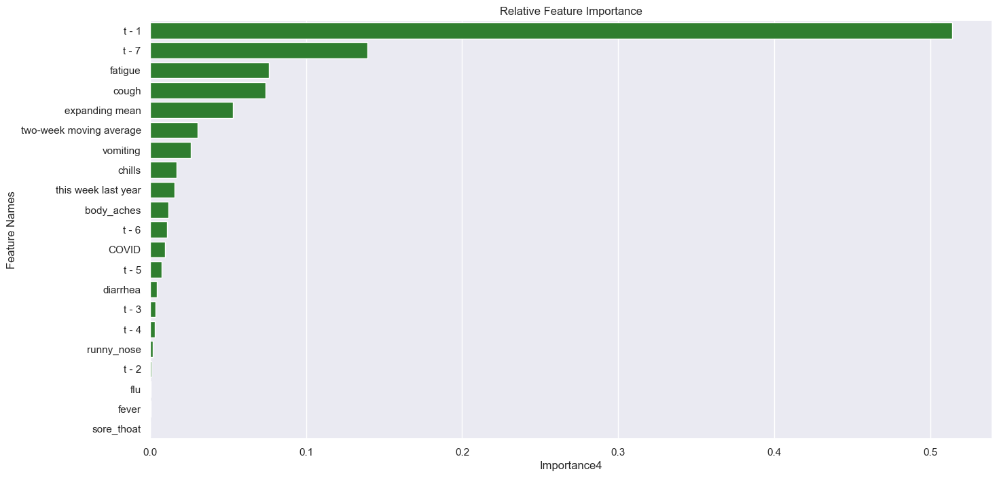

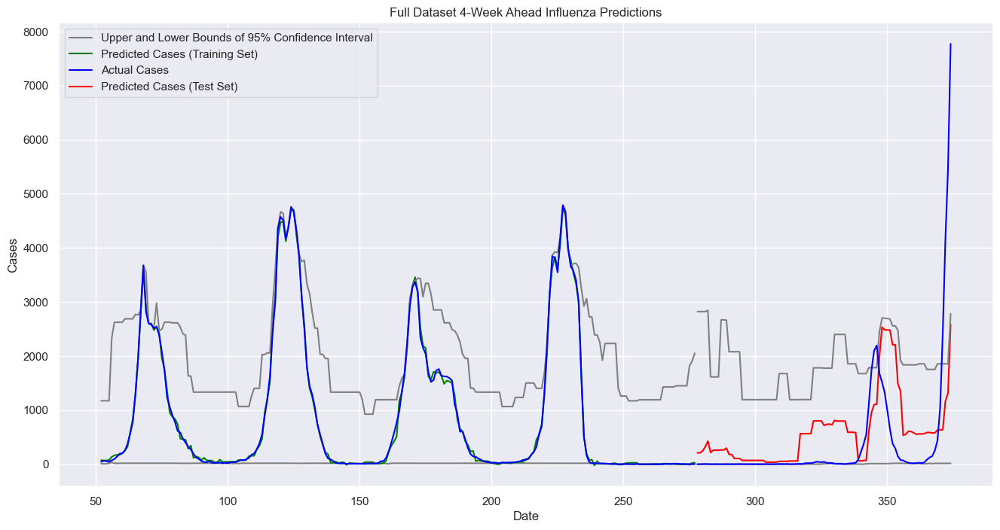

In [203]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [204]:
feature_to_drop

'sore_thoat'

In [205]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3678.22,963967.16,60.65,981.82,40.38,601.49,0.997899,0.234828
0,Gradient Boost,Full Dataset,1,1091.26,50760.7,33.03,225.3,22.94,100.55,0.999377,0.805484
0,Gradient Boost,Full Dataset,2,1781.5,248853.69,42.21,498.85,27.93,223.28,0.998982,0.404612
0,Gradient Boost,Full Dataset,3,1834.94,490934.66,42.84,700.67,29.59,323.72,0.998952,0.29192


In [206]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

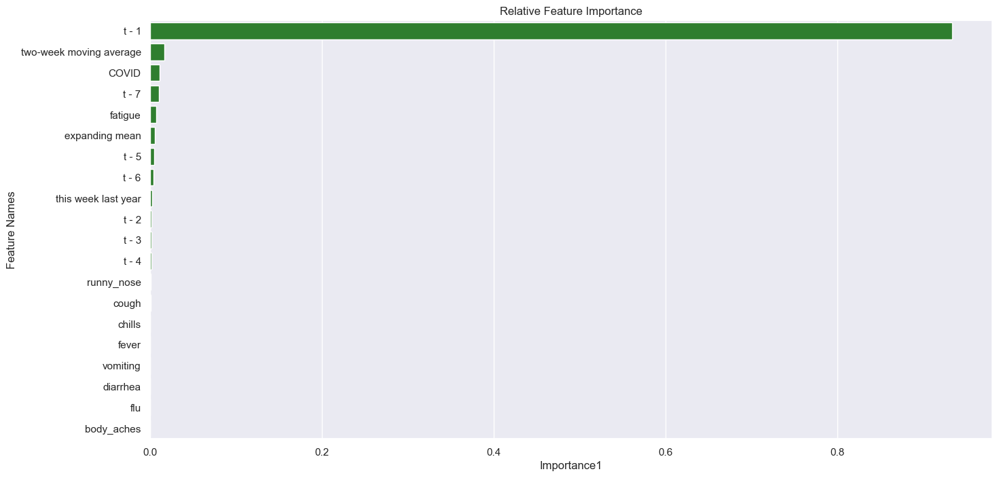

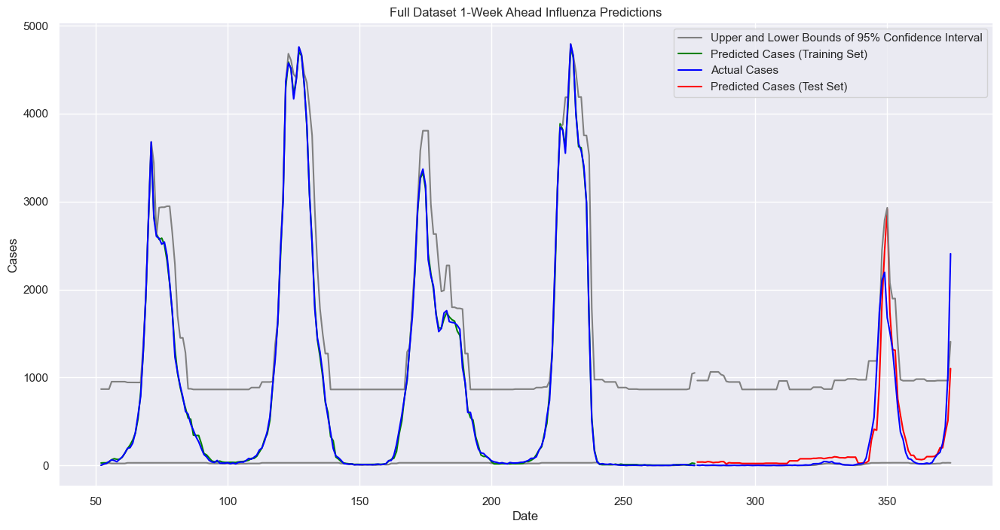

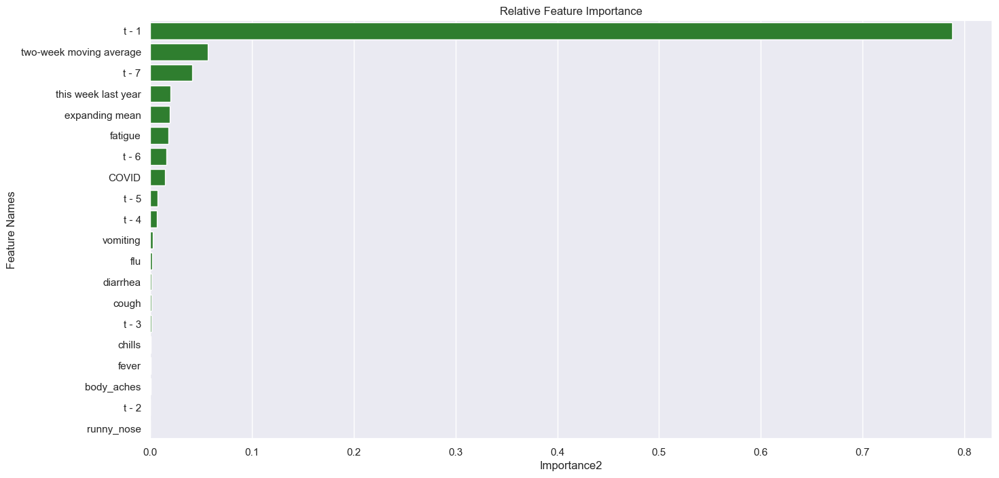

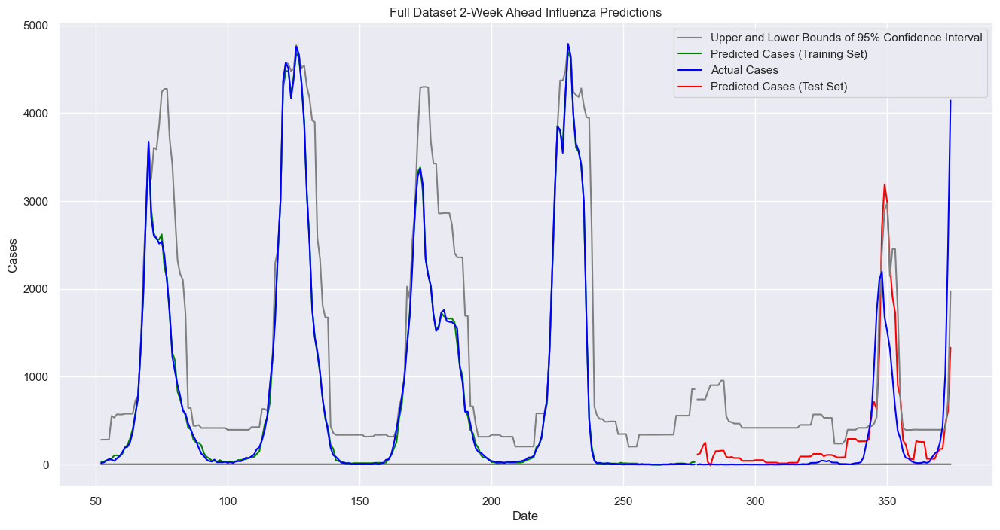

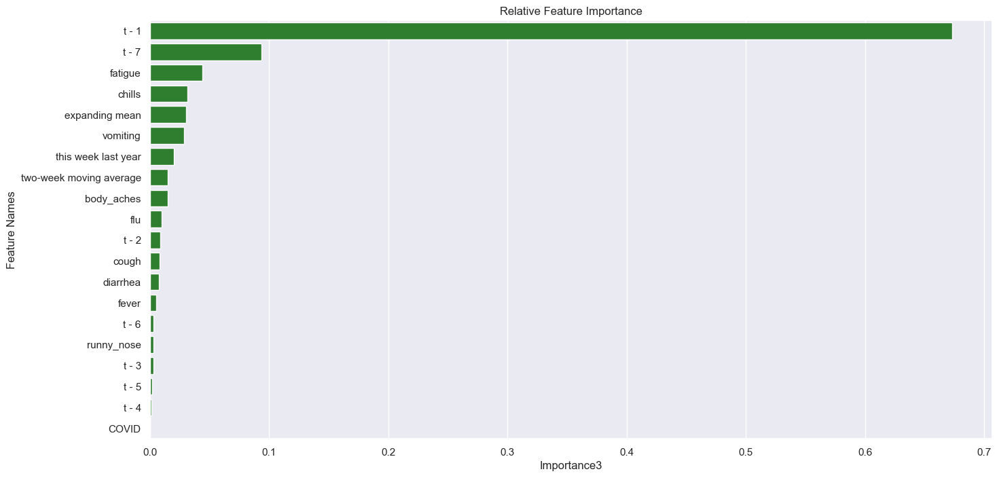

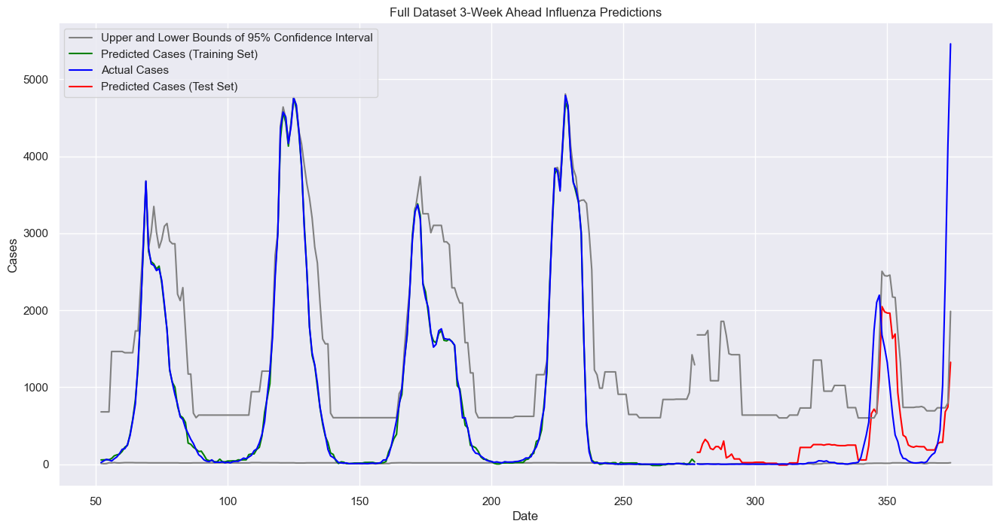

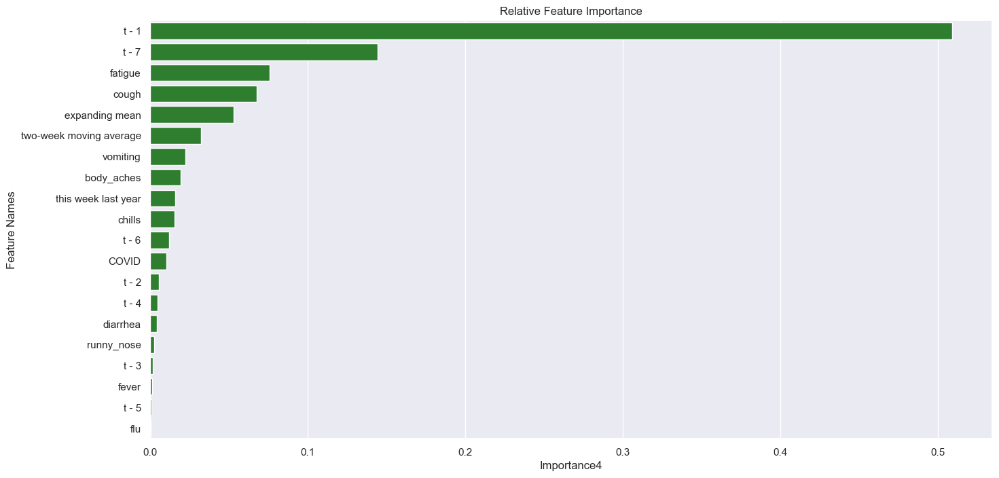

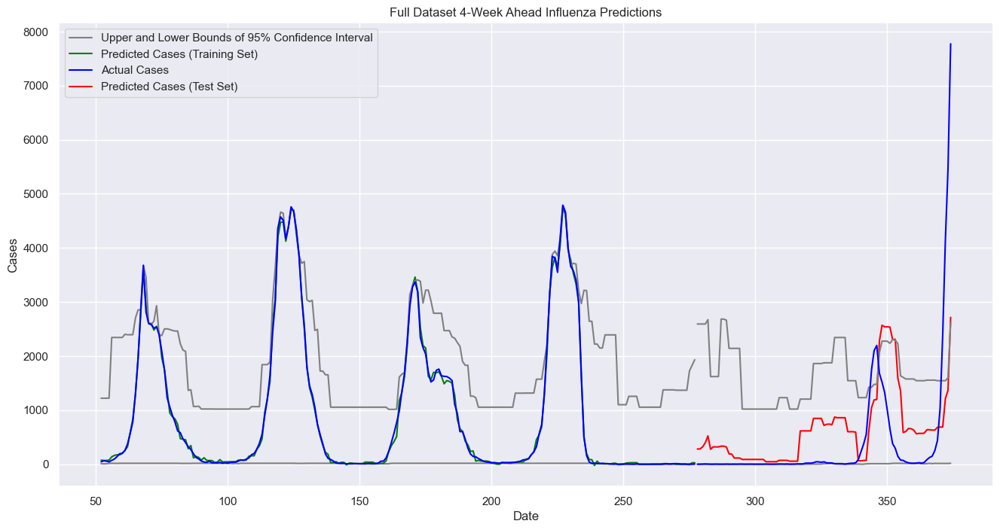

In [207]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [208]:
feature_to_drop

'runny_nose'

In [209]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3575.33,958333.96,59.79,978.95,40.09,595.63,0.997958,0.239299
0,Gradient Boost,Full Dataset,1,1091.26,54703.53,33.03,233.89,22.94,104.83,0.999377,0.790375
0,Gradient Boost,Full Dataset,2,1781.5,236459.29,42.21,486.27,27.93,234.92,0.998982,0.434266
0,Gradient Boost,Full Dataset,3,1834.94,455630.64,42.84,675.0,29.59,325.57,0.998952,0.342839


In [210]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

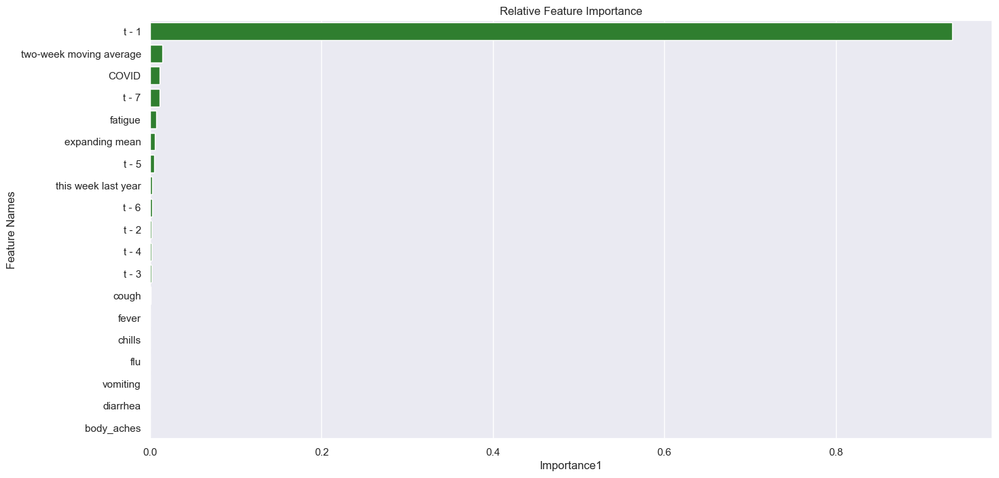

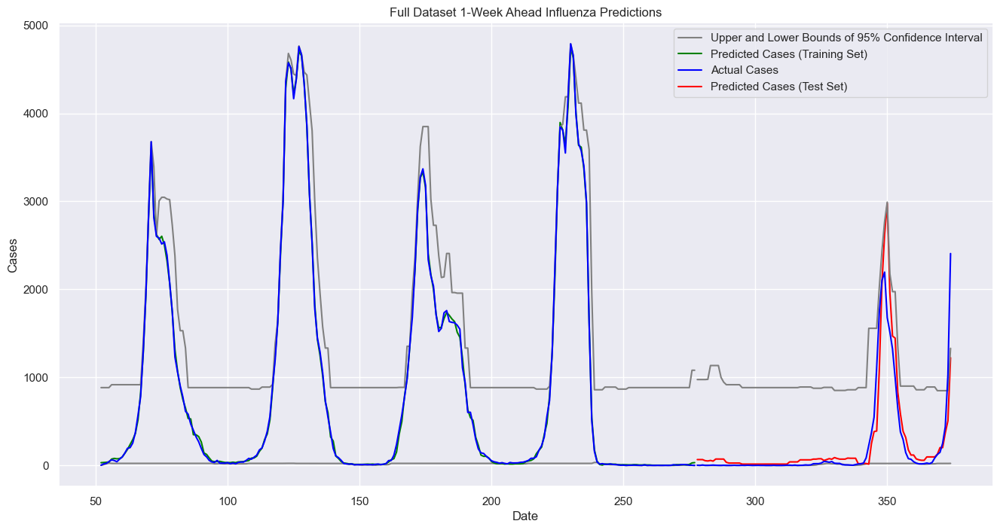

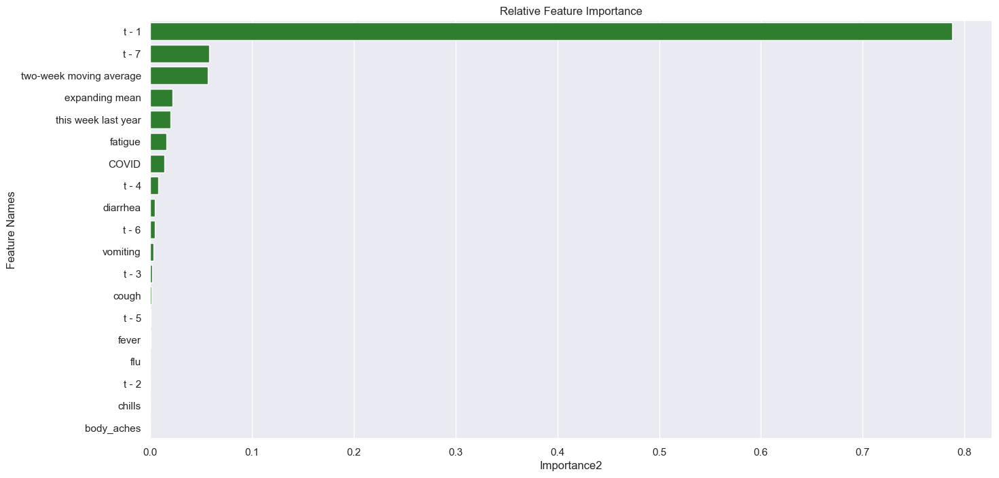

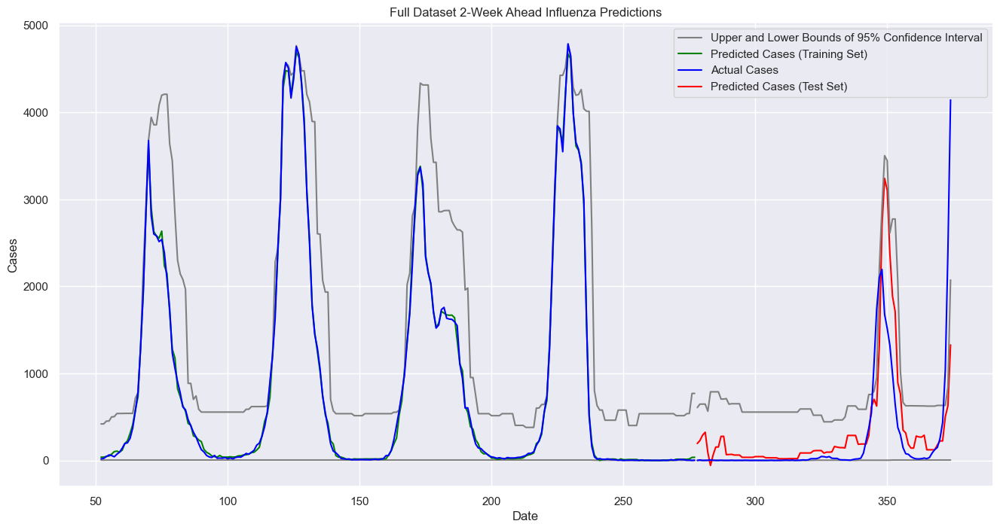

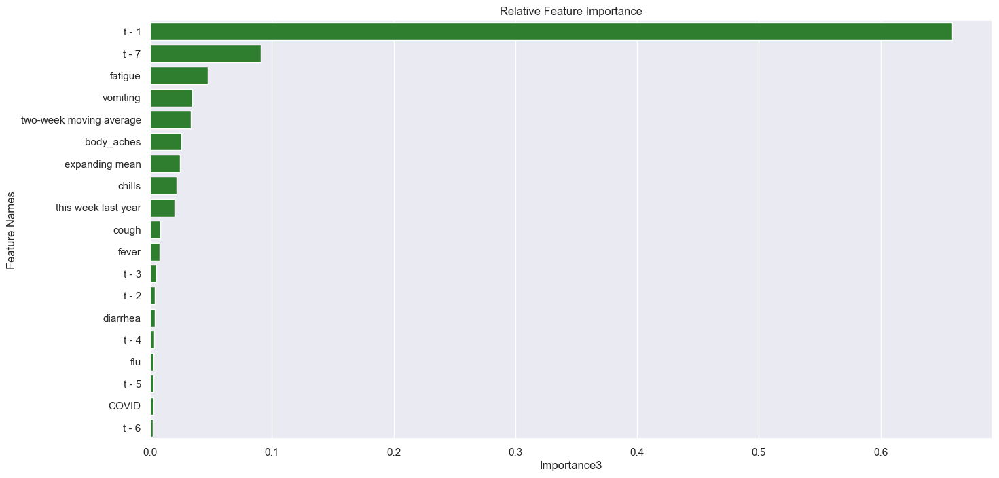

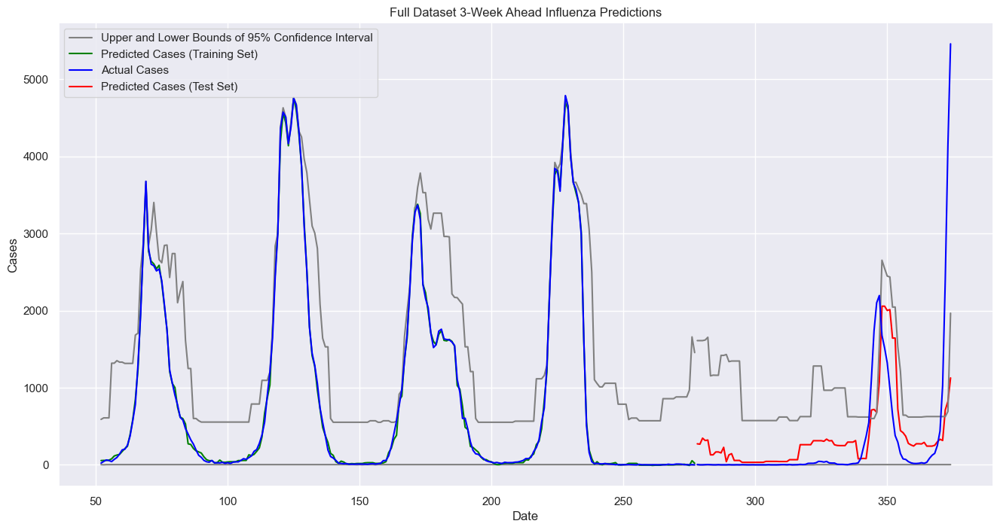

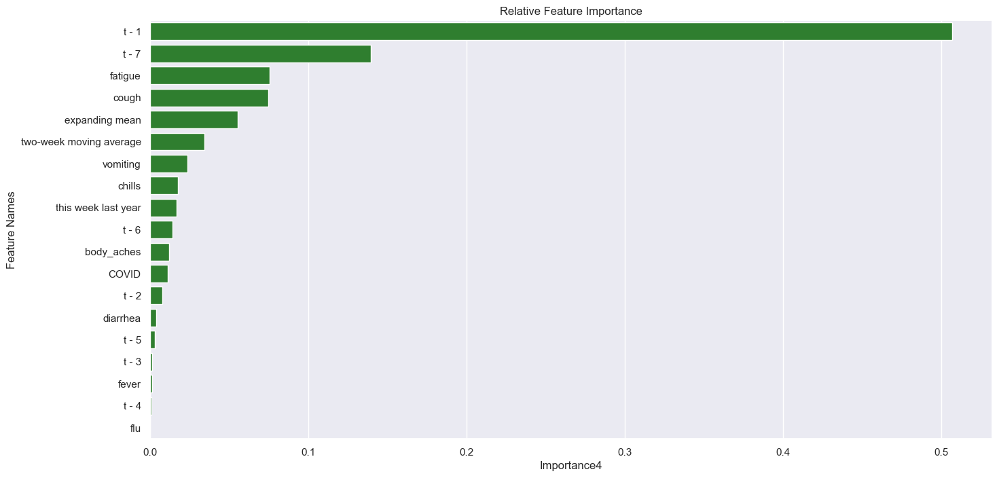

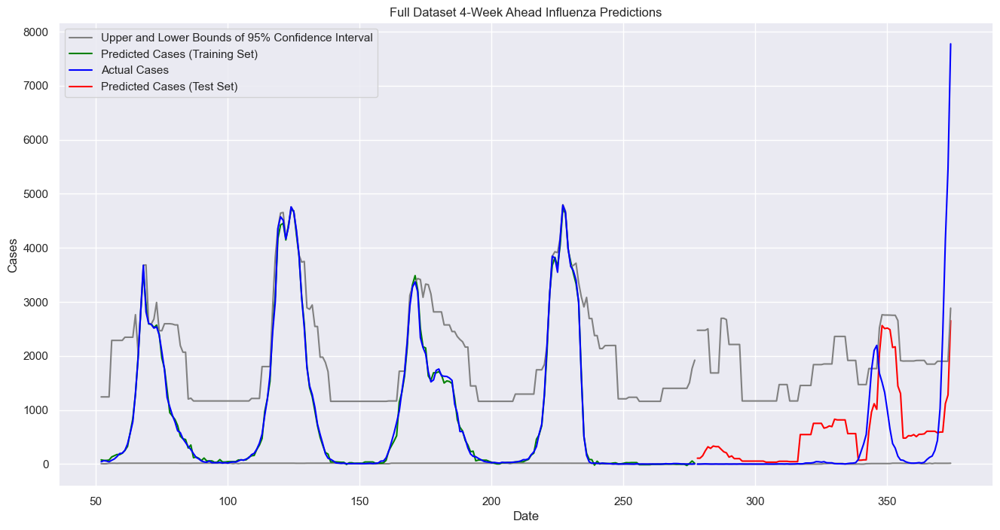

In [211]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [212]:
feature_to_drop

'flu'

In [213]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3555.18,972089.33,59.63,985.95,40.05,622.63,0.997969,0.228381
0,Gradient Boost,Full Dataset,1,1136.28,54599.96,33.71,233.67,22.99,106.84,0.999351,0.790772
0,Gradient Boost,Full Dataset,2,1916.6,244281.99,43.78,494.25,29.11,246.11,0.998905,0.41555
0,Gradient Boost,Full Dataset,3,1955.65,470433.29,44.22,685.88,29.88,342.16,0.998883,0.321489


In [214]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

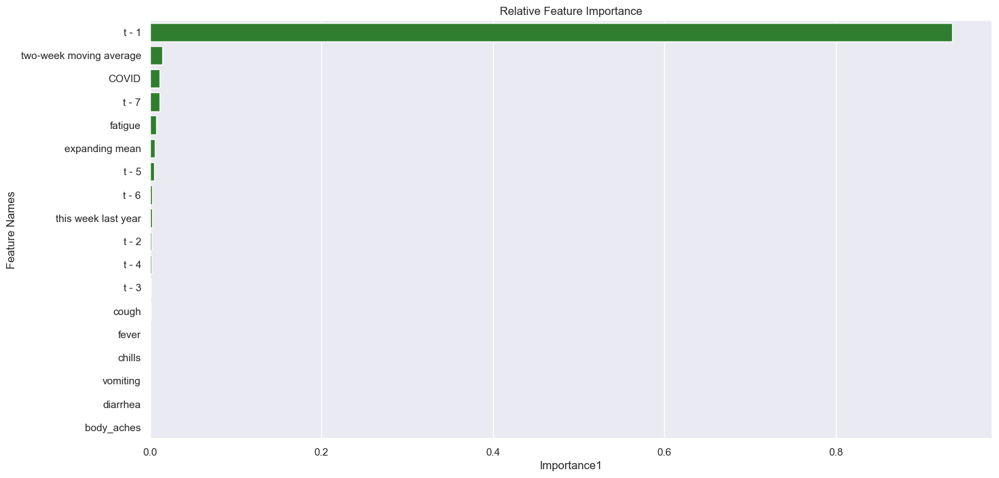

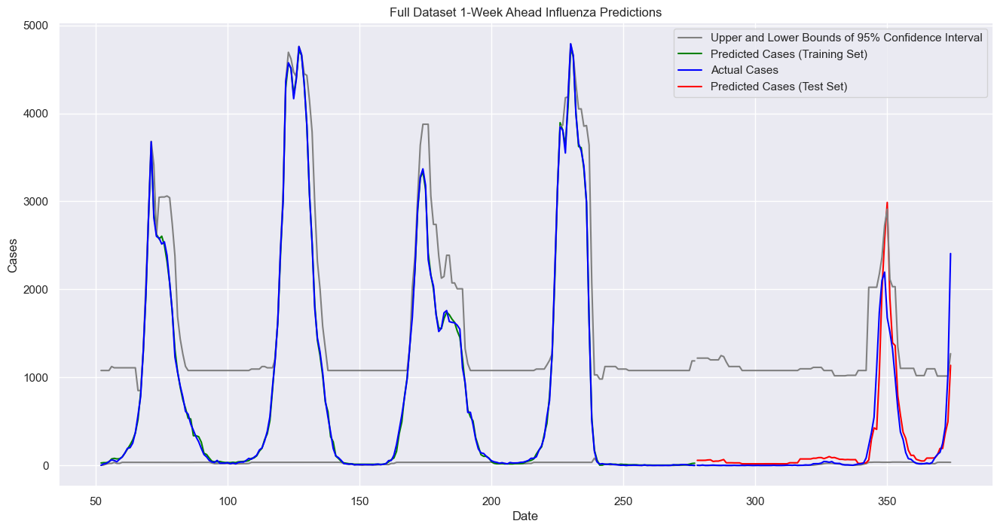

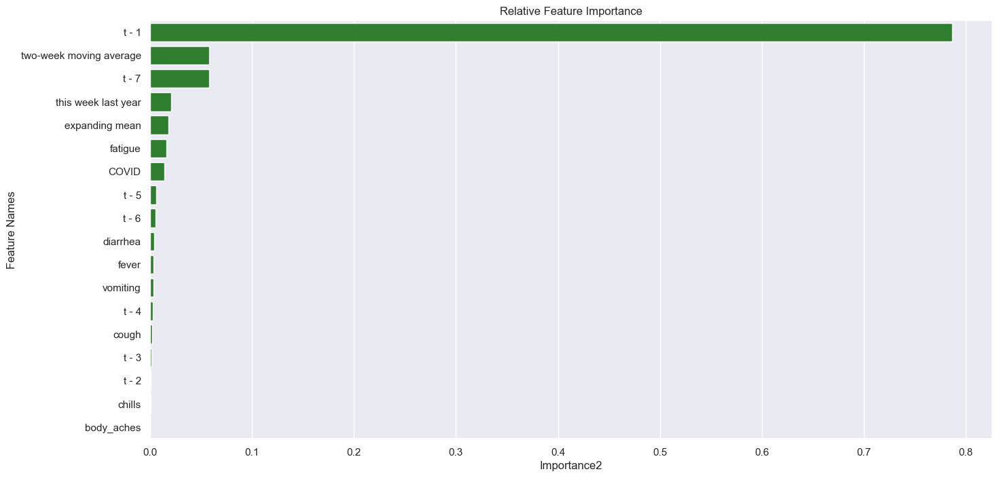

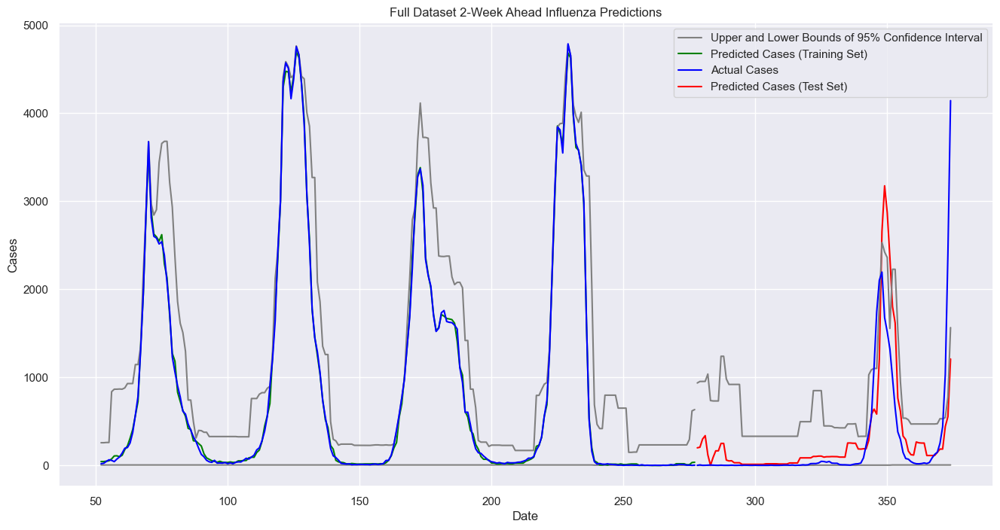

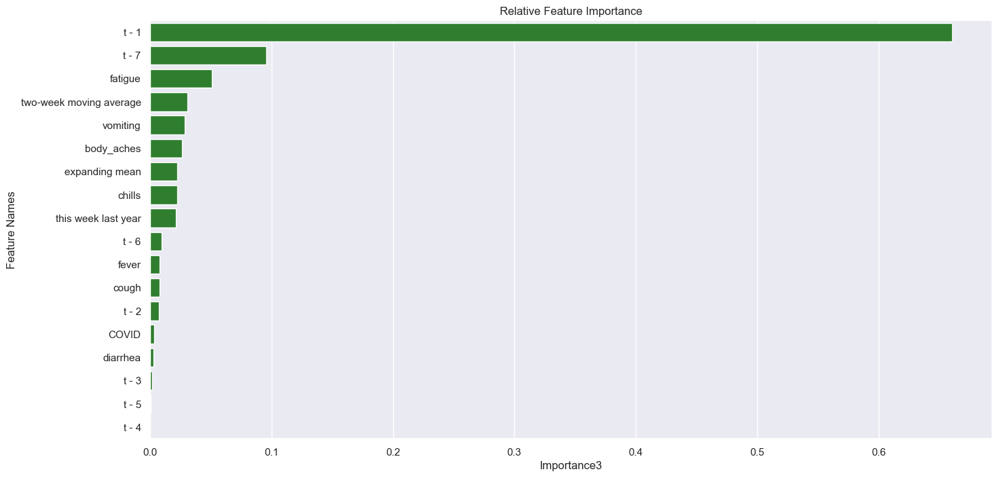

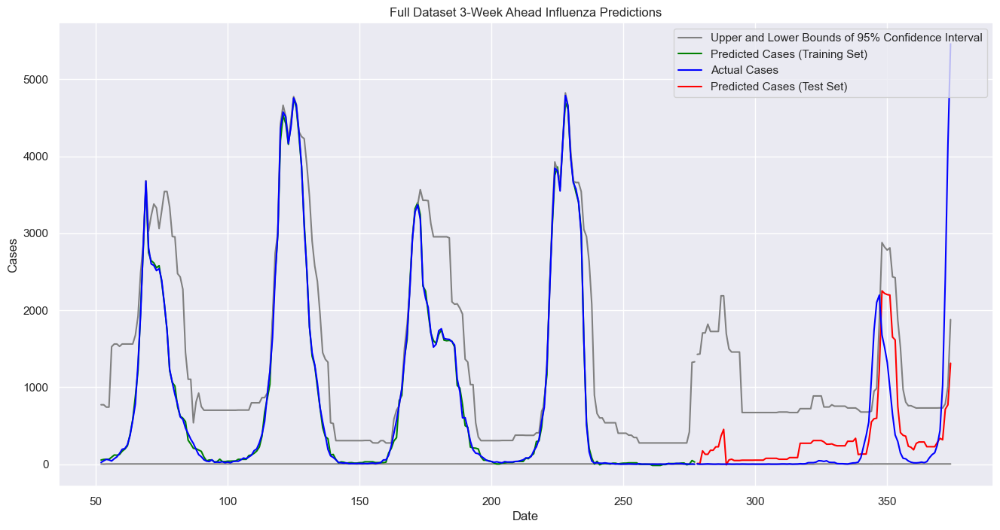

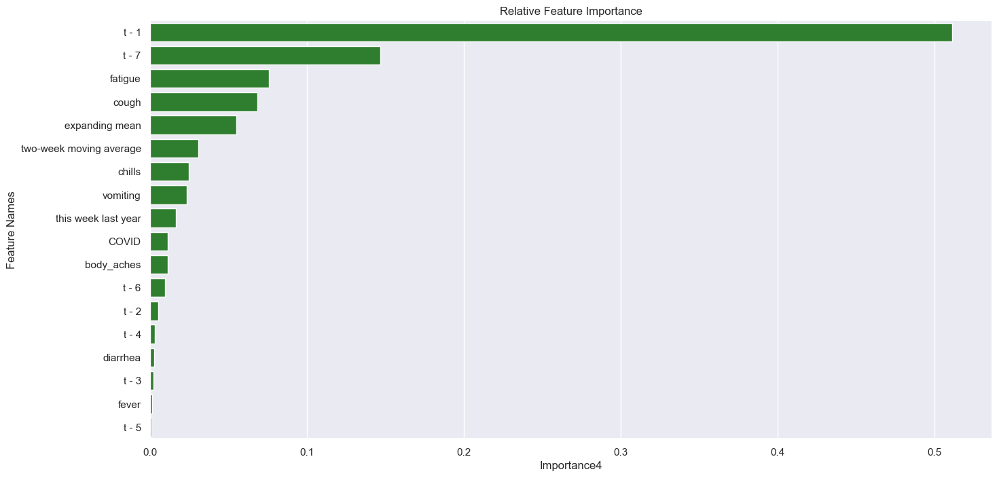

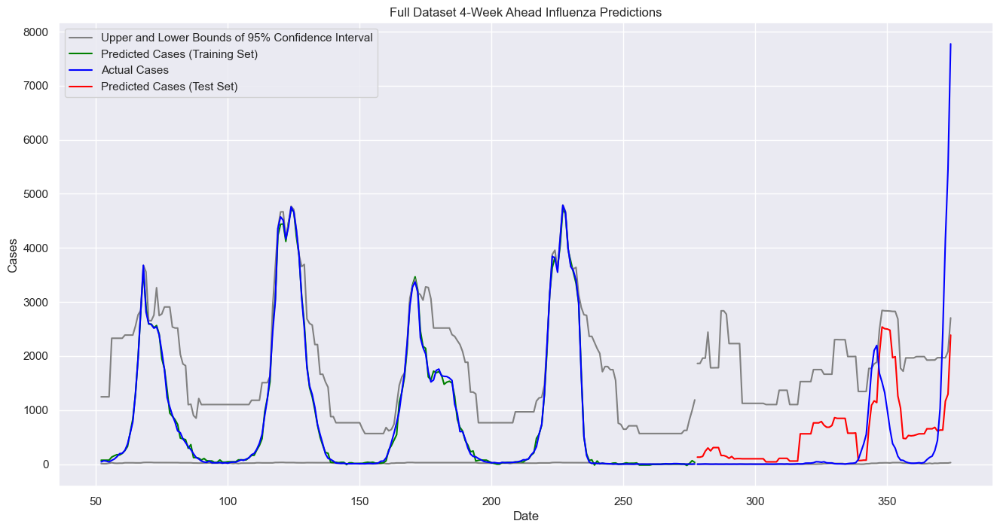

In [215]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [216]:
feature_to_drop

't - 3'

In [217]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3403.89,946092.43,58.34,972.67,39.67,581.77,0.998056,0.249016
0,Gradient Boost,Full Dataset,1,1084.07,55056.54,32.93,234.64,22.35,104.04,0.999381,0.789022
0,Gradient Boost,Full Dataset,2,1760.27,240292.41,41.96,490.2,28.03,231.25,0.998994,0.425095
0,Gradient Boost,Full Dataset,3,2407.95,470056.84,49.07,685.61,32.37,344.94,0.998624,0.322032


In [218]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

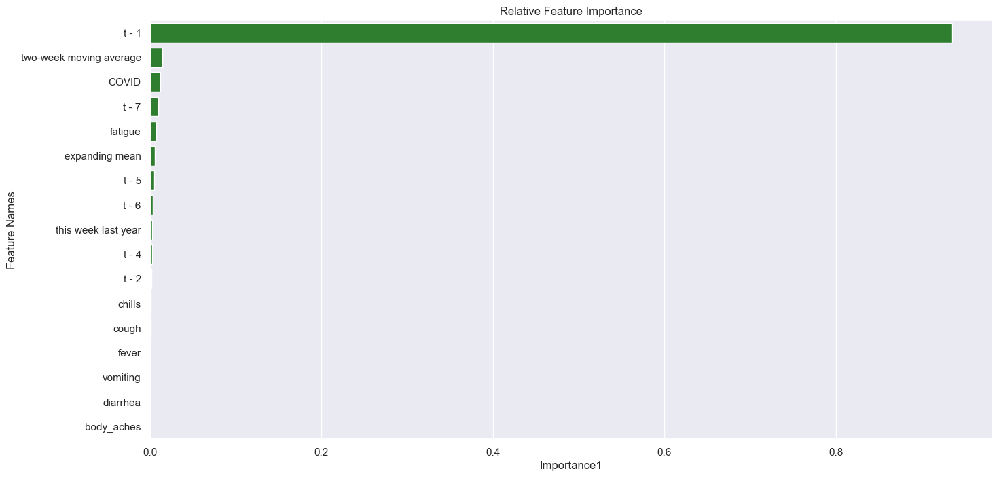

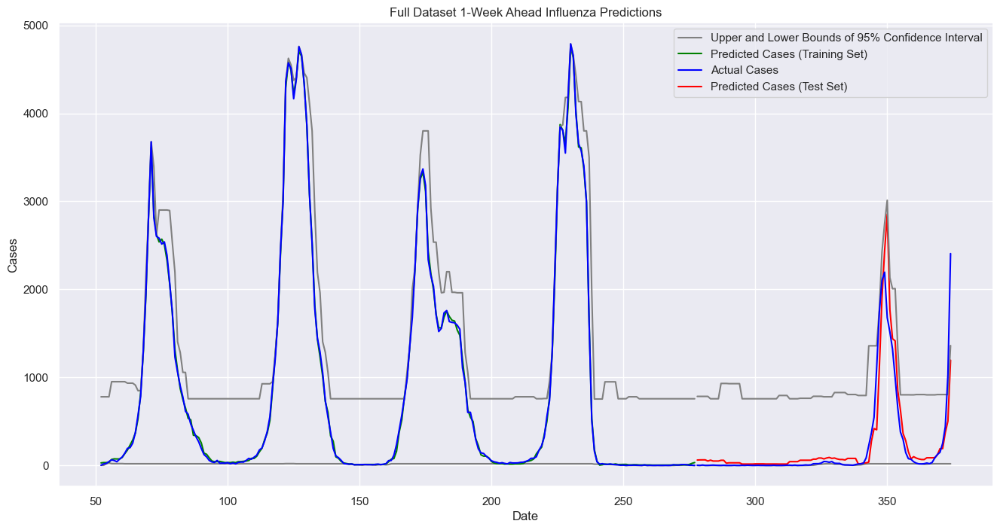

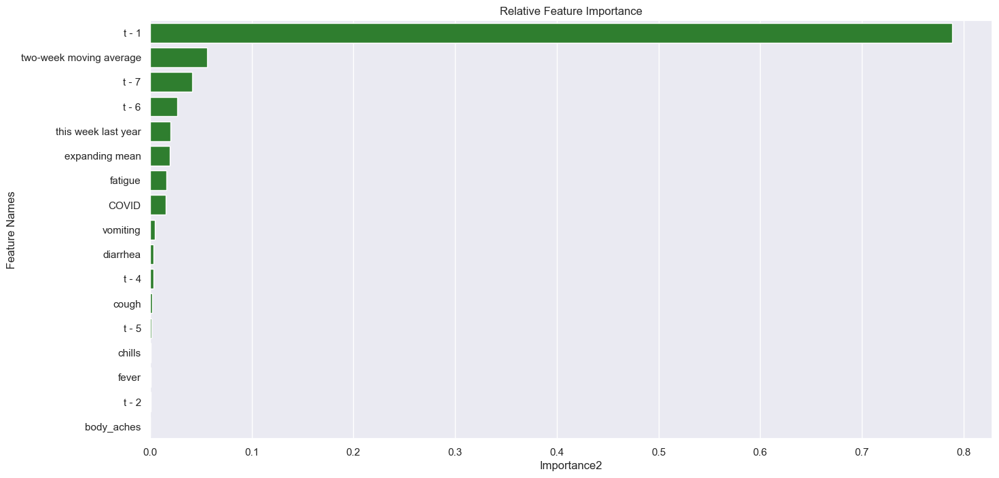

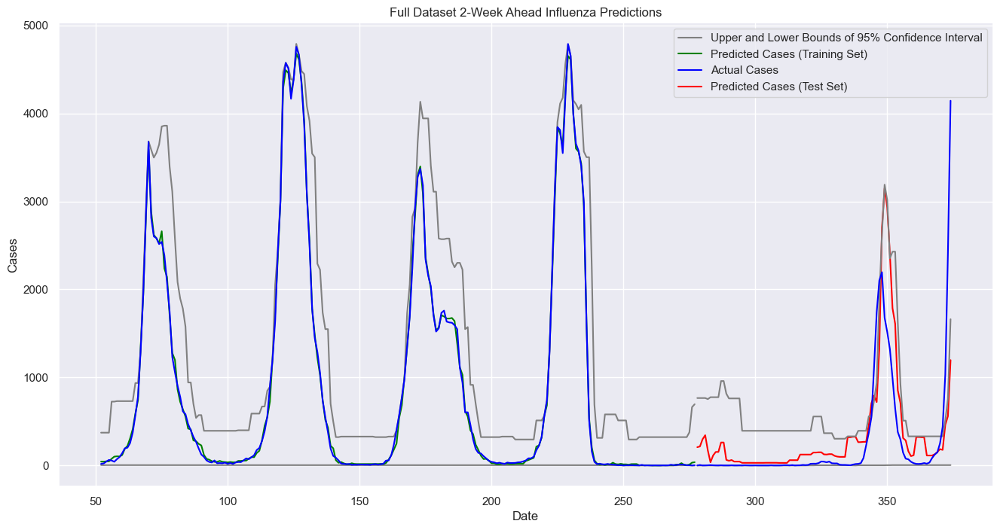

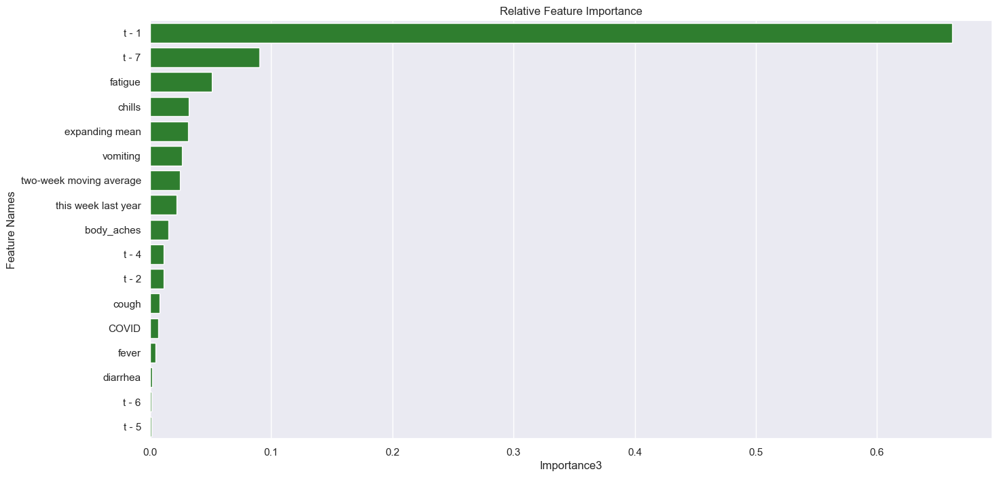

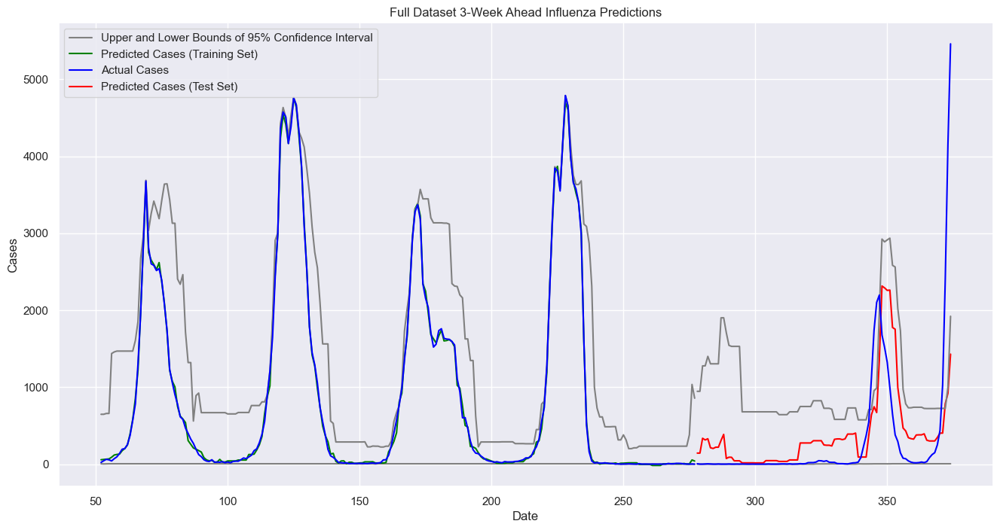

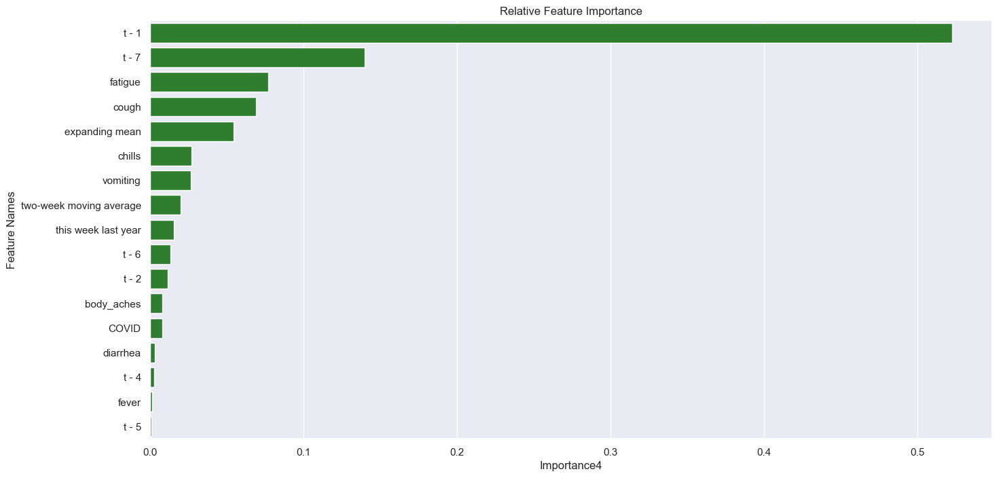

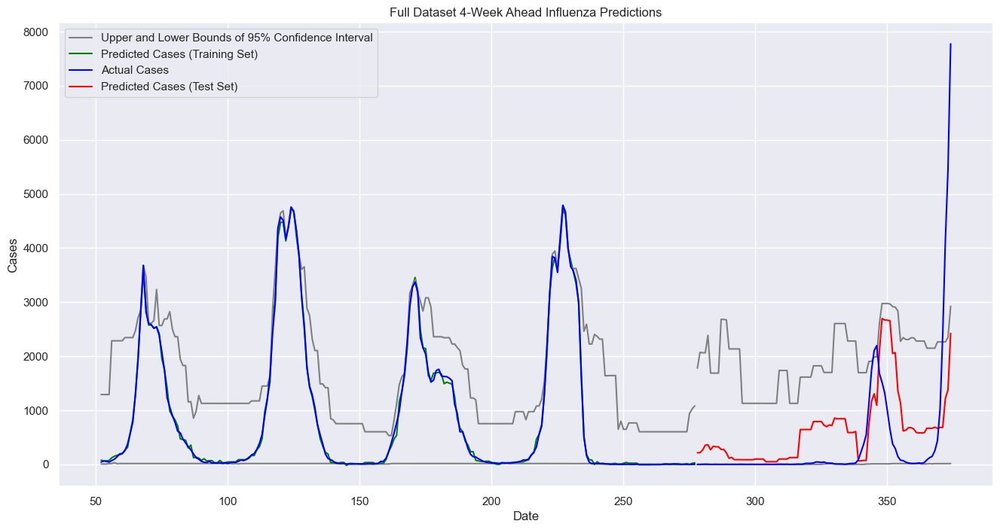

In [219]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [220]:
feature_to_drop

'fever'

In [221]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3459.84,944801.87,58.82,972.01,39.92,581.08,0.998024,0.250041
0,Gradient Boost,Full Dataset,1,1015.89,48904.42,31.87,221.14,21.99,100.99,0.99942,0.812597
0,Gradient Boost,Full Dataset,2,1925.19,243100.94,43.88,493.05,29.23,250.26,0.9989,0.418376
0,Gradient Boost,Full Dataset,3,1960.91,466637.04,44.28,683.11,29.89,367.31,0.99888,0.326965


In [222]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

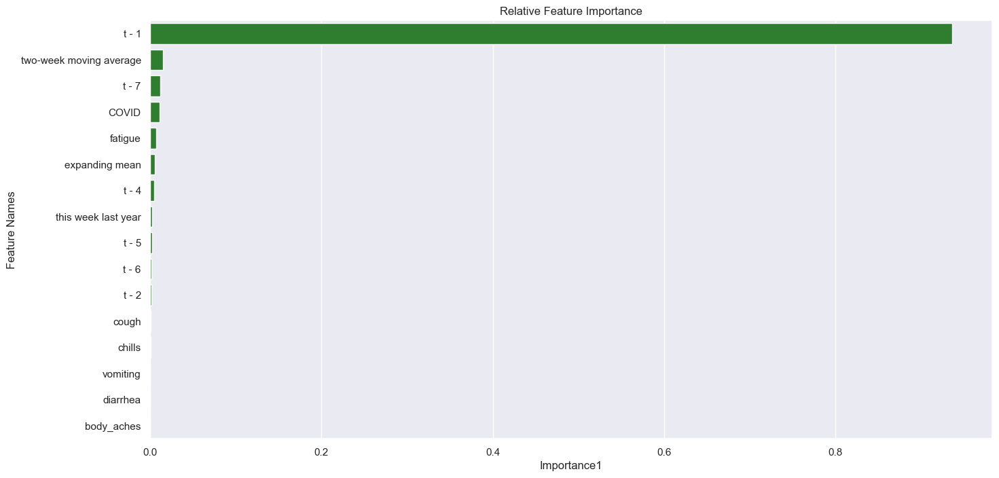

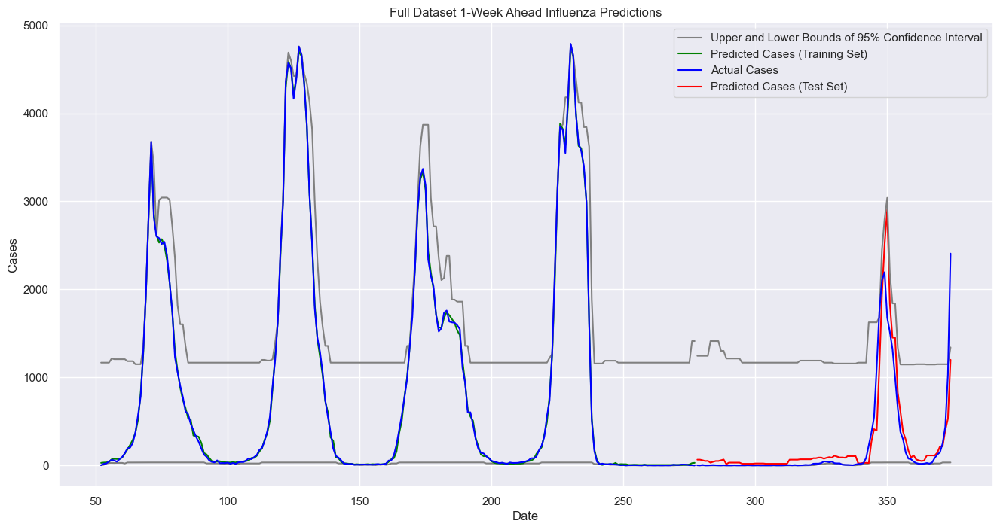

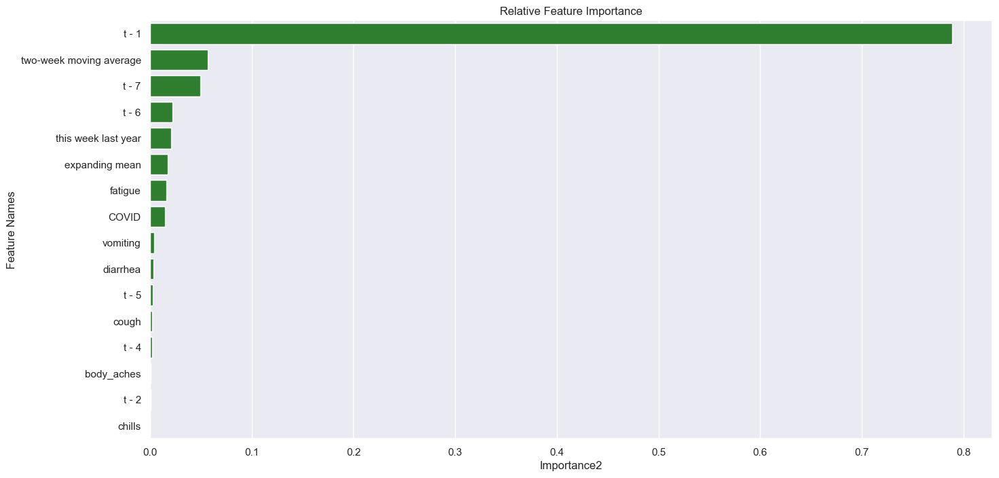

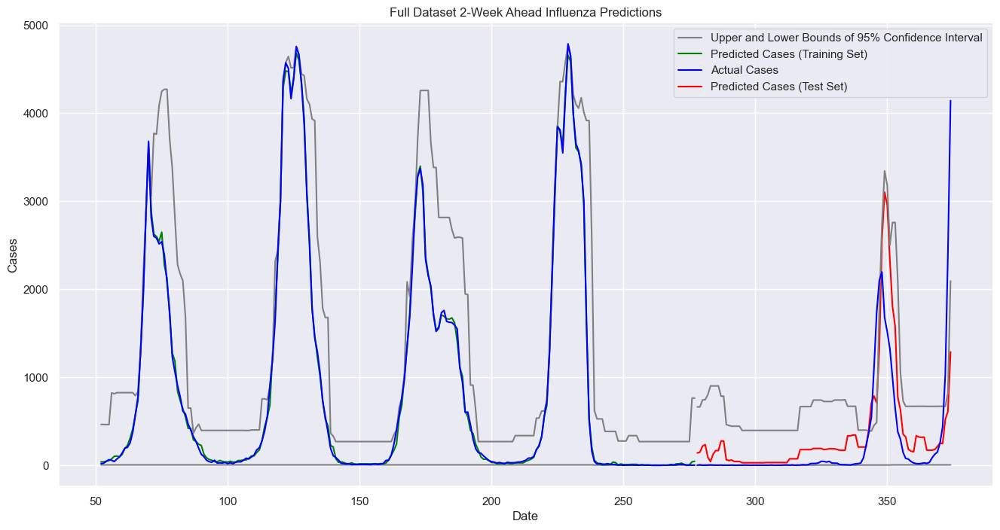

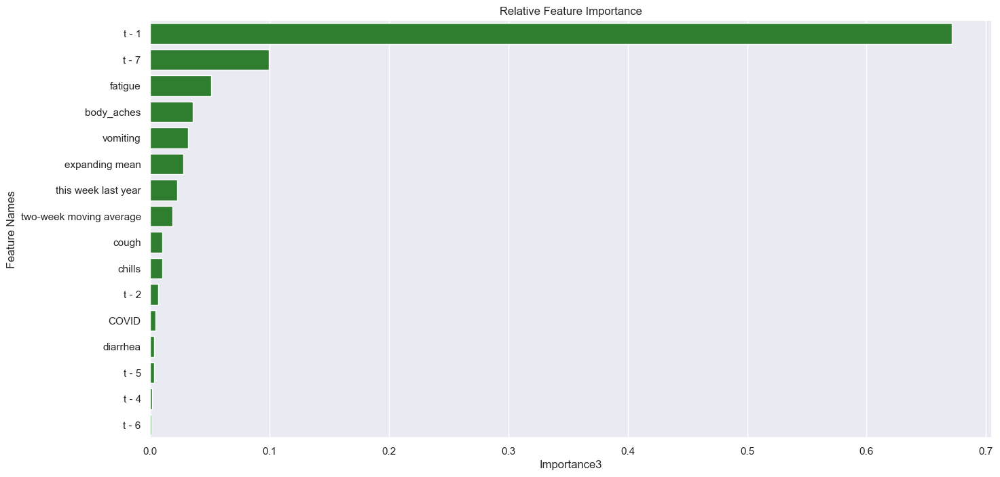

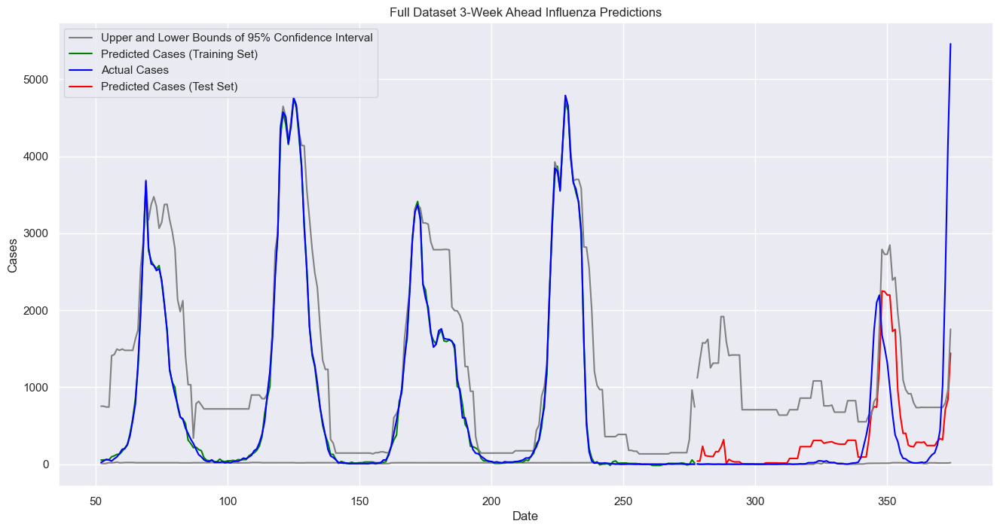

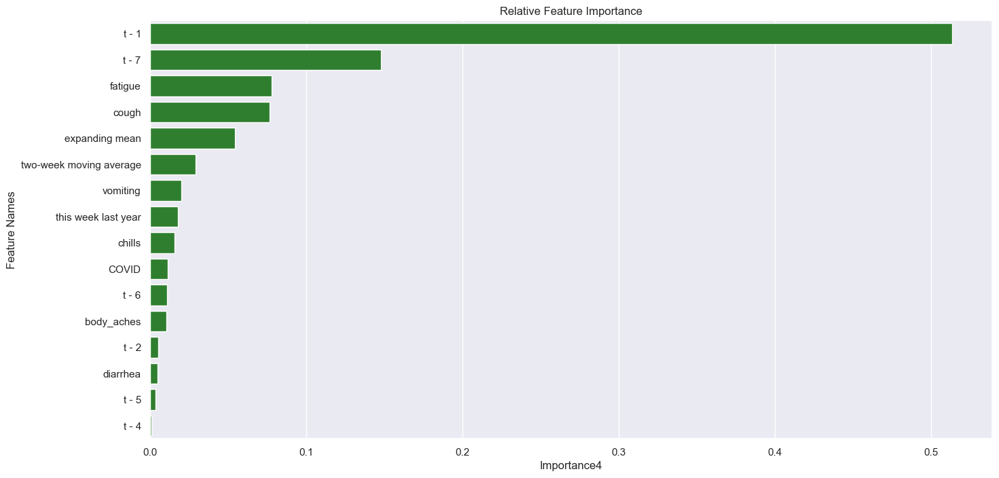

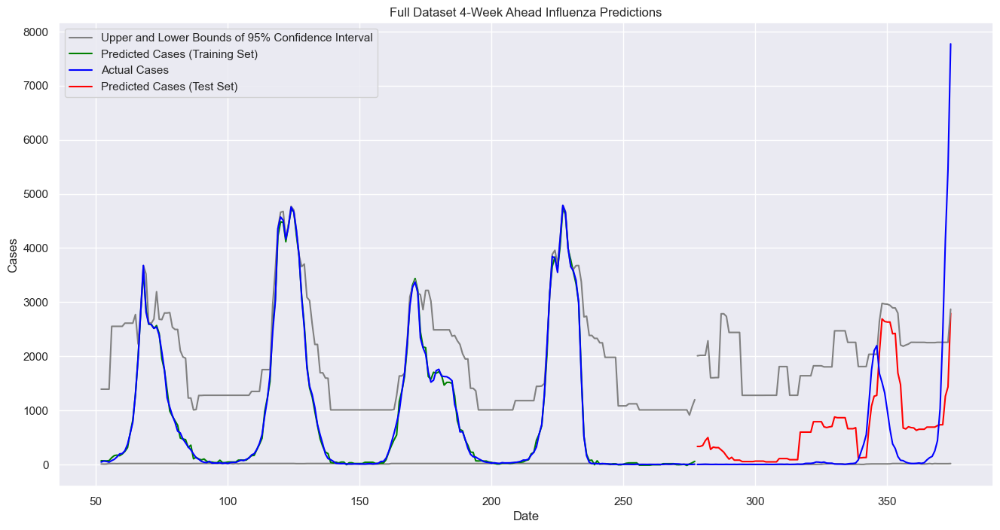

In [223]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [224]:
feature_to_drop

't - 4'

In [225]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3393.28,978780.79,58.25,989.33,38.93,613.94,0.998062,0.223069
0,Gradient Boost,Full Dataset,1,1044.84,51553.28,32.32,227.05,22.3,107.94,0.999403,0.802447
0,Gradient Boost,Full Dataset,2,1967.61,232120.84,44.36,481.79,29.45,253.79,0.998876,0.444646
0,Gradient Boost,Full Dataset,3,2077.1,452020.4,45.58,672.32,31.4,331.43,0.998813,0.348046


In [226]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

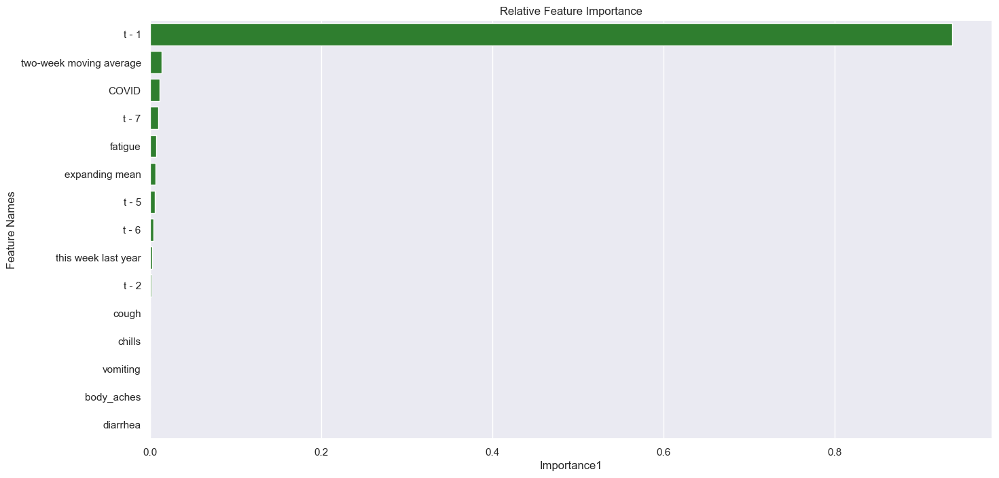

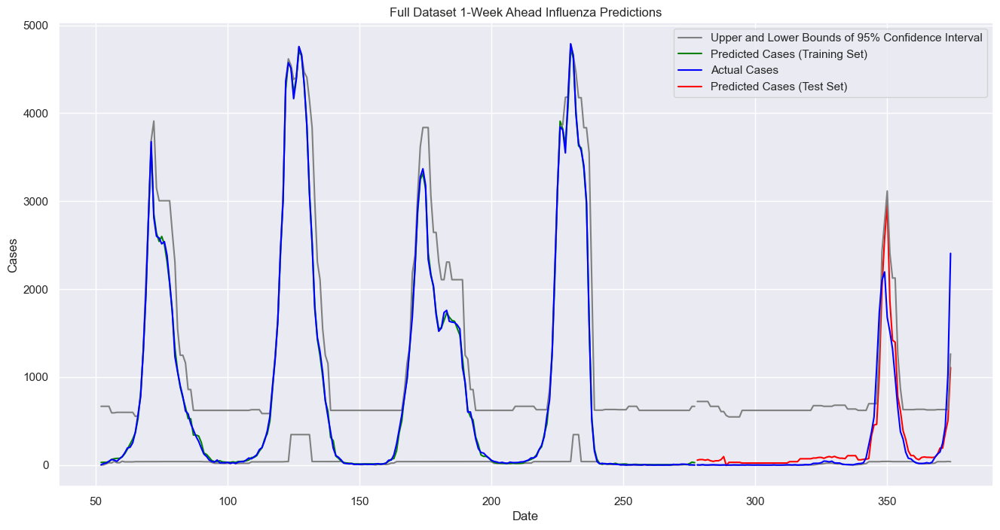

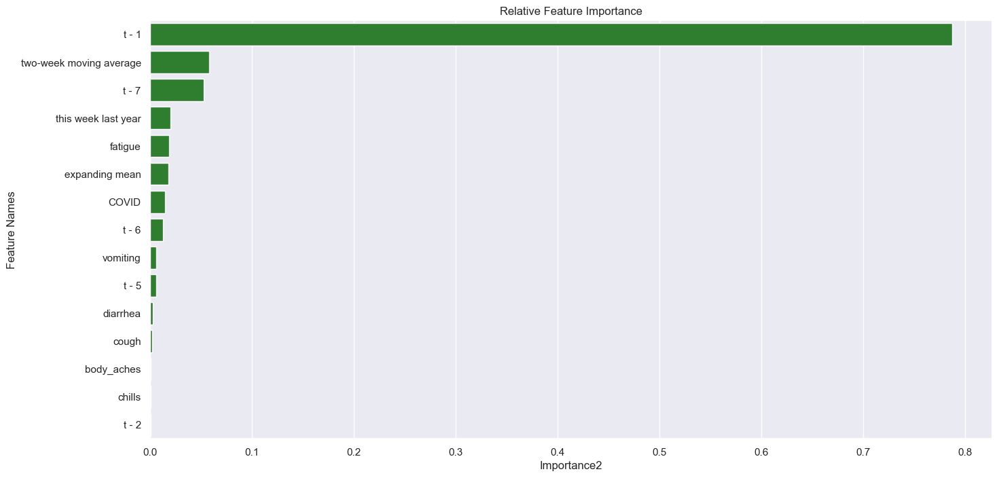

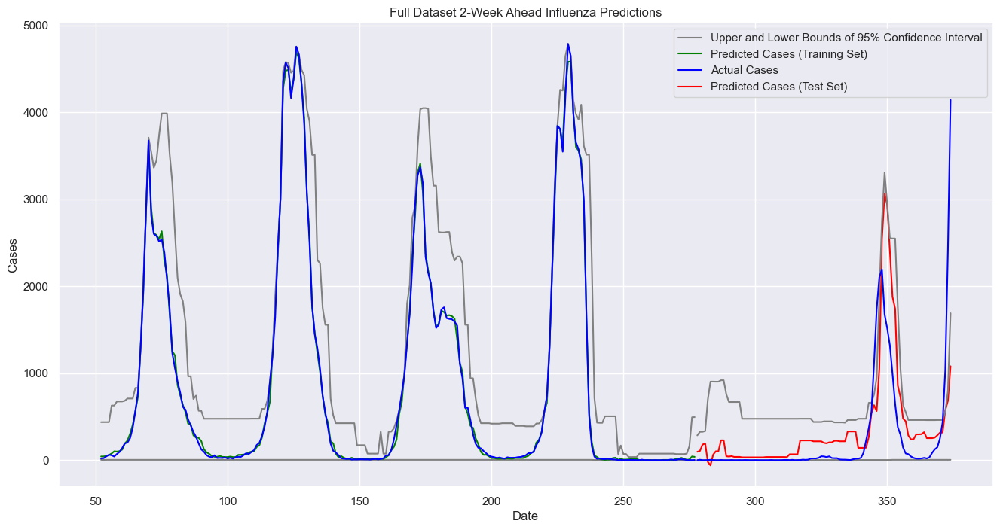

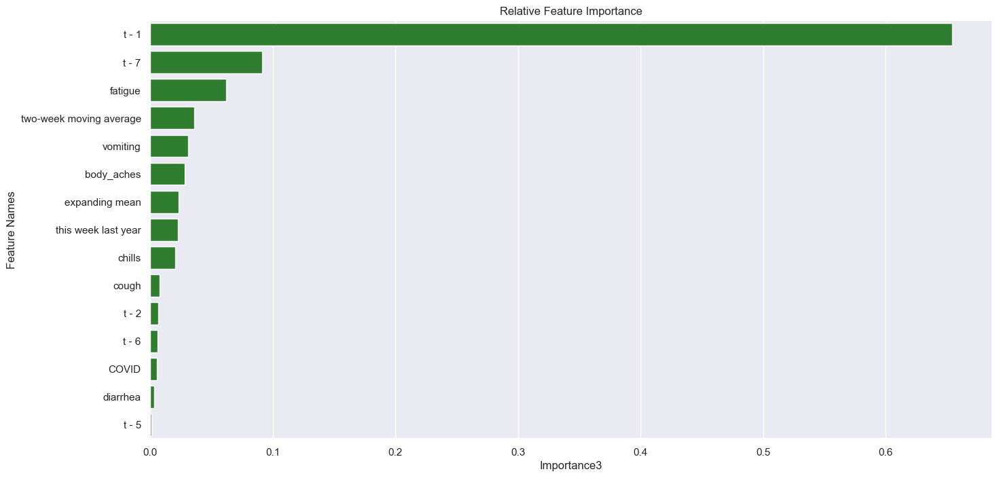

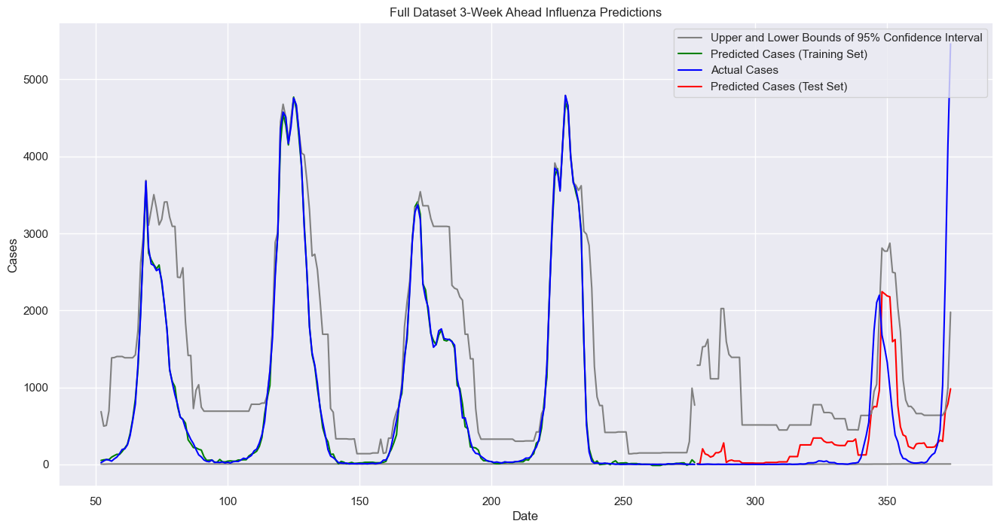

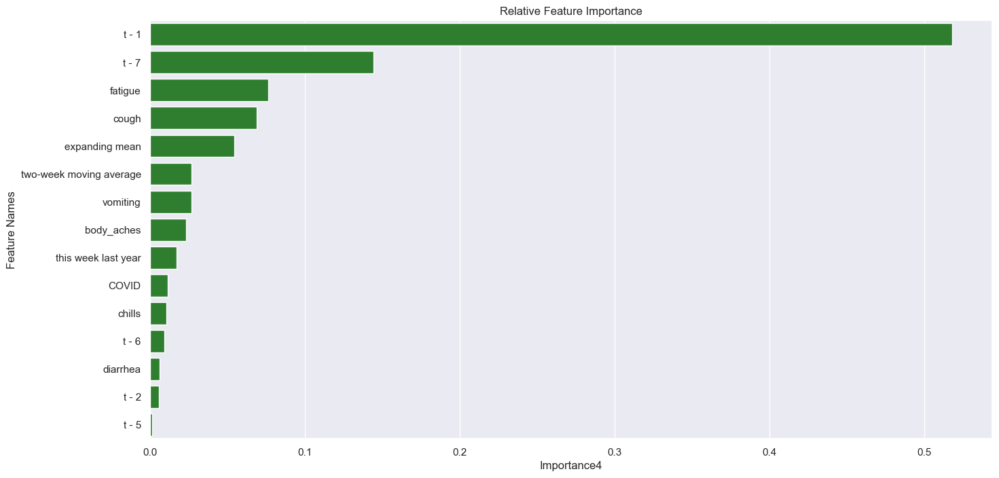

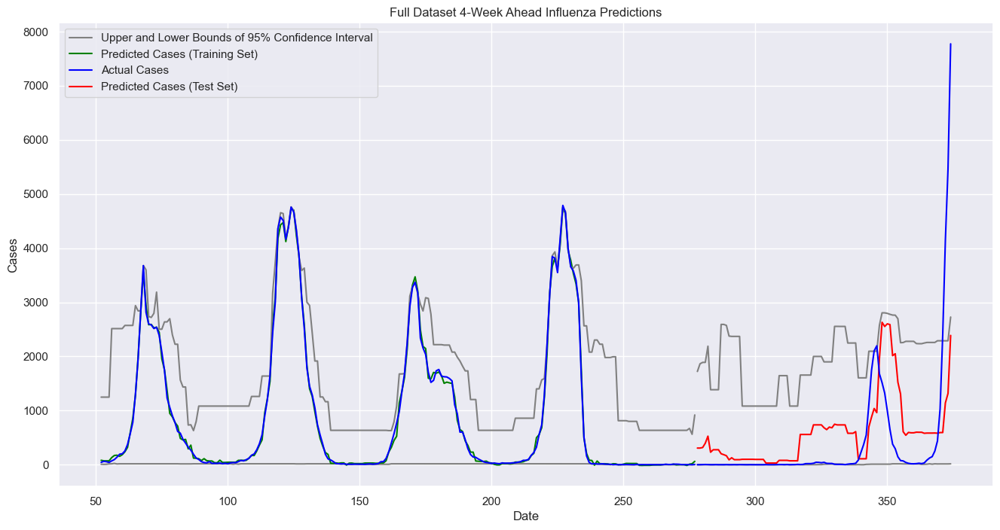

In [227]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [228]:
feature_to_drop

'diarrhea'

In [229]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3228.38,979120.44,56.82,989.51,38.84,624.16,0.998156,0.2228
0,Gradient Boost,Full Dataset,1,1157.58,55296.59,34.02,235.15,23.44,107.64,0.999339,0.788102
0,Gradient Boost,Full Dataset,2,2261.01,260272.57,47.55,510.17,30.72,272.62,0.998708,0.377292
0,Gradient Boost,Full Dataset,3,2394.39,491744.77,48.93,701.25,32.98,334.43,0.998632,0.290752


In [230]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4','diarrhea'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4','diarrhea'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

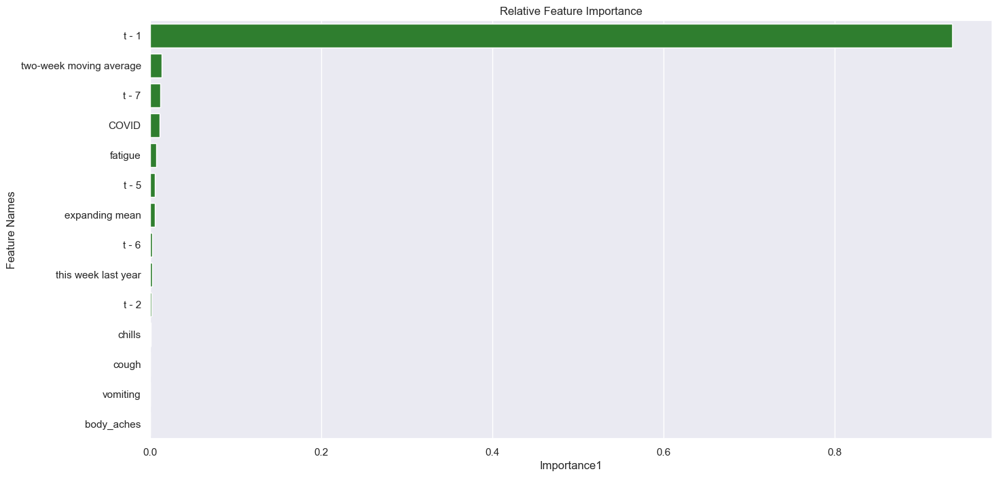

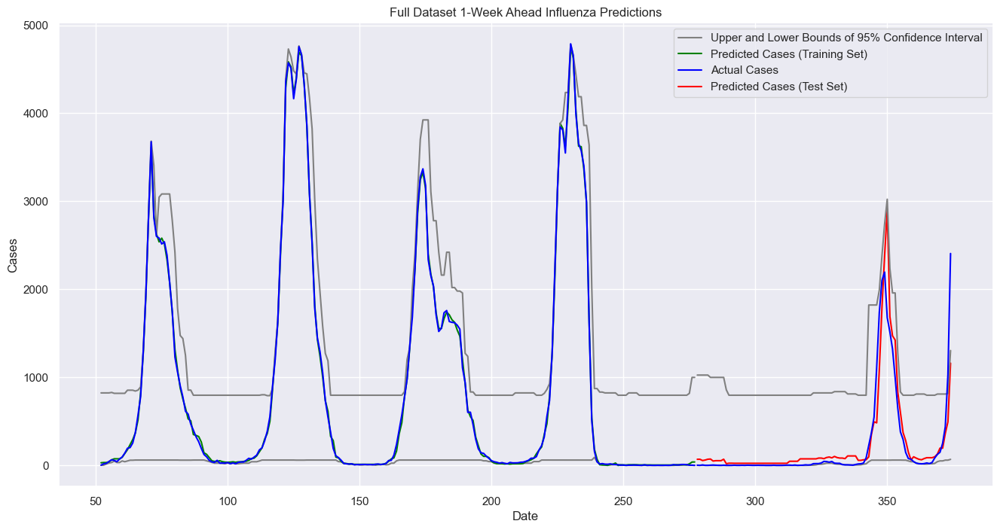

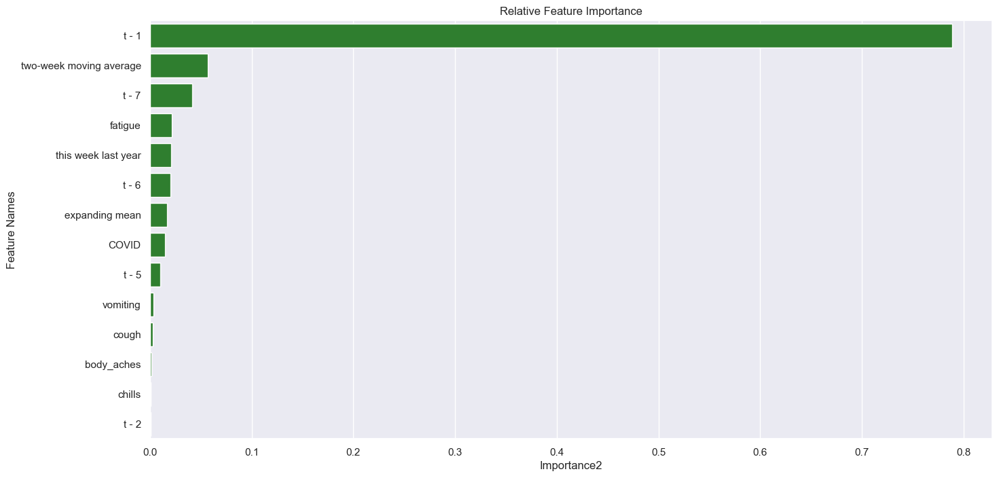

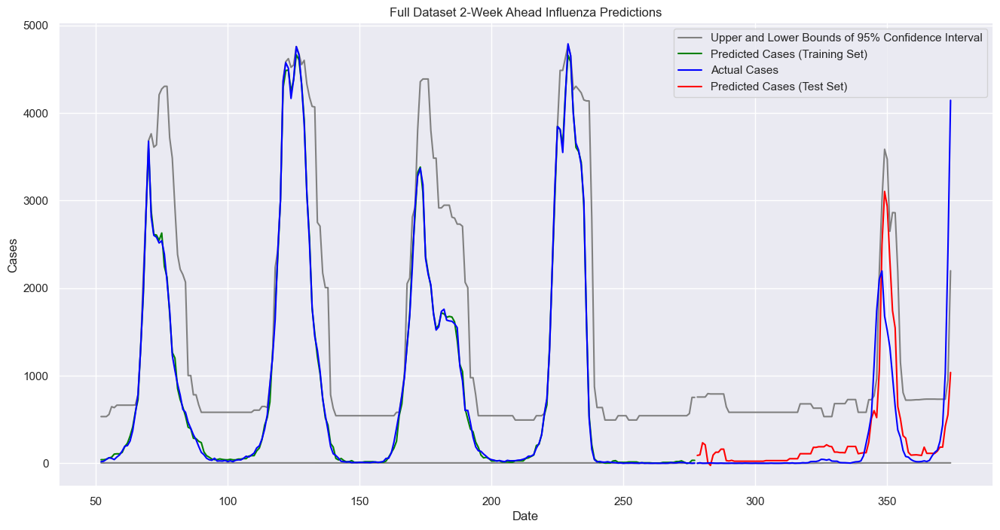

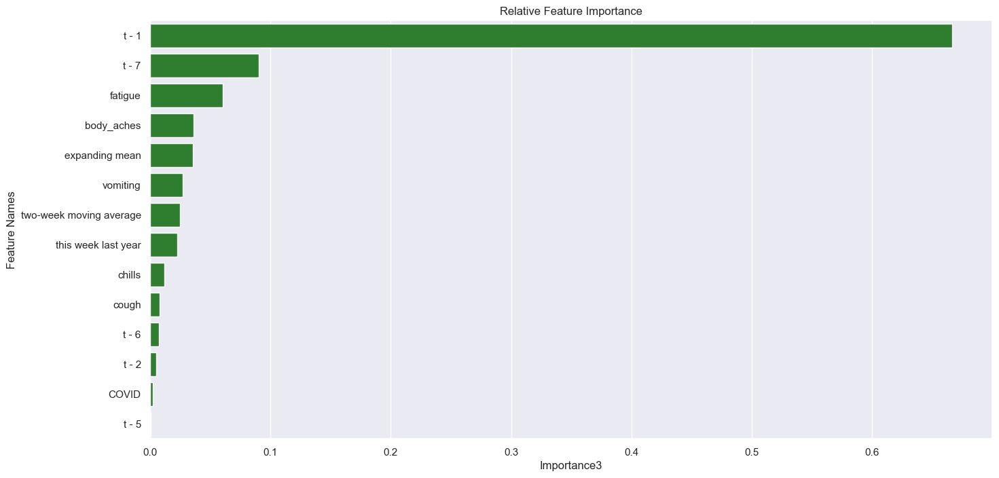

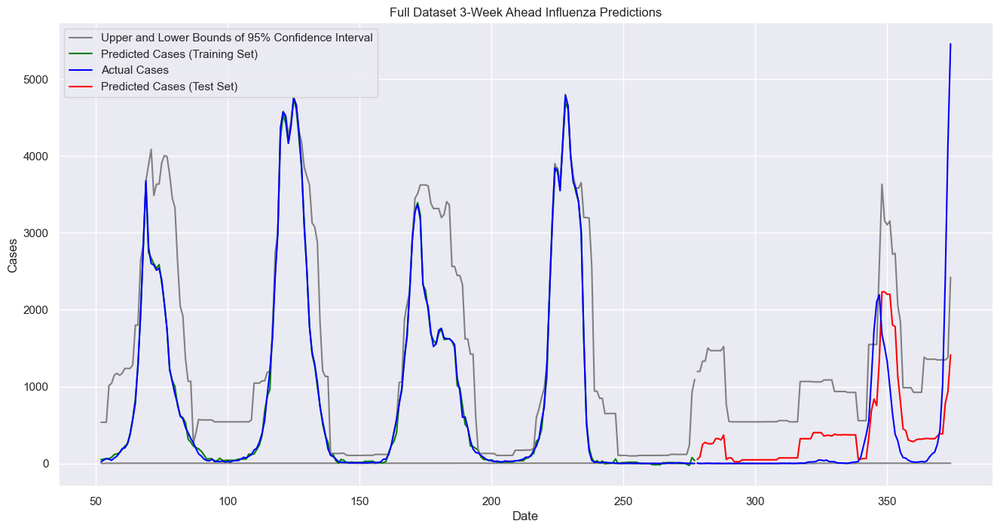

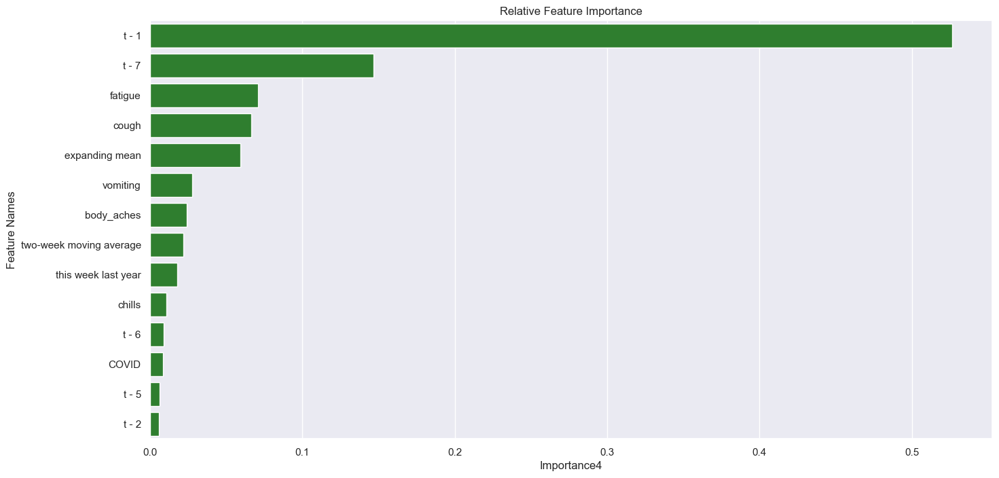

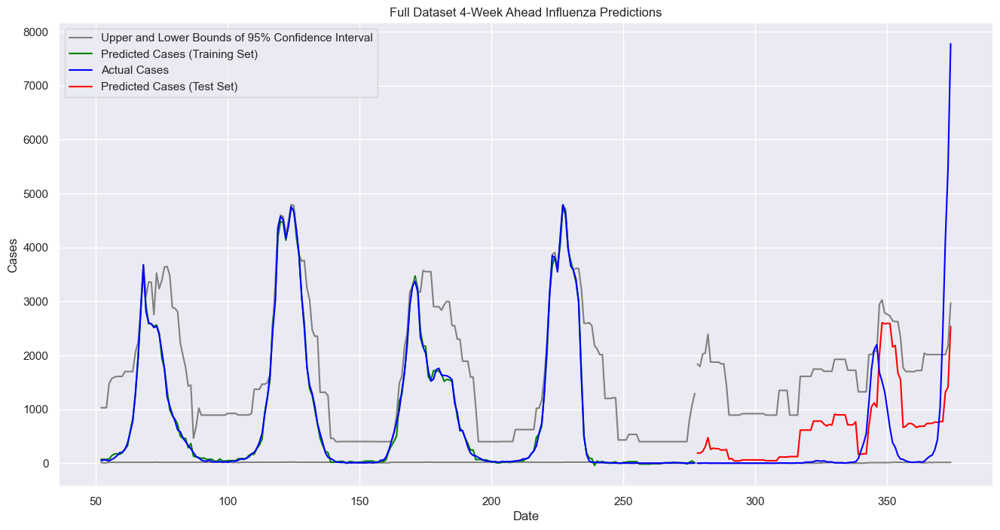

In [231]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [232]:
feature_to_drop

't - 2'

In [233]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3619.93,977832.24,60.17,988.85,41.03,597.09,0.997932,0.223822
0,Gradient Boost,Full Dataset,1,1100.24,50365.51,33.17,224.42,23.19,104.14,0.999371,0.806998
0,Gradient Boost,Full Dataset,2,2102.34,245558.12,45.85,495.54,31.0,224.41,0.998799,0.412497
0,Gradient Boost,Full Dataset,3,2163.9,468925.2,46.52,684.78,31.27,379.48,0.998764,0.323664


In [234]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4','diarrhea','t - 2'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4','diarrhea','t - 2'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

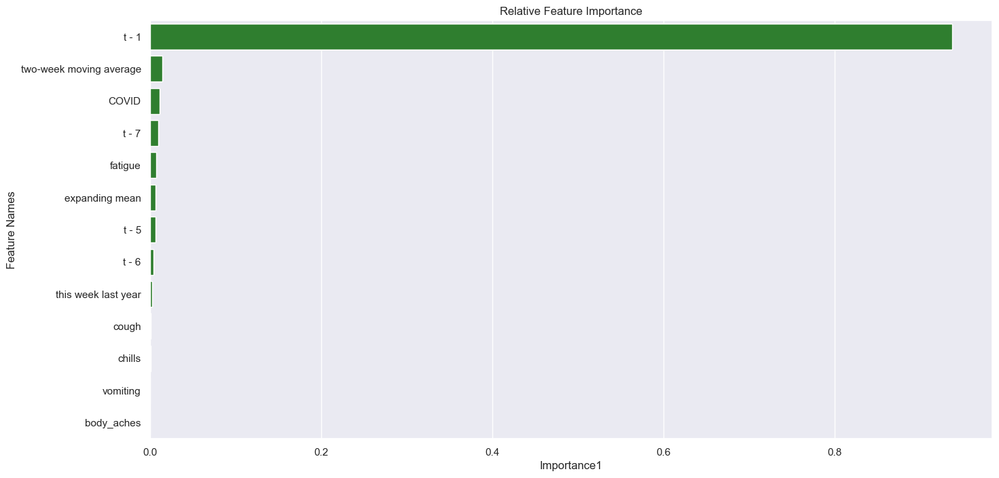

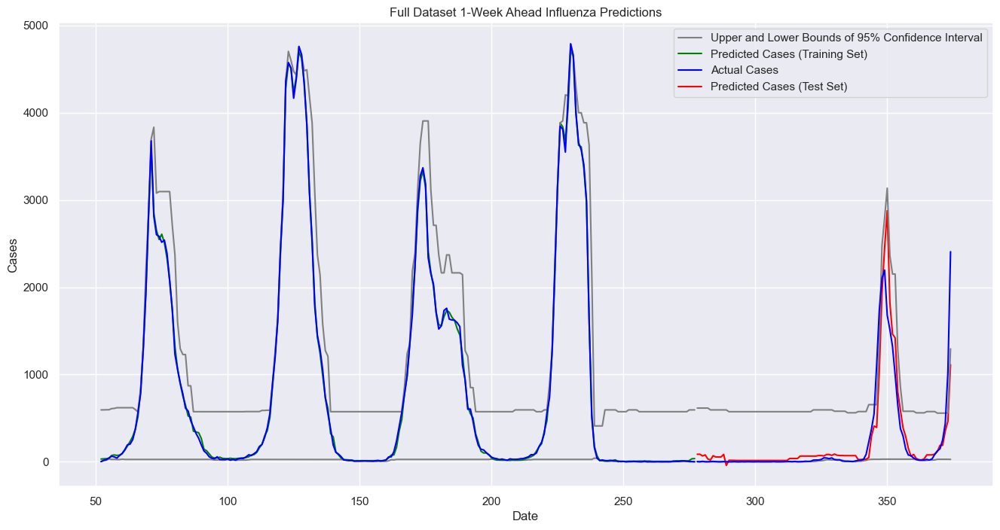

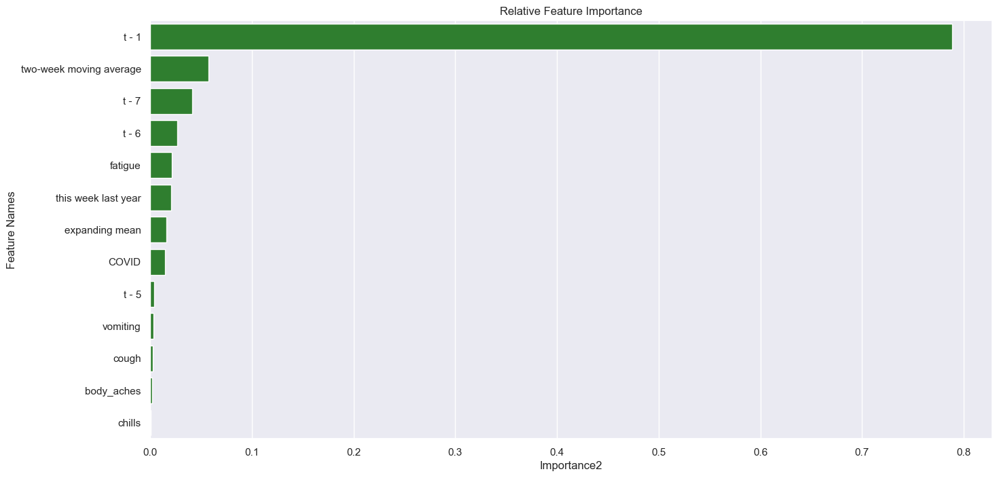

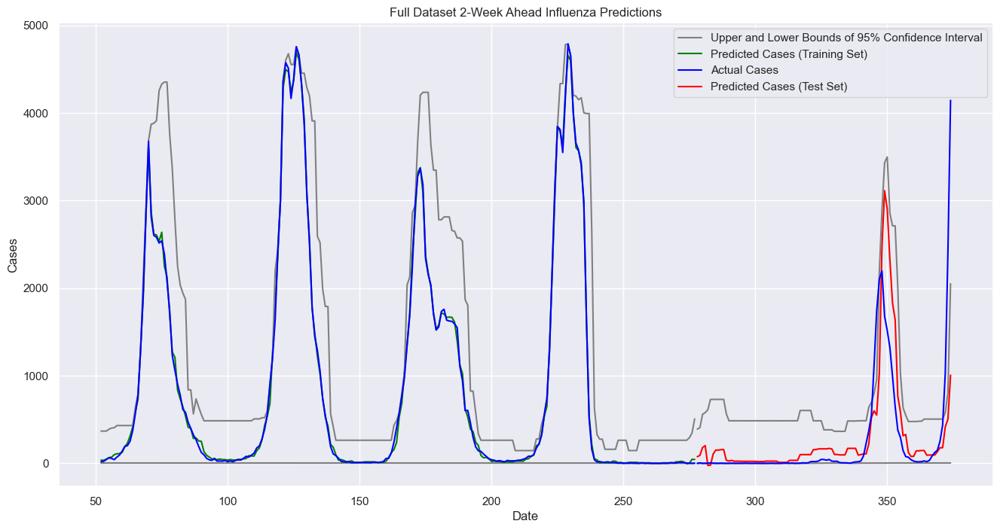

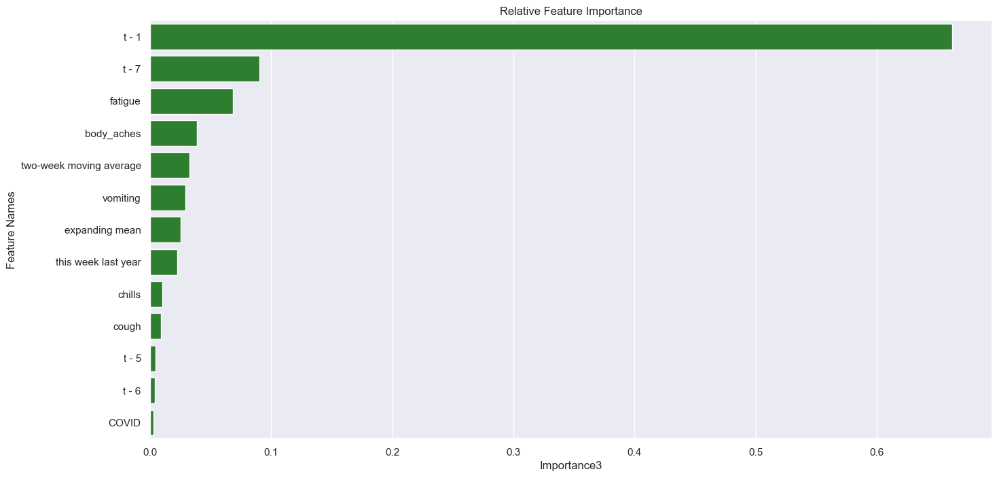

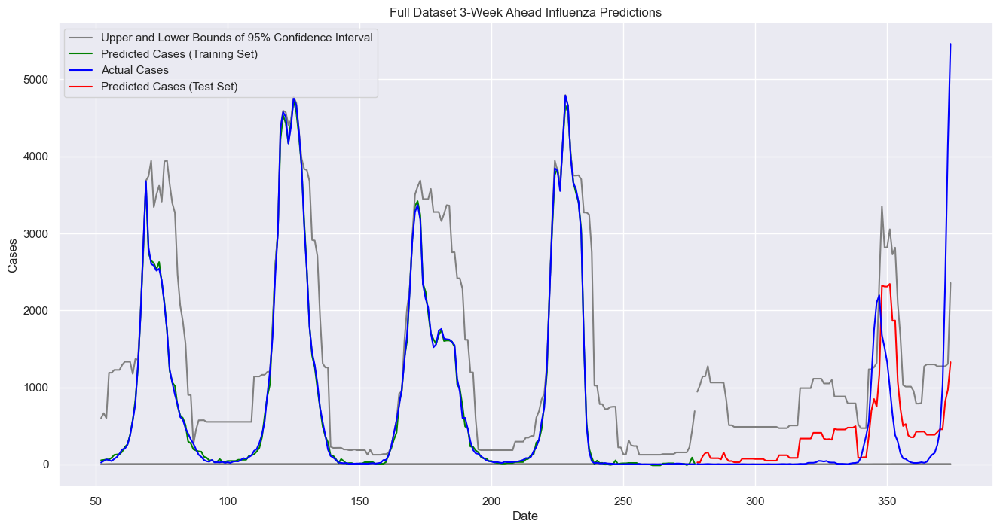

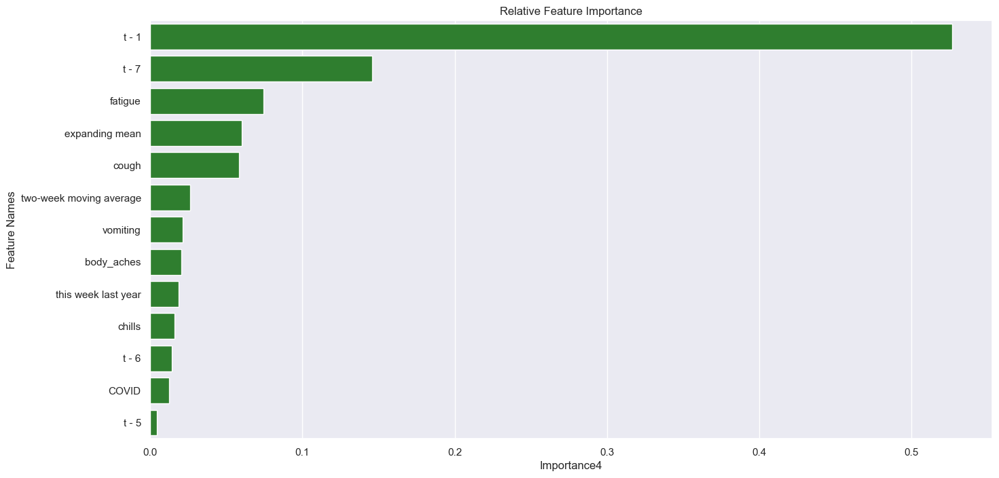

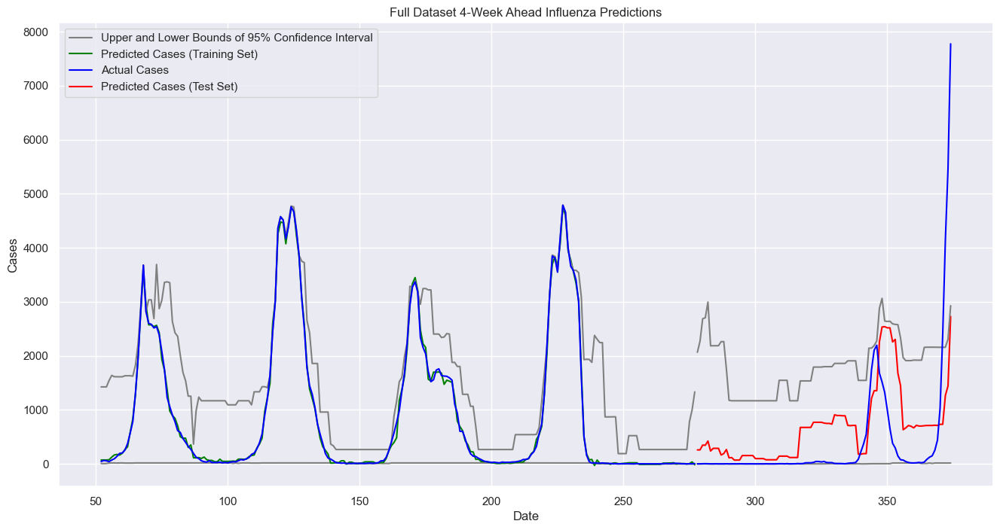

In [235]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [236]:
feature_to_drop

't - 5'

In [237]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3535.91,995133.46,59.46,997.56,40.75,625.25,0.99798,0.210089
0,Gradient Boost,Full Dataset,1,1342.05,52843.56,36.63,229.88,24.98,100.23,0.999233,0.797502
0,Gradient Boost,Full Dataset,2,2185.39,252327.18,46.75,502.32,31.49,222.99,0.998751,0.396302
0,Gradient Boost,Full Dataset,3,2126.18,492459.62,46.11,701.75,32.08,389.19,0.998785,0.28972


In [238]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features, df_flu_symptoms, df_COVID_terms, ]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['Total Cases','week','year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4','diarrhea','t - 2','t - 5'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4','season','vaccine','quarantine','social_distancing','coronavirus','headache','mask','lockdown','sore_thoat','runny_nose','flu','t - 3','fever','t - 4','diarrhea','t - 2','t - 5'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

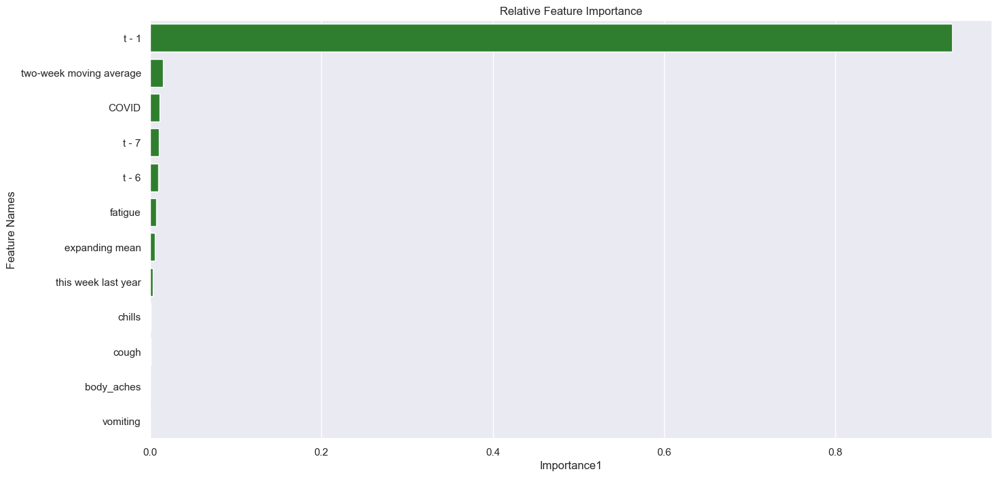

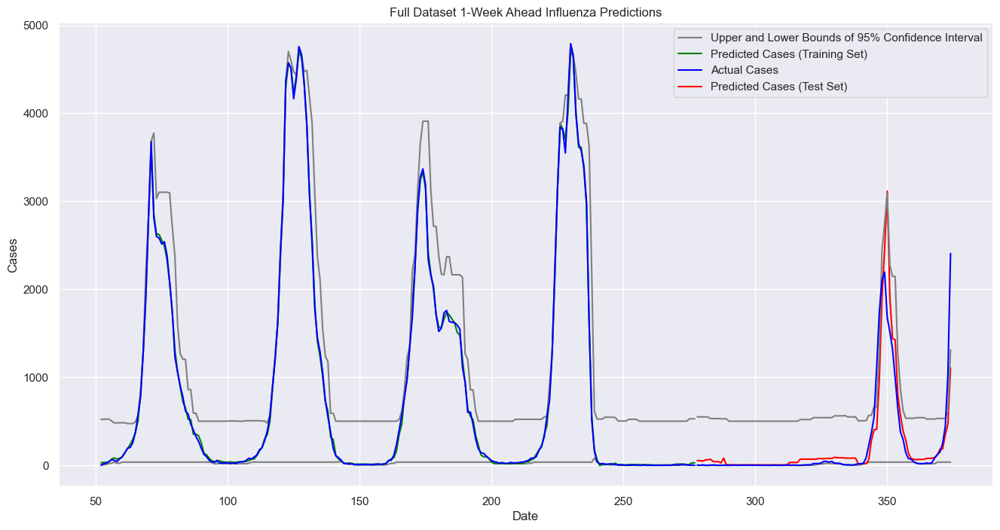

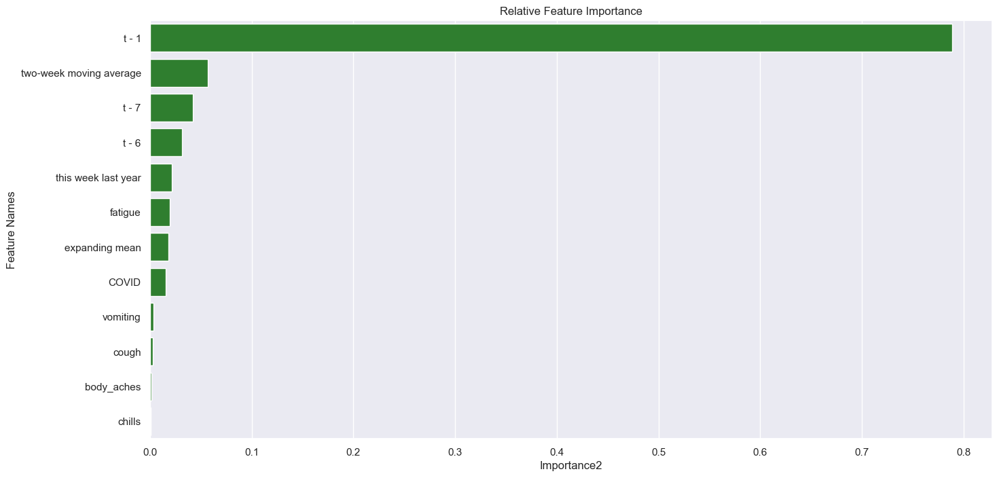

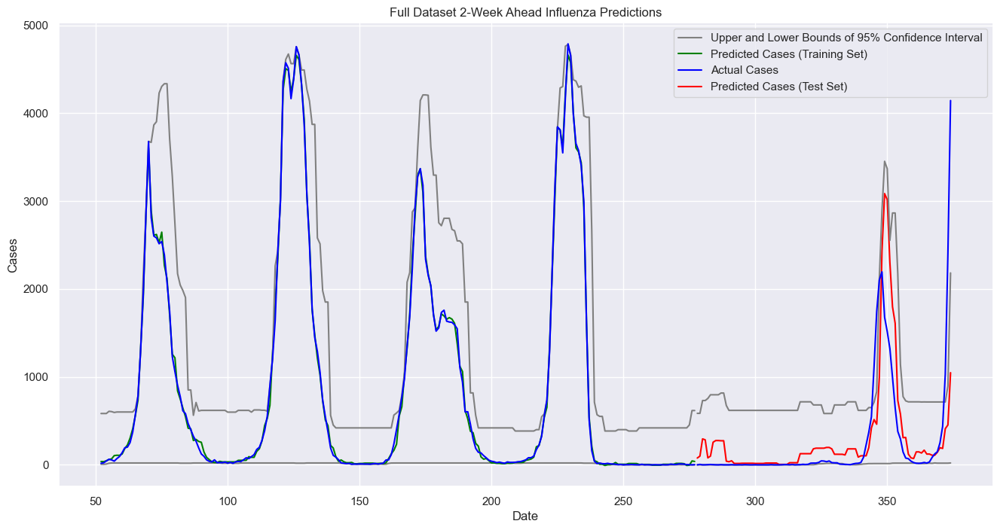

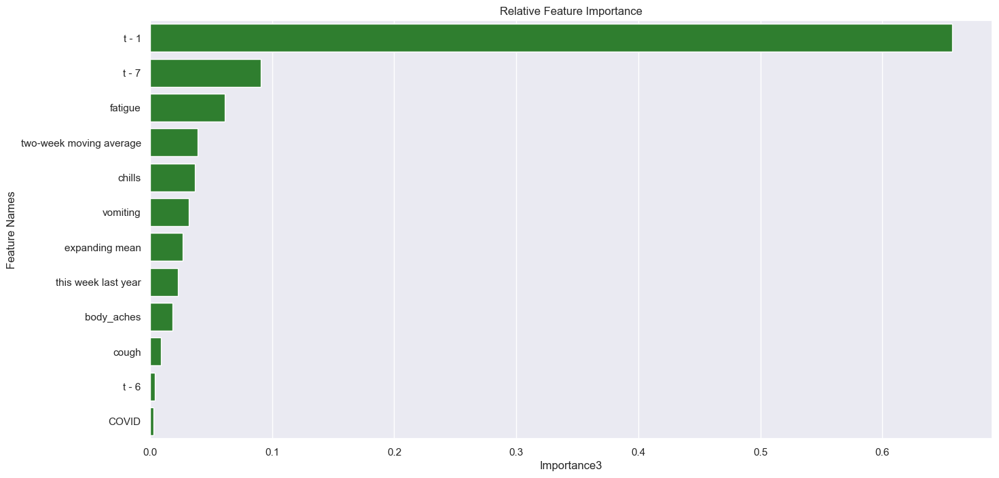

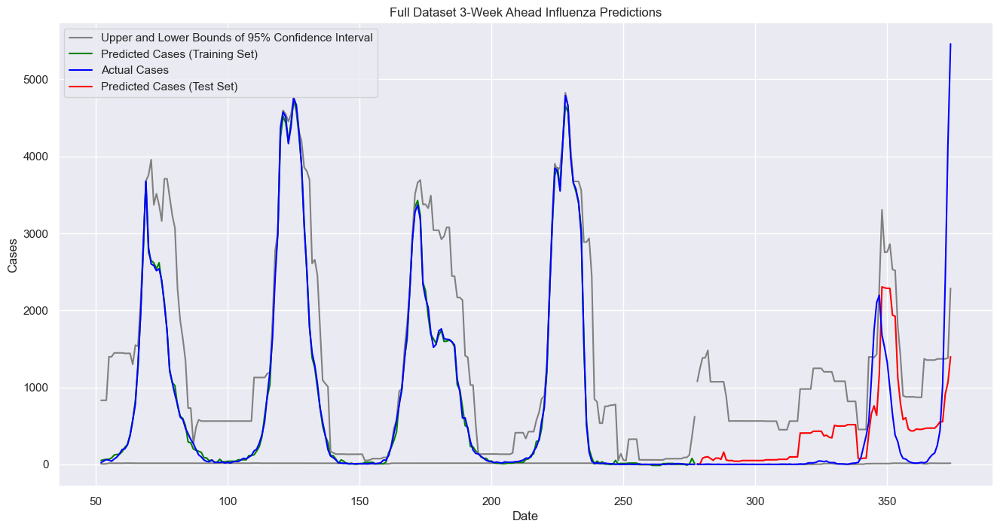

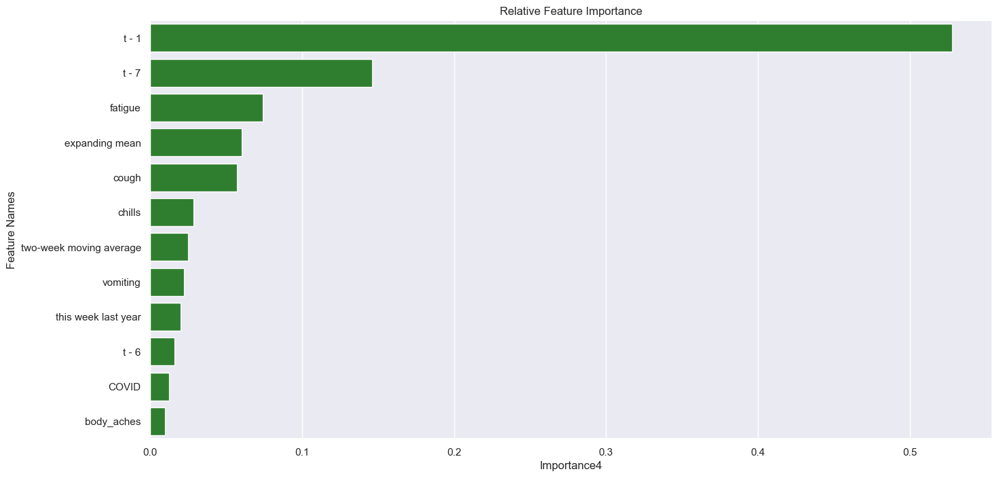

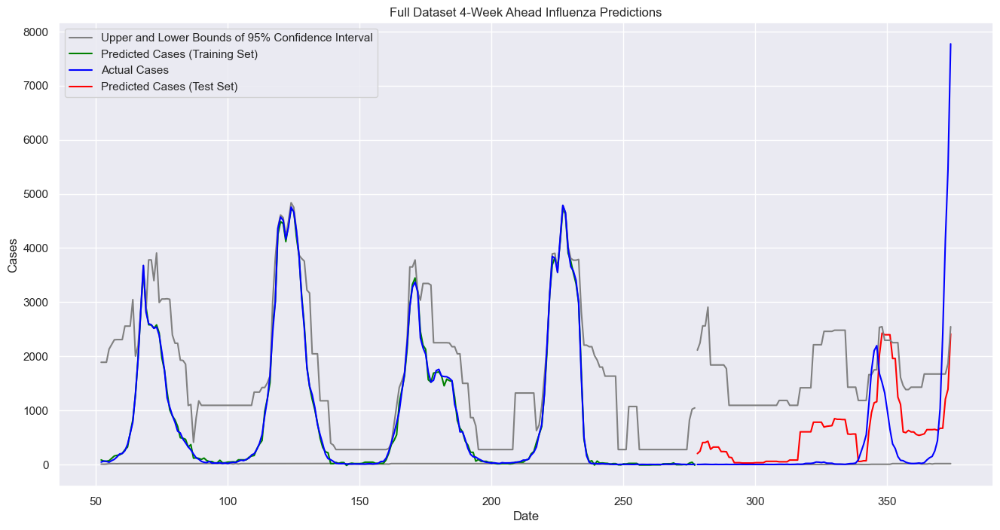

In [239]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [240]:
feature_to_drop

'body_aches'

In [241]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3688.87,968245.6,60.74,983.99,41.87,630.37,0.997893,0.231432
0,Gradient Boost,Full Dataset,1,1432.65,60951.99,37.85,246.88,25.68,102.89,0.999181,0.766431
0,Gradient Boost,Full Dataset,2,2321.54,261364.12,48.18,511.24,31.62,239.48,0.998674,0.374681
0,Gradient Boost,Full Dataset,3,2088.1,498975.48,45.7,706.38,32.01,405.76,0.998807,0.280323


# Best Model - Full Dataset

In [118]:
# get data
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))
df = df_time_features.drop(columns=['year','month'])

# get dataframe for plotting dates
df_to_plot = df.dropna()

# last row to make prediction on
df_to_predict = df.iloc[-1,5:]
df_to_predict = pd.DataFrame(df_to_predict).T
df_to_plot

# drop nulls and date to prepare for modelling
df = df.drop(columns='Week Ending').dropna()

# train/test split
train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# features = train_X.columns

In [145]:
# set up pipeline
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

lower_model = GradientBoostingRegressor(loss="quantile", alpha=LOWER_ALPHA,random_state=2023)
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile", alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', mid_model),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

In [146]:
time_test = df_to_plot[train_size:len(df)]['Week Ending']
time_train = df_to_plot[0:train_size]['Week Ending']

In [50]:
time_test

278   2021-01-02
279   2021-01-09
280   2021-01-16
281   2021-01-23
282   2021-01-30
         ...    
370   2022-10-08
371   2022-10-15
372   2022-10-22
373   2022-10-29
374   2022-11-05
Name: Week Ending, Length: 97, dtype: datetime64[ns]

In [51]:
time_train

52    2016-09-03
53    2016-09-10
54    2016-09-17
55    2016-09-24
56    2016-10-01
         ...    
273   2020-11-28
274   2020-12-05
275   2020-12-12
276   2020-12-19
277   2020-12-26
Name: Week Ending, Length: 226, dtype: datetime64[ns]

In [39]:
x.shape

(97,)

In [37]:
predictions_test['mid'].shape

(97,)

In [42]:
df_to_plot['Week Ending']

52    2016-09-03
53    2016-09-10
54    2016-09-17
55    2016-09-24
56    2016-10-01
         ...    
370   2022-10-08
371   2022-10-15
372   2022-10-22
373   2022-10-29
374   2022-11-05
Name: Week Ending, Length: 323, dtype: datetime64[ns]

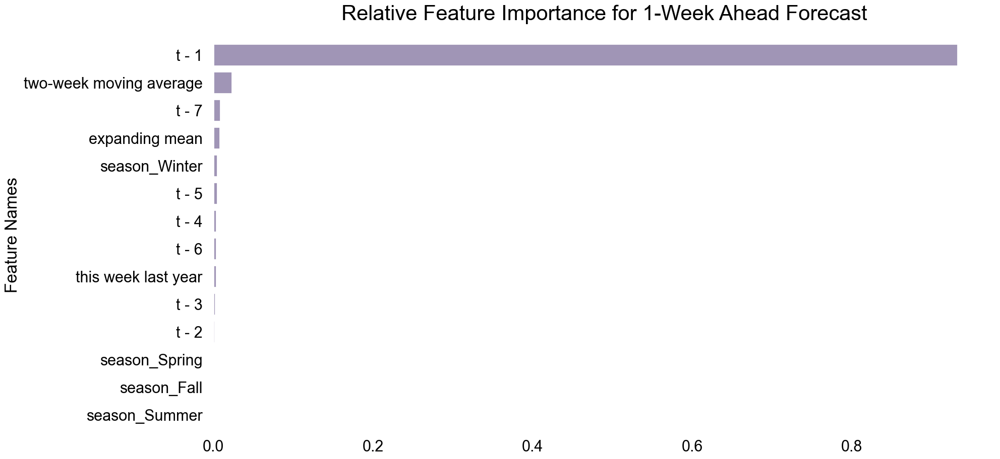

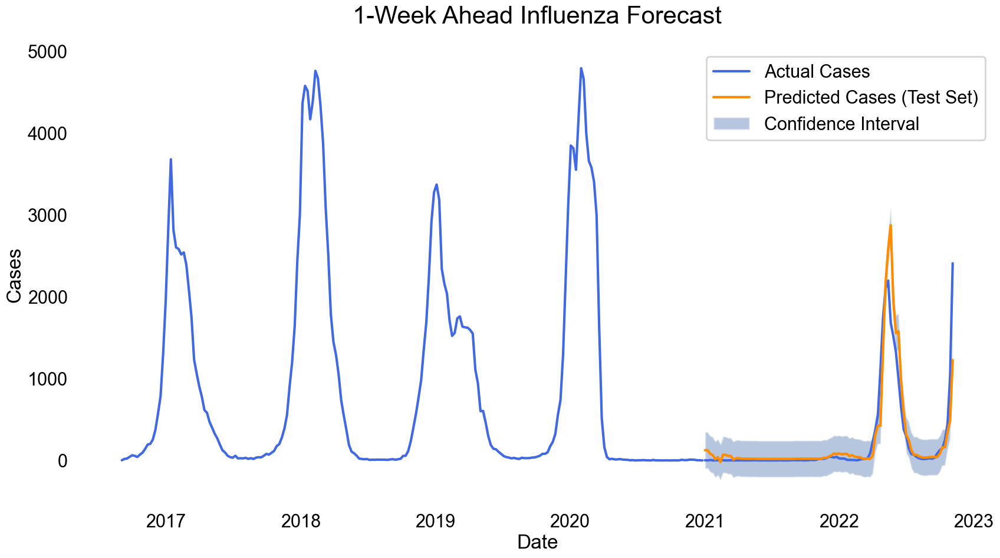

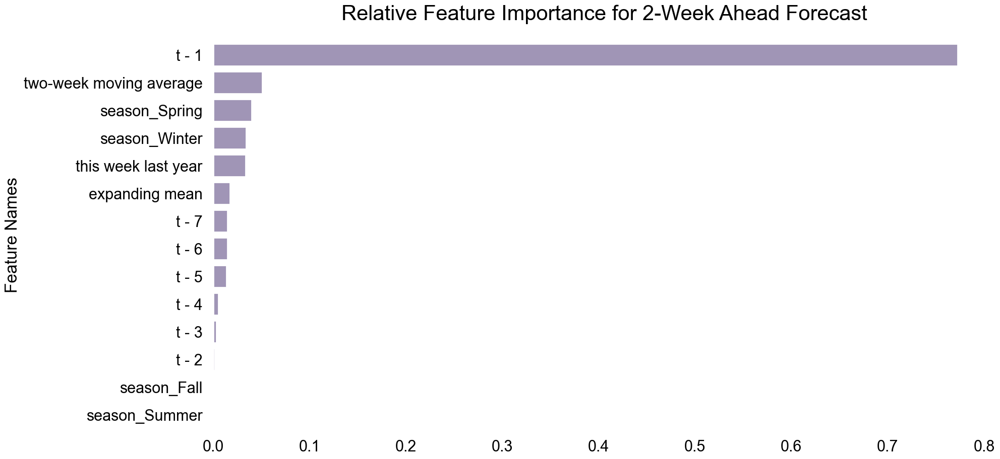

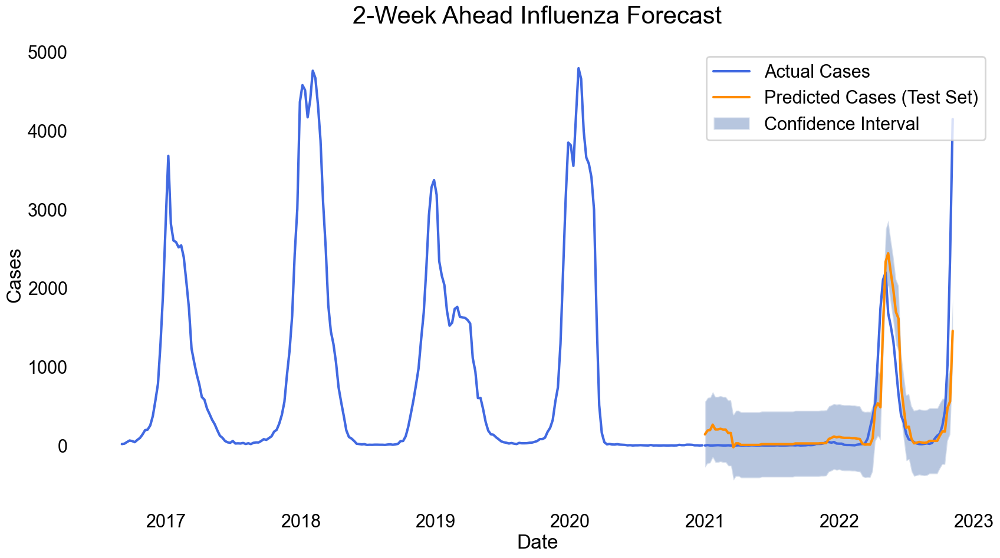

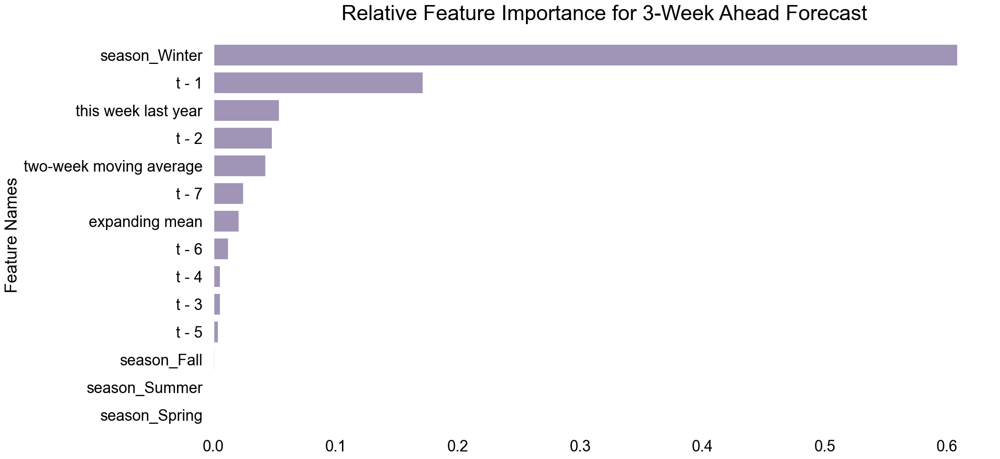

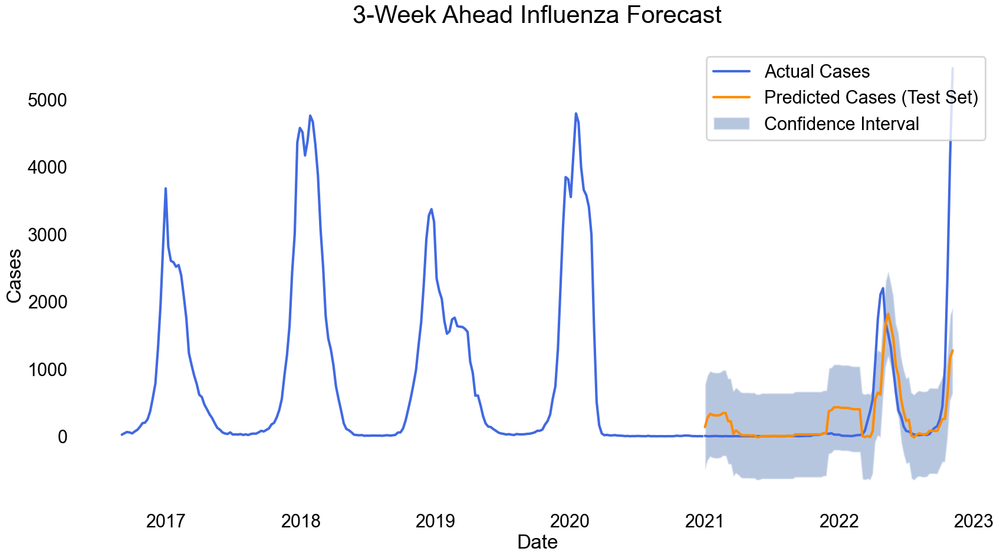

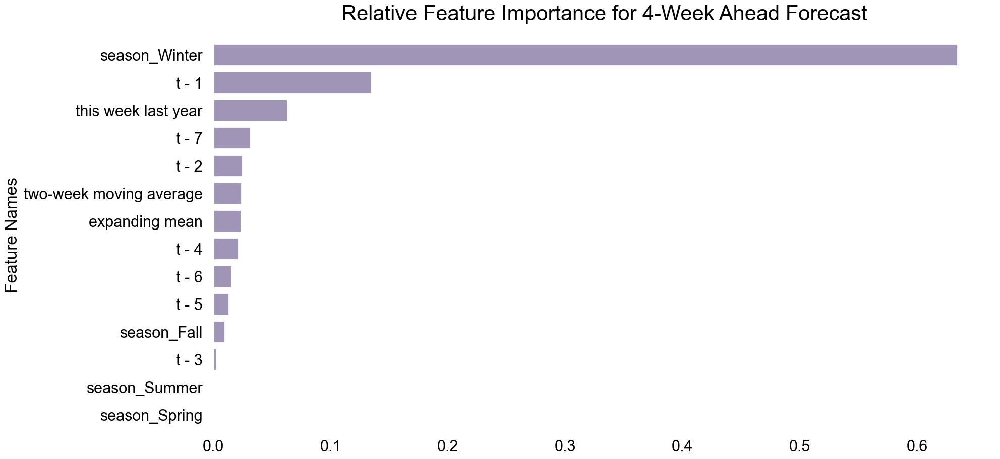

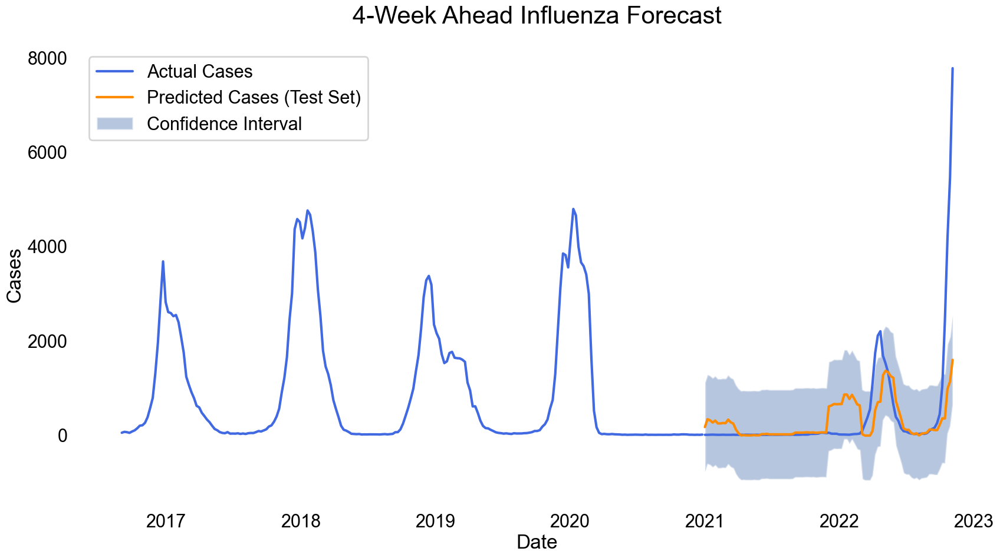

In [57]:
# fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train_y=train_y[week], test_y=test_y[week], preds_train=predictions_train['mid'], preds_test=predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    RMSE_test = round(mean_squared_error(test_y[week], predictions_test['mid'], squared=False),2)

    # get feature importances from the model (referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline)
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Feature Importance'

    df = pd.DataFrame({'Feature Names':names,col_name:importance})
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')

    # plot feature importances
    fig, ax = plt.subplots()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='mediumpurple', saturation=0.3)
    ax.set_title(f'Relative Feature Importance for {str(w)}-Week Ahead Forecast', fontsize= 30, pad=30)
    ax.set(xlabel=None)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    
    # plt.plot(predictions_train['lower'], color='grey', label='95% Confidence Interval')
    # plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    # plt.plot(predictions_train['upper'], color='grey')
    # ax.plot(predictions_test['lower'], color='grey')
    # ax.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    # ax.plot(predictions_test['upper'], color='grey')
    # ax.fill_between(x=df.index, y1=predictions_test['lower'], y2=predictions_test['upper'])

    # plot forecast
    fig, ax = plt.subplots()
    ax.plot(time_train, predictions_train['actual'], color='royalblue', label='Actual Cases')
    ax.plot(time_test, predictions_test['actual'], color='royalblue')
    ax.plot(time_test, predictions_test['mid'], '-', label='Predicted Cases (Test Set)', color='darkorange')
    ax.fill_between(time_test, predictions_test['mid'] - RMSE_test, predictions_test['mid'] + RMSE_test, alpha=0.4, label='Confidence Interval')
    
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

    ax.set_title(f'{w}-Week Ahead Influenza Forecast', fontsize= 30, pad=30)
    ax.set_xlabel('Date')
    ax.set_ylabel('Cases')
    ax.legend()

# from functools import reduce
# df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

# df_merged = df_merged.set_index('Feature Names')
# df_merged['mean importance'] = df_merged.mean(axis = 1)
# df_merged = df_merged.sort_values(by='mean importance')
# feature_to_drop = df_merged.iloc[0].name

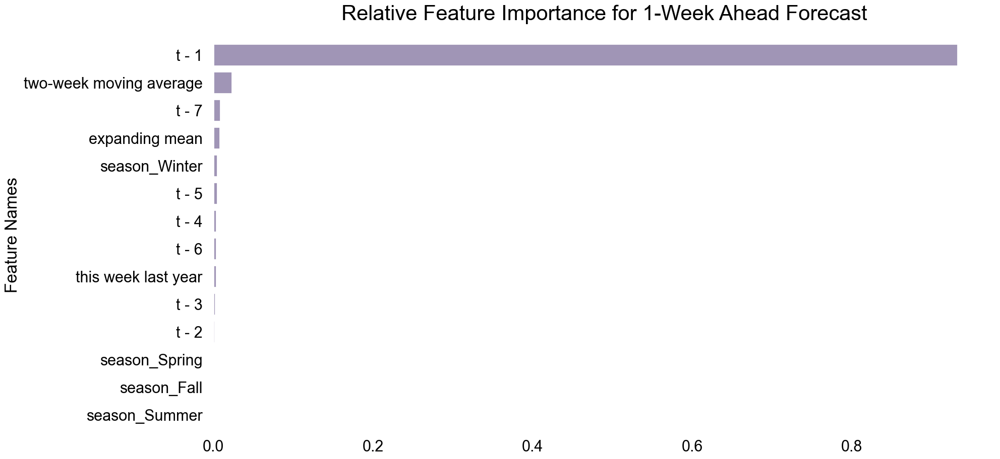

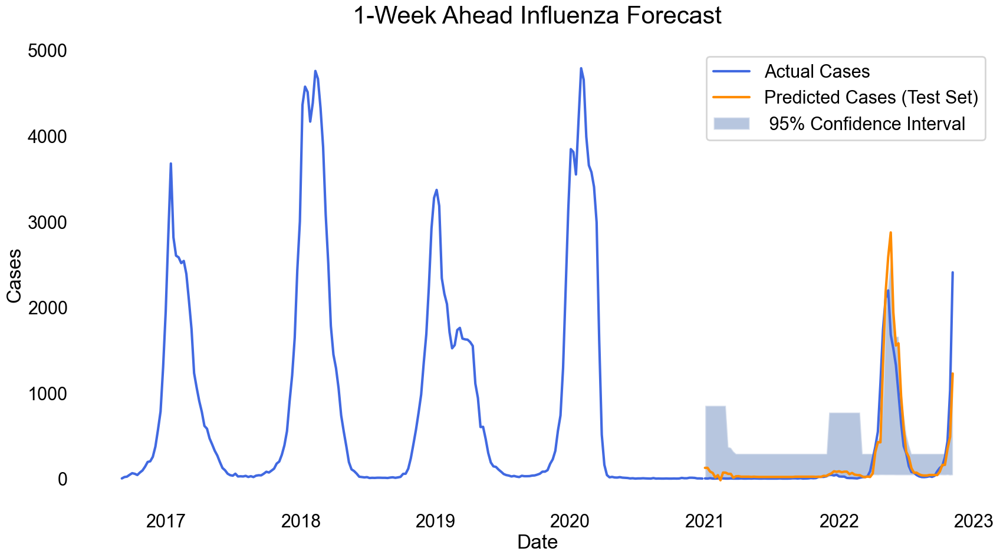

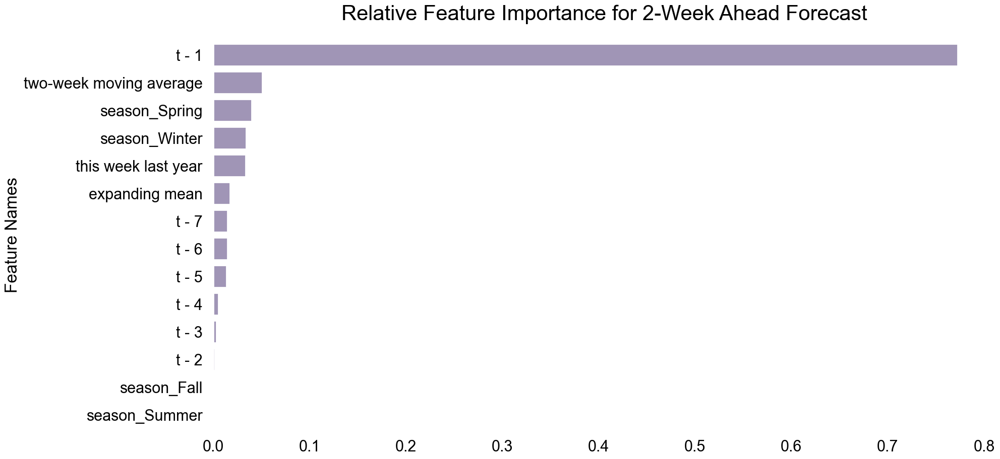

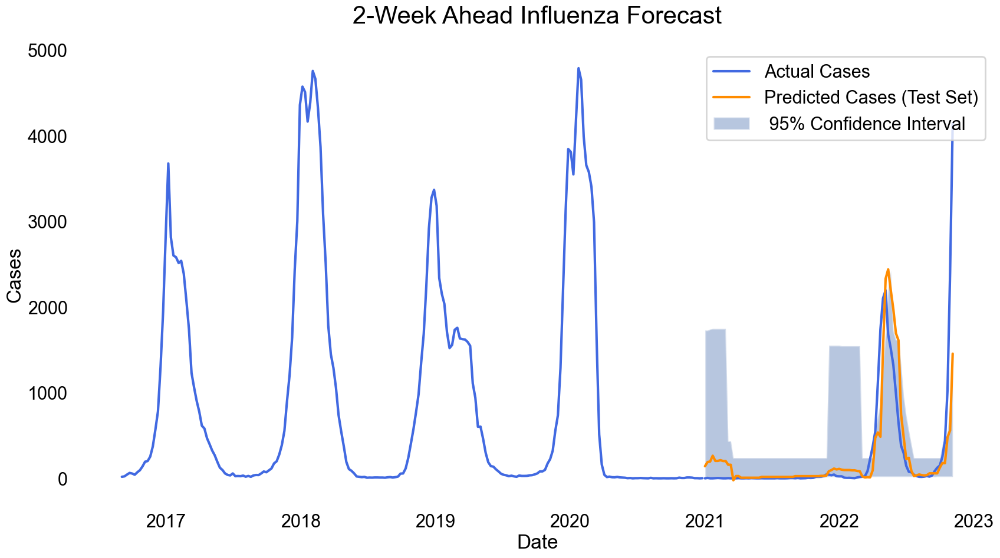

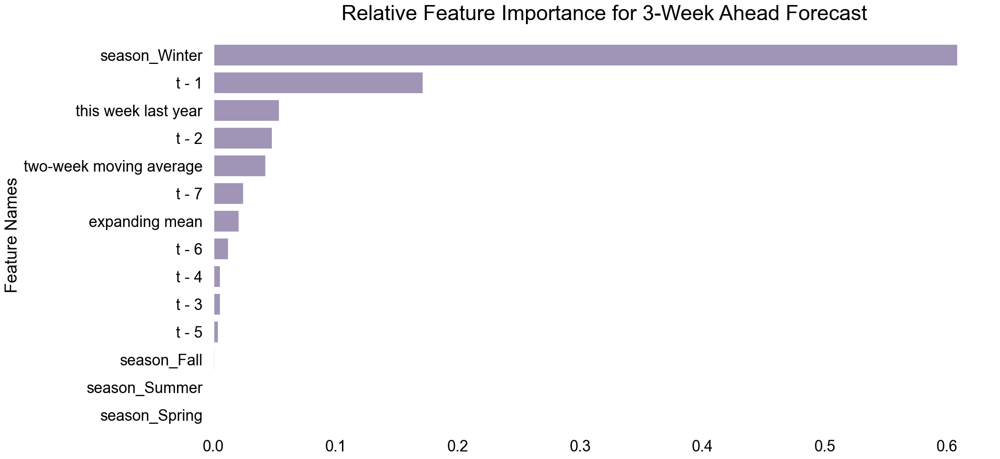

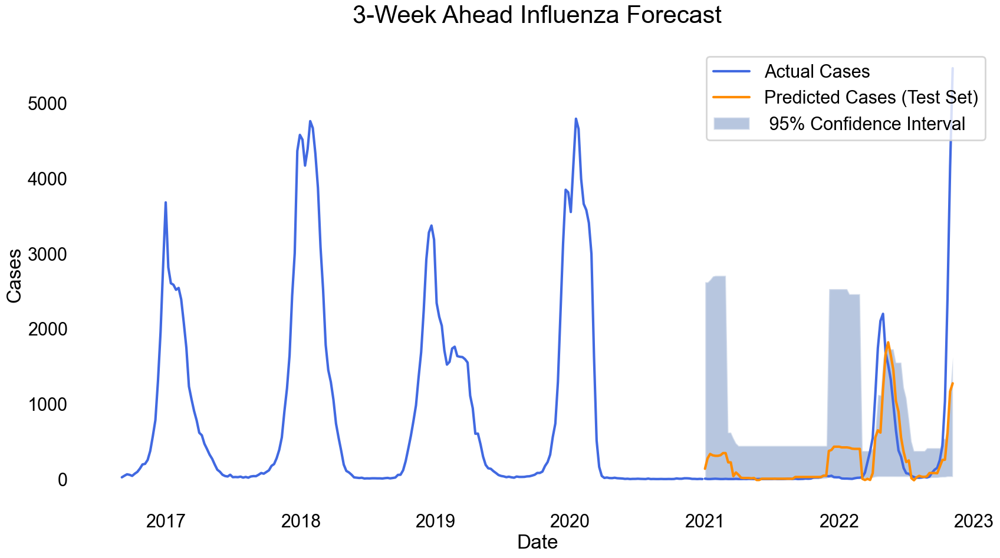

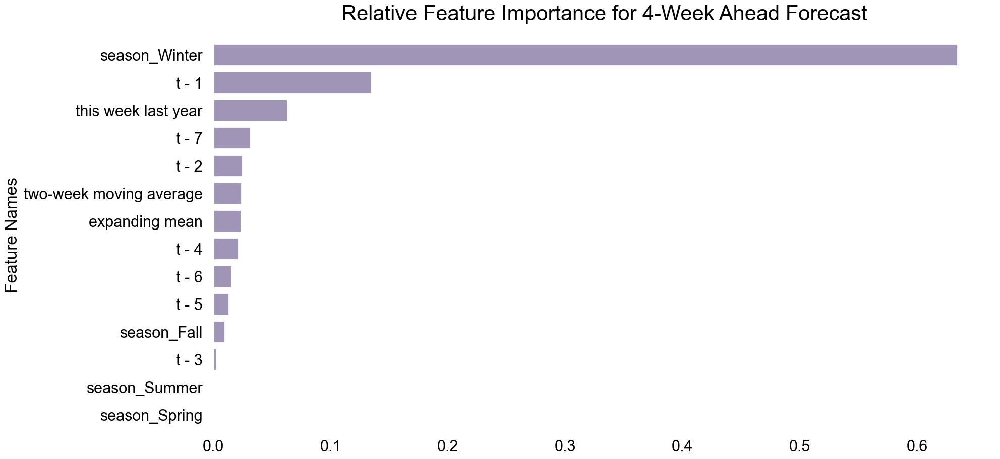

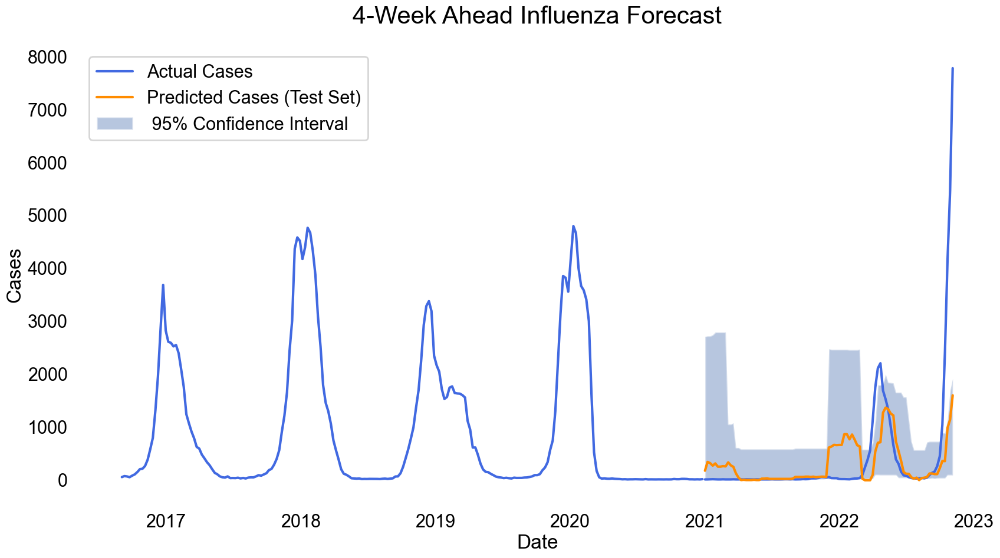

In [147]:
# fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train_y=train_y[week], test_y=test_y[week], preds_train=predictions_train['mid'], preds_test=predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model (referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline)
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()
    col_name = 'Feature Importance'
    df = pd.DataFrame({'Feature Names':names,col_name:importance})
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')

    # plot feature importances
    fig, ax = plt.subplots()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='mediumpurple', saturation=0.3)
    ax.set_title(f'Relative Feature Importance for {str(w)}-Week Ahead Forecast', fontsize= 30, pad=30)
    ax.set(xlabel=None)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    
    # plot forecast with 95% confidence interval
    fig, ax = plt.subplots()
    ax.plot(time_train, predictions_train['actual'], color='royalblue', label='Actual Cases')
    ax.plot(time_test, predictions_test['actual'], color='royalblue')
    ax.plot(time_test, predictions_test['mid'], '-', label='Predicted Cases (Test Set)', color='darkorange')
    ax.fill_between(time_test, predictions_test['lower'], predictions_test['upper'], alpha=0.4, label=' 95% Confidence Interval')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.set_title(f'{w}-Week Ahead Influenza Forecast', fontsize= 30, pad=30)
    ax.set_xlabel('Date')
    ax.set_ylabel('Cases')
    ax.legend()

In [108]:
crossval_count = 1000
min_size = 100
max_random = len(train_X) - (min_size)

crossval_resids = []

for b in range(crossval_count):
    start, end = [min_size*i+x for i, x in enumerate(sorted([np.random.randint(max_random) for y in range(2)]))]

    # set up pipeline
    numeric_transform = Pipeline([('scaling', MinMaxScaler())])
    categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

    ct = make_column_transformer(
    (categorical_transform, cat_feats),
    (numeric_transform, num_feats),   
    remainder='drop')

    # instantiate model
    mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
    pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
    ('mid_model', mid_model),
    ])

    # fit and predict
    test_index = np.random.randint(0,97,1000)

    pipeline_mid.fit(train_X[start:end], train_y[start:end]['y1'])
    pred = pipeline_mid.predict(pd.DataFrame(test_X.iloc[test_index[b]]).T)

    # calcuate residual
    crossval_resids.append(pred - test_y.iloc[test_index[b]]['y1'])
    
bsed_residuals = sorted(crossval_resids)

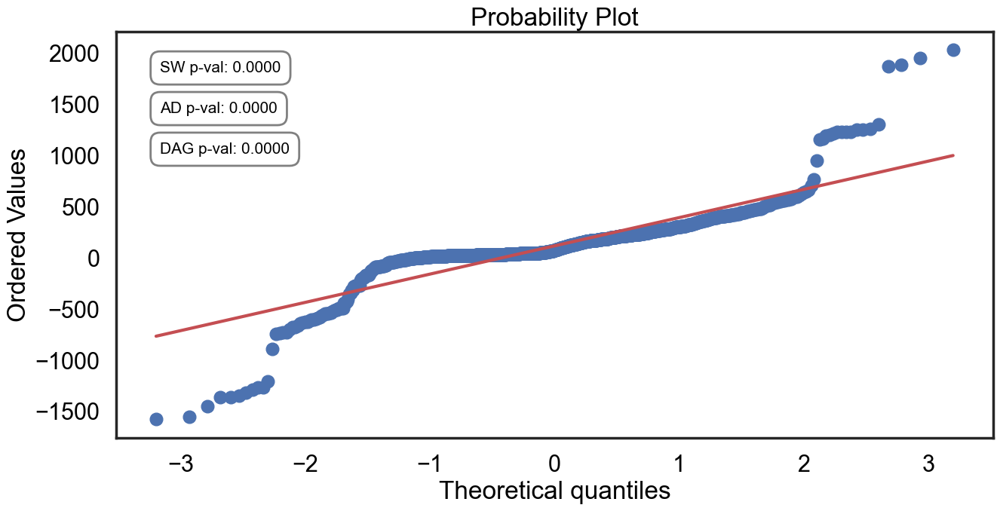

In [117]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.stats.diagnostic import normal_ad
from scipy import stats
from sklearn import metrics

sw_result = stats.shapiro(bsed_residuals)
ad_result = normal_ad(np.array(bsed_residuals), axis=0)
dag_result = stats.normaltest(bsed_residuals, axis=0, nan_policy='propagate')

plt.figure(figsize=(15,7))
res = stats.probplot(bsed_residuals, plot=plt)
ax = plt.gca()
ax.annotate("SW p-val: {:.4f}".format(sw_result[1]), xy=(0.05,0.9), xycoords='axes fraction', fontsize=15,
            bbox=dict(boxstyle="round", fc="none", ec="gray", pad=0.6))
ax.annotate("AD p-val: {:.4f}".format(ad_result[1]), xy=(0.05,0.8), xycoords='axes fraction', fontsize=15,
            bbox=dict(boxstyle="round", fc="none", ec="gray", pad=0.6))
ax.annotate("DAG p-val: {:.4f}".format(dag_result[1]), xy=(0.05,0.7), xycoords='axes fraction', fontsize=15,
            bbox=dict(boxstyle="round", fc="none", ec="gray", pad=0.6))

plt.show()

Median of Bootstrapped STD's: 312.4718


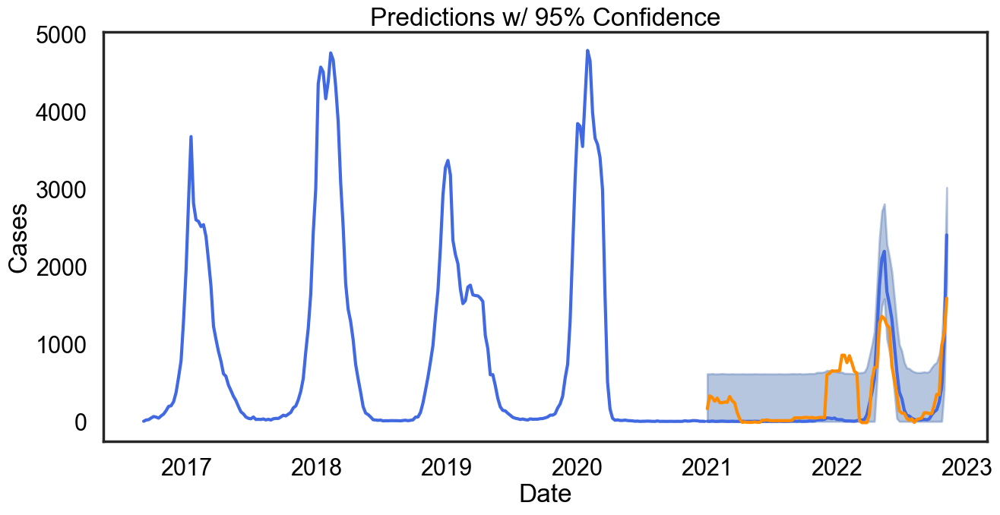

In [148]:
bs_stds=[]
last_std = None

for i in range(10000):
    samples = [bsed_residuals[np.random.randint(len(bsed_residuals))] for x in range(len(bsed_residuals))]
    bs_stds.append(np.std(samples))
    if i%500 == 0 and i!=0:
        if i == 500:
            last_std = np.median(bs_stds)
        else:
            current_std = np.median(bs_stds)
            if abs(current_std - last_std) < last_std*0.00001:
                print("Early Stopping Iteration: {}".format(i))
                break
            else:
                last_std = np.median(bs_stds)        
    
bs_std = np.median(bs_stds)
print("Median of Bootstrapped STD's: {:.4f}".format(bs_std))

bs_band_size = 1.96*bs_std

    # Record actual values on test set
predictions_test = pd.DataFrame(test_y['y1'])
predictions_test = predictions_test.rename(columns={'y1':'actual'})
predictions_train = pd.DataFrame(train_y['y1'])
predictions_train = predictions_train.rename(columns={'y1':'actual'})

predictions_test['mid'] = pipeline_mid.predict(test_X)

fig, ax = plt.subplots()
ax.plot(time_train, predictions_train['actual'], color='royalblue', label='Actual Cases')
ax.plot(time_test, predictions_test['actual'], color='royalblue')
ax.plot(time_test, predictions_test['mid'], color='darkorange')

predictions_test['lower_band'] = predictions_test['actual']-bs_band_size
predictions_test['lower_band_zero'] = predictions_test['lower_band'].apply(lambda x: 0 if x < 0 else x)
ax.fill_between(time_test, predictions_test['lower_band_zero'], (predictions_test['actual']+bs_band_size), color='b', alpha=.4)
ax.set_title("Predictions w/ 95% Confidence")
ax.set_xlabel('Date')
ax.set_ylabel('Cases')
plt.show()

In [141]:
predictions_test

,actual,lower_band,lower_band_zero
278,2.0,-610.406013,0.000000
279,0.0,-612.406013,0.000000
280,5.0,-607.406013,0.000000
281,0.0,-612.406013,0.000000
282,0.0,-612.406013,0.000000
...,...,...,...
370,149.0,-463.406013,0.000000
371,251.0,-361.406013,0.000000
372,438.0,-174.406013,0.000000
373,1031.0,418.593987,418.593987


In [ ]:
# ax.plot(time_train, predictions_train['actual'], color='royalblue', label='Actual Cases')
#     ax.plot(time_test, predictions_test['actual'], color='royalblue')
#     ax.plot(time_test, predictions_test['mid'], '-', label='Predicted Cases (Test Set)', color='darkorange')
#     ax.fill_between(time_test, predictions_test['lower'], predictions_test['upper'], alpha=0.4, label=' 95% Confidence Interval')

# Best Model - Pre-COVID Dataset

In [20]:
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))
df_time_features.head()

,Week Ending,y1,y2,y3,y4,year,month,season,t - 1,t - 2,t - 3,t - 4,t - 5,t - 6,t - 7,this week last year,two-week moving average,expanding mean
0,2015-09-05,9.0,18.0,15.0,29.0,2015,9,Fall,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-09-12,18.0,15.0,29.0,59.0,2015,9,Fall,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.00
2,2015-09-19,15.0,29.0,59.0,50.0,2015,9,Fall,18.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,13.5,13.50
3,2015-09-26,29.0,59.0,50.0,37.0,2015,9,Fall,15.0,18.0,9.0,NaN,NaN,NaN,NaN,NaN,16.5,14.00
4,2015-10-03,59.0,50.0,37.0,26.0,2015,10,Fall,29.0,15.0,18.0,9.0,NaN,NaN,NaN,NaN,22.0,17.75


In [21]:
df_time_features_pre_COVID = df_time_features[df_time_features['Week Ending'] < pd.to_datetime('2020-03-01')]

In [22]:
df_time_features_pre_COVID.head()

,Week Ending,y1,y2,y3,y4,year,month,season,t - 1,t - 2,t - 3,t - 4,t - 5,t - 6,t - 7,this week last year,two-week moving average,expanding mean
0,2015-09-05,9.0,18.0,15.0,29.0,2015,9,Fall,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2015-09-12,18.0,15.0,29.0,59.0,2015,9,Fall,9.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.00
2,2015-09-19,15.0,29.0,59.0,50.0,2015,9,Fall,18.0,9.0,NaN,NaN,NaN,NaN,NaN,NaN,13.5,13.50
3,2015-09-26,29.0,59.0,50.0,37.0,2015,9,Fall,15.0,18.0,9.0,NaN,NaN,NaN,NaN,NaN,16.5,14.00
4,2015-10-03,59.0,50.0,37.0,26.0,2015,10,Fall,29.0,15.0,18.0,9.0,NaN,NaN,NaN,NaN,22.0,17.75


In [23]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
# df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
# df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))
df_time_features_pre_COVID = df_time_features[df_time_features['Week Ending'] < pd.to_datetime('2020-03-01')]

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features_pre_COVID]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

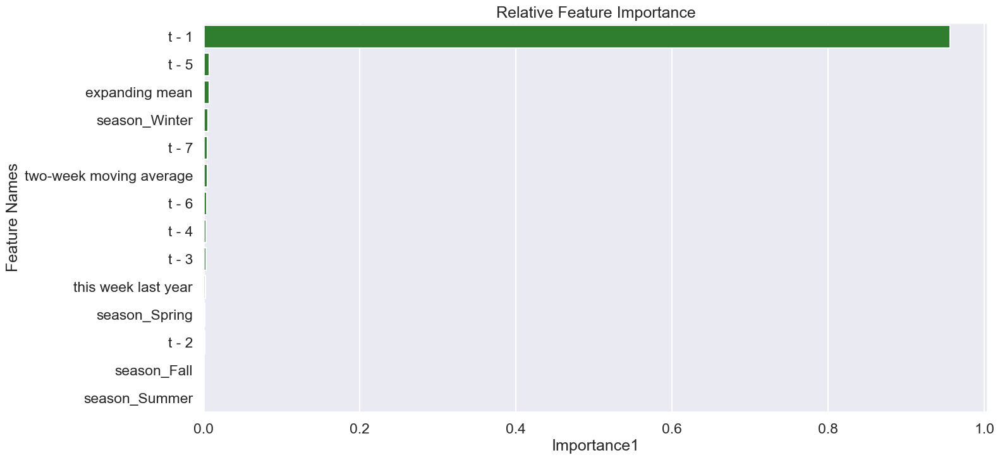

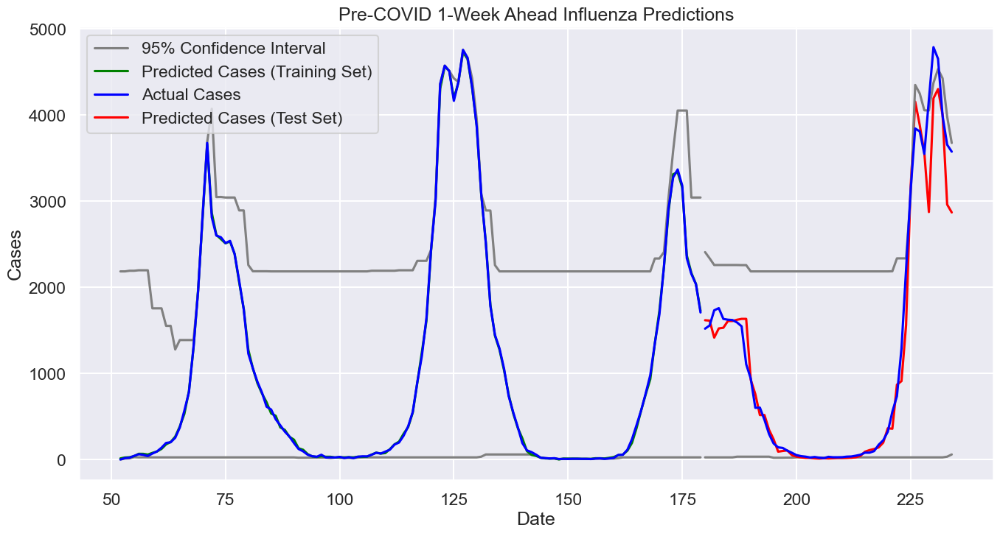

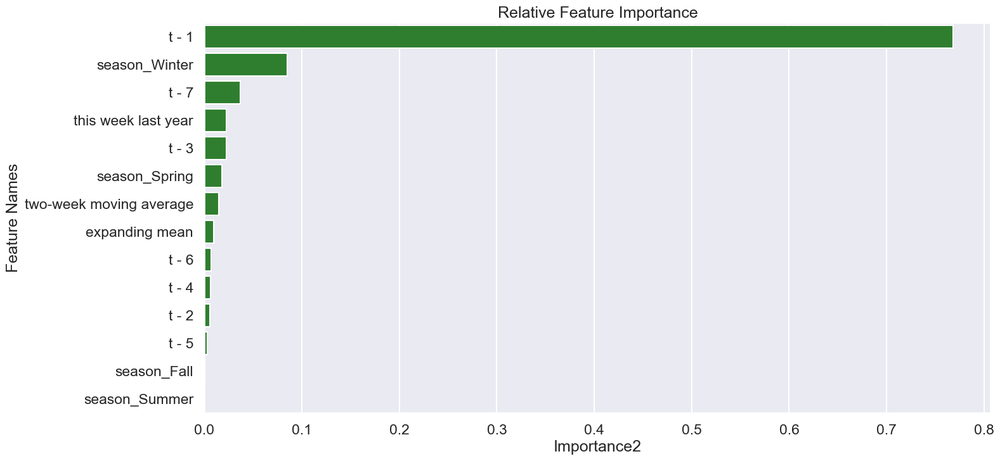

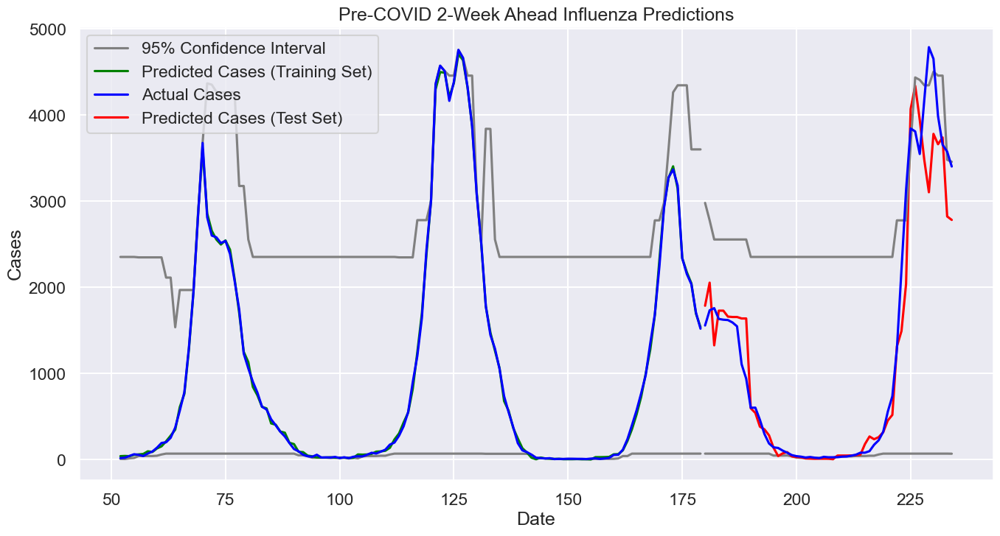

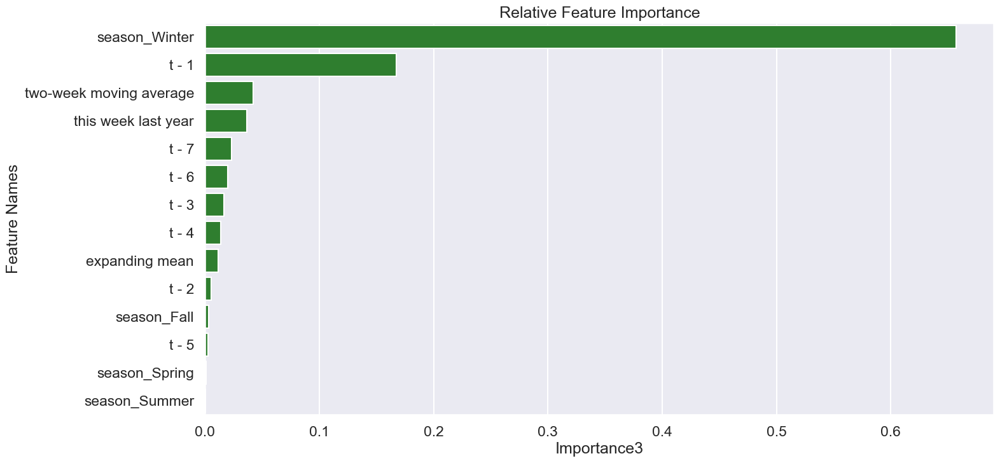

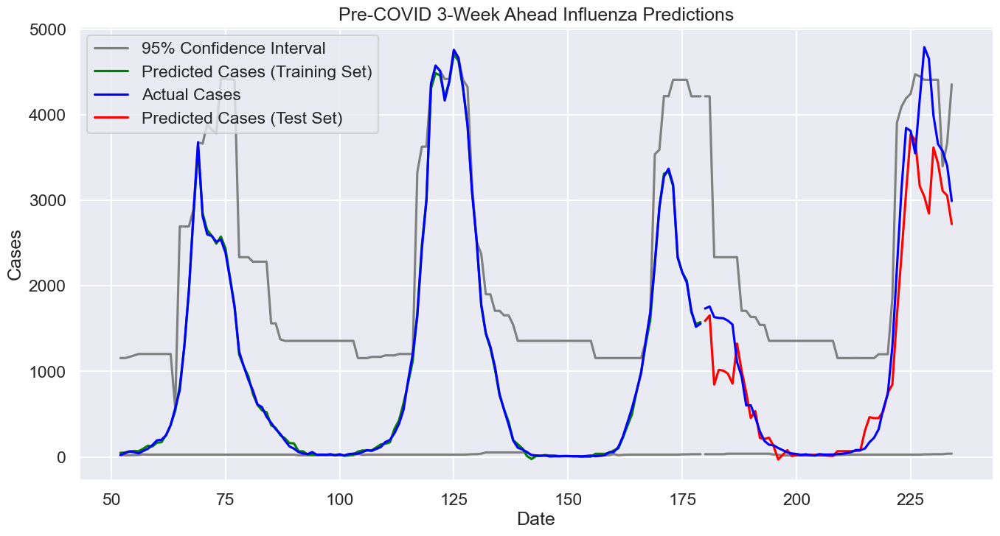

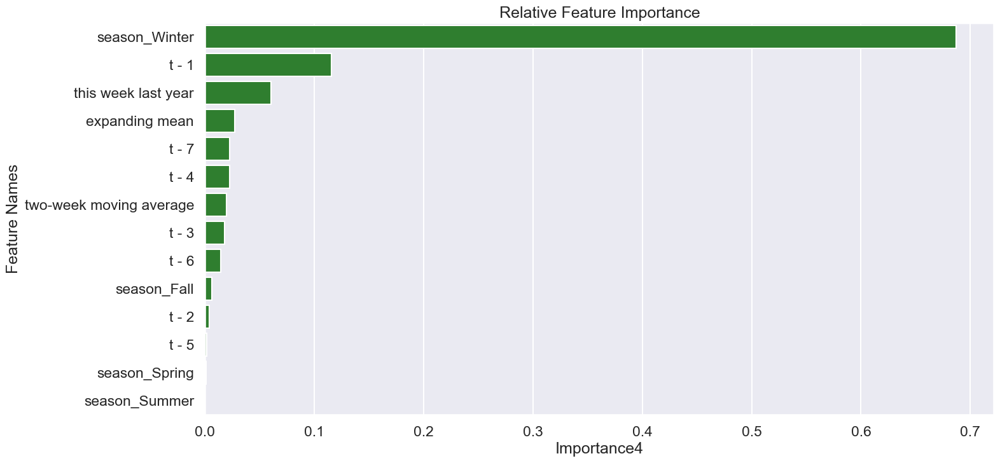

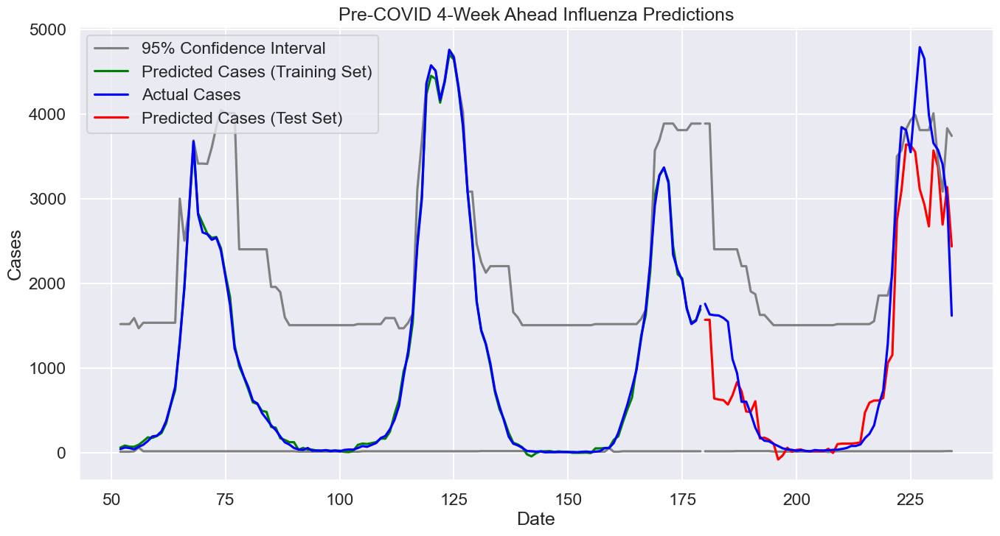

In [24]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Pre-COVID'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # get feature importances from the model
    # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    importance = pipeline_mid.steps[1][1].feature_importances_
    names = pipeline_mid[:-1].get_feature_names_out()

    col_name = 'Importance'+str(w)

    df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    df = df.sort_values(by=col_name, ascending = False)
    df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    df = df.drop(columns='dtype')
    plt.figure()
    sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # df = df.set_index('Feature Names')
    feature_impt_df.append(df)

    # Plot
    sns.set_context(context='talk')
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [26]:
results_matrix.tail(4)

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Pre-COVID,1,388.25,79993.53,19.7,282.83,13.99,141.93,0.999786,0.961476
0,Gradient Boost,Pre-COVID,2,886.22,156780.08,29.77,395.95,22.28,218.02,0.99951,0.927527
0,Gradient Boost,Pre-COVID,3,962.08,222475.26,31.02,471.67,23.91,267.53,0.999466,0.899697
0,Gradient Boost,Pre-COVID,4,1831.8,284066.83,42.8,532.98,31.35,310.84,0.998981,0.871822


In [ ]:
feature_to_drop

'season_Summer'

In [ ]:
results_matrix.tail(4)

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,1339.51,49564.44,36.6,222.63,24.41,94.66,0.999235,0.810068
0,Gradient Boost,Full Dataset,2,1935.01,175567.18,43.99,419.01,29.44,176.91,0.998894,0.579952
0,Gradient Boost,Full Dataset,3,3292.18,405786.83,57.38,637.01,38.64,280.15,0.998119,0.41473
0,Gradient Boost,Full Dataset,4,7869.58,897708.84,88.71,947.47,55.68,398.13,0.995505,0.287422


In [246]:
# df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
# df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
# df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

# df_air_travel = pickle.load(open(r"..\data\mobility\df_air_travel.pkl", "rb" ))
# df_urban_transit = pickle.load(open(r"..\data\mobility\df_urban_transit.pkl", "rb" ))
df_list = [df_time_features]
df = pd.concat(df_list, axis=1)
df = df.loc[:,~df.columns.duplicated()]
df = df.drop(columns=['year','month'])

# last row to make prediction on
df_to_predict = df.iloc[-1,4:]
df_to_predict = pd.DataFrame(df_to_predict).T

df_to_plot = df.dropna()

df = df.drop(columns='Week Ending').dropna()

train_size = int(len(df) *.7)
test_size = len(df) - train_size
train, test = df[0:train_size], df[train_size:len(df)]

train_y = train[['y1','y2','y3','y4']]
train_X = train.drop(columns=['y1','y2','y3','y4'])
test_y = test[['y1','y2','y3','y4']]
test_X = test.drop(columns=['y1','y2','y3','y4'])

cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
num_feats = list(train_X.drop(columns=cat_feats).columns)

# cat_feats = list(train_X[['month','season']].astype(str).columns)
# num_feats = list(train_X.drop(columns=['month','season']).columns)

features = train_X.columns

TypeError: reduce() of empty sequence with no initial value

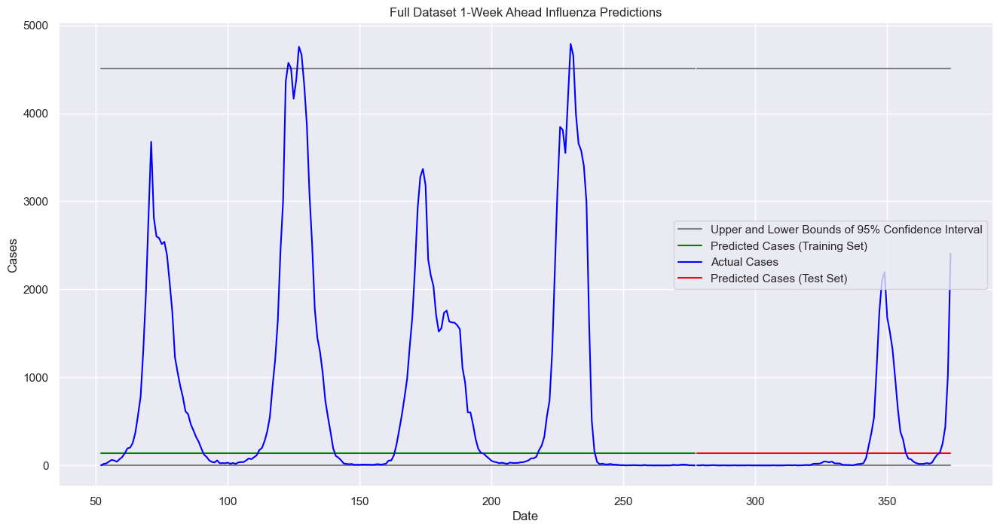

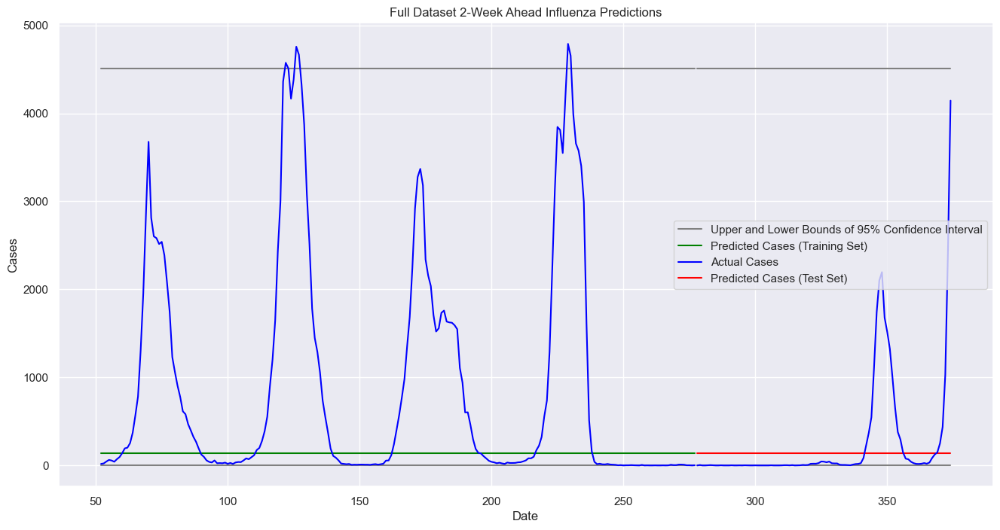

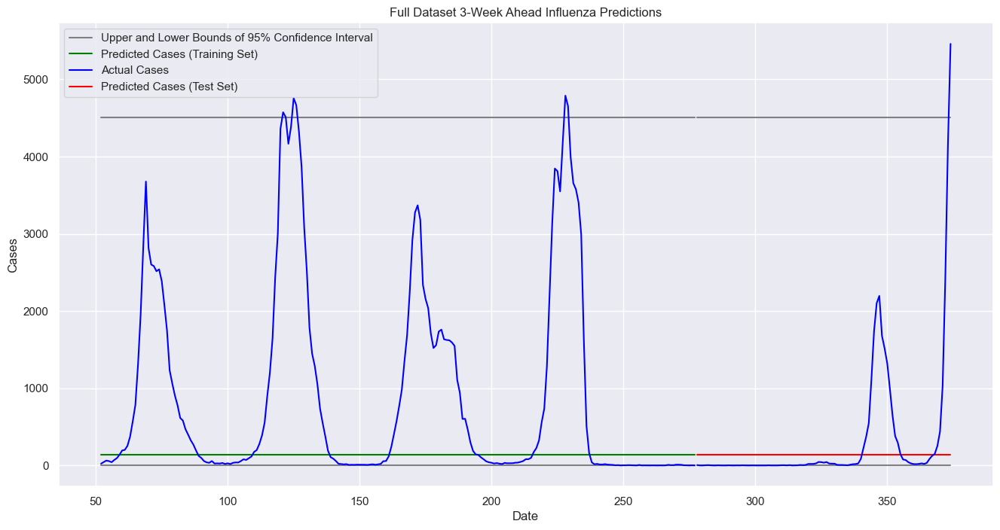

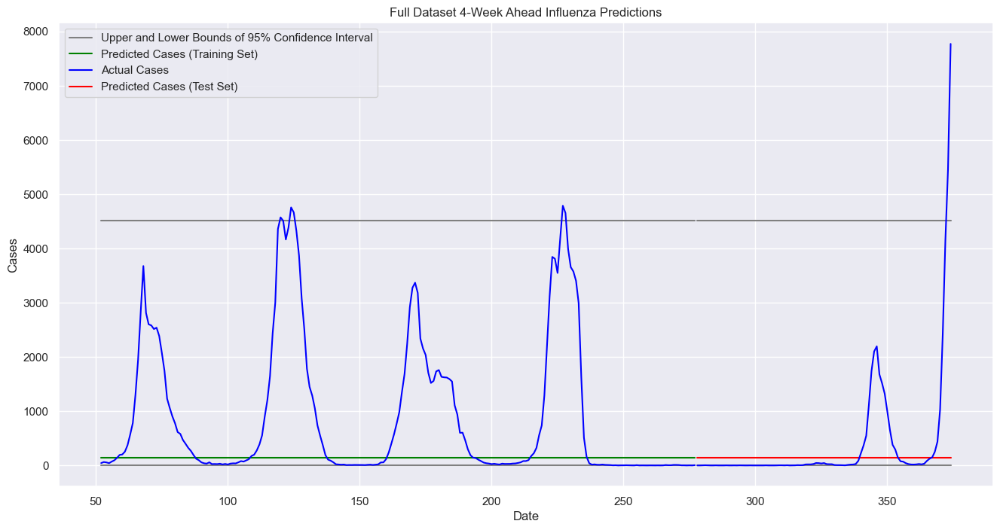

In [251]:
from sklearn.linear_model import QuantileRegressor

numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975

# Each model has to be separate
lower_model = QuantileRegressor(quantile=0.025)
# The mid model will use the default loss
mid_model = QuantileRegressor(quantile=0.5)
upper_model = QuantileRegressor(quantile=0.975)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', mid_model)
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
weeks = ['y1', 'y2', 'y3', 'y4']
feature_impt_df = []
for week in weeks:
    w = weeks.index(week) + 1

    pipeline_lower.fit(train_X, train_y[week])
    pipeline_mid.fit(train_X, train_y[week])
    pipeline_upper.fit(train_X, train_y[week])

    # Record actual values on test set
    predictions_test = pd.DataFrame(test_y[week])
    predictions_test = predictions_test.rename(columns={week:'actual'})
    predictions_train = pd.DataFrame(train_y[week])
    predictions_train = predictions_train.rename(columns={week:'actual'})

    # Predict
    predictions_train['lower'] = pipeline_lower.predict(train_X)
    predictions_train['mid'] = pipeline_mid.predict(train_X)
    predictions_train['upper'] = pipeline_upper.predict(train_X)

    predictions_test['lower'] = pipeline_lower.predict(test_X)
    predictions_test['mid'] = pipeline_mid.predict(test_X)
    predictions_test['upper'] = pipeline_upper.predict(test_X)

    dataset = 'Full Dataset'

    # Evaluate
    results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

    # # get feature importances from the model
    # # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
    # importance = pipeline_mid.steps[1][1].feature_importances_
    # names = pipeline_mid[:-1].get_feature_names_out()

    # col_name = 'Importance'+str(w)

    # df = pd.DataFrame({'Feature Names':names,col_name:importance, })
    # df = df.sort_values(by=col_name, ascending = False)
    # df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
    # df = df.drop(columns='dtype')
    # plt.figure()
    # sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
    # # df = df.set_index('Feature Names')
    # feature_impt_df.append(df)

    # Plot
    plt.figure()
    plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
    plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
    plt.plot(predictions_train['upper'], color='grey')
    plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
    plt.plot(predictions_test['lower'], color='grey')
    plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
    plt.plot(predictions_test['upper'], color='grey')
    plt.plot(predictions_test['actual'], color='blue')
    # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()

from functools import reduce
df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

df_merged = df_merged.set_index('Feature Names')
df_merged['mean importance'] = df_merged.mean(axis = 1)
df_merged = df_merged.sort_values(by='mean importance')
feature_to_drop = df_merged.iloc[0].name

In [ ]:
feature_to_drop

'body_aches'

In [ ]:
results_matrix

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
0,Gradient Boost,Full Dataset,2,1706.79,211279.44,41.31,459.65,27.71,211.07,0.999025,0.49451
0,Gradient Boost,Full Dataset,3,2398.12,479142.4,48.97,692.2,34.01,318.61,0.99863,0.308928
0,Gradient Boost,Full Dataset,4,4176.36,984311.6,64.62,992.12,44.55,471.74,0.997614,0.218679
0,Gradient Boost,Full Dataset,1,942.15,52819.57,30.69,229.83,20.96,89.34,0.999462,0.797594
...,...,...,...,...,...,...,...,...,...,...,...
0,Gradient Boost,Full Dataset,4,3011.61,931635.39,54.88,965.21,38.09,584.68,0.99828,0.260492
0,Gradient Boost,Full Dataset,1,1339.51,49564.44,36.6,222.63,24.41,94.66,0.999235,0.810068
0,Gradient Boost,Full Dataset,2,1935.01,175567.18,43.99,419.01,29.44,176.91,0.998894,0.579952
0,Gradient Boost,Full Dataset,3,3292.18,405786.83,57.38,637.01,38.64,280.15,0.998119,0.41473


In [62]:
feature_to_drop_list = ['Breast milk feeding initiation 41 42']

In [63]:
feature_to_drop_list.append('y1')

In [69]:
target_list = ['y1','y2']
feature_to_drop_list = []

In [70]:
target_list.extend(feature_to_drop_list)

In [71]:
target_list

['y1', 'y2']

In [64]:
print(feature_to_drop_list)

['Breast milk feeding initiation 41 42', 'y1']


In [3]:
feature_to_drop_list = []
for i in range(0,5):

    df_health_indicators = pickle.load(open(r"..\data\health_indicators\df_health_indicators.pkl", "rb" ))
    df_flu_symptoms = pickle.load(open(r"..\data\google_trend\df_flu_symptoms.pkl", "rb" ))
    df_COVID_terms = pickle.load(open(r"..\data\google_trend\df_COVID_terms.pkl", "rb" ))
    df_time_features = pickle.load(open(r"..\data\flu_cases\df_time_features.pkl", "rb" ))

    df_list = [df_time_features, df_health_indicators, df_flu_symptoms, df_COVID_terms, ]
    df = pd.concat(df_list, axis=1)
    df = df.loc[:,~df.columns.duplicated()]
    df = df.drop(columns=['Total Cases','index','week','year','month'])

    # last row to make prediction on
    df_to_predict = df.iloc[-1,4:]
    df_to_predict = pd.DataFrame(df_to_predict).T

    df_to_plot = df.dropna()

    df = df.drop(columns='Week Ending').dropna()

    train_size = int(len(df) *.7)
    test_size = len(df) - train_size
    train, test = df[0:train_size], df[train_size:len(df)]

    target_list = ['y1','y2','y3','y4']
    train_y = train[target_list]
    train_X = train.drop(columns=[target_list.extend(feature_to_drop_list)])
    test_y = test[target_list]
    test_X = test.drop(columns=[target_list.extend(feature_to_drop_list)])

    cat_feats = train_X.dtypes[(train_X.dtypes == 'object')].index.tolist()
    num_feats = list(train_X.drop(columns=cat_feats).columns)

    # features = train_X.columns

    numeric_transform = Pipeline([('scaling', MinMaxScaler())])

    categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

    ct = make_column_transformer(
    (categorical_transform, cat_feats),
    (numeric_transform, num_feats),   
    remainder='drop')

    # Set lower and upper quantile
    LOWER_ALPHA = 0.025
    UPPER_ALPHA = 0.975

    # Each model has to be separate
    lower_model = GradientBoostingRegressor(loss="quantile",   
    alpha=LOWER_ALPHA,random_state=2023)
    # The mid model will use the default loss
    # mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
    upper_model = GradientBoostingRegressor(loss="quantile",
    alpha=UPPER_ALPHA, random_state=2023)

    pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
      ('lower_model', lower_model),
      ])

    pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
      ('mid_model', GradientBoostingRegressor(loss="squared_error", random_state=2023)),
      ])

    pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
      ('upper_model', upper_model),
      ])

    # Fit models
    weeks = ['y1', 'y2', 'y3', 'y4']
    feature_impt_df = []
    for week in weeks:
        w = weeks.index(week) + 1

        pipeline_lower.fit(train_X, train_y[week])
        pipeline_mid.fit(train_X, train_y[week])
        pipeline_upper.fit(train_X, train_y[week])

        # Record actual values on test set
        predictions_test = pd.DataFrame(test_y[week])
        predictions_test = predictions_test.rename(columns={week:'actual'})
        predictions_train = pd.DataFrame(train_y[week])
        predictions_train = predictions_train.rename(columns={week:'actual'})

        # Predict
        predictions_train['lower'] = pipeline_lower.predict(train_X)
        predictions_train['mid'] = pipeline_mid.predict(train_X)
        predictions_train['upper'] = pipeline_upper.predict(train_X)

        predictions_test['lower'] = pipeline_lower.predict(test_X)
        predictions_test['mid'] = pipeline_mid.predict(test_X)
        predictions_test['upper'] = pipeline_upper.predict(test_X)

        dataset = 'Full Dataset'

        # Evaluate
        results_matrix = evaluate_model(train = train_y[week], test = test_y[week], preds_train = predictions_train['mid'], preds_test = predictions_test['mid'], dataset=dataset, forecast_weeks=w, model='Gradient Boost')

        # get feature importances from the model
        # referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
        importance = pipeline_mid.steps[1][1].feature_importances_
        names = pipeline_mid[:-1].get_feature_names_out()

        col_name = 'Importance'+str(w)

        df = pd.DataFrame({'Feature Names':names,col_name:importance, })
        df = df.sort_values(by=col_name, ascending = False)
        df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
        df = df.drop(columns='dtype')
        plt.figure()
        sns.barplot(data=df, x=col_name, y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')
        # df = df.set_index('Feature Names')
        feature_impt_df.append(df)

        # Plot
        plt.figure()
        plt.plot(predictions_train['lower'], color='grey', label='Upper and Lower Bounds of 95% Confidence Interval')
        plt.plot(predictions_train['mid'], color='green', label='Predicted Cases (Training Set)')
        plt.plot(predictions_train['upper'], color='grey')
        plt.plot(predictions_train['actual'], color='blue', label='Actual Cases')
        plt.plot(predictions_test['lower'], color='grey')
        plt.plot(predictions_test['mid'], color='red', label='Predicted Cases (Test Set)')
        plt.plot(predictions_test['upper'], color='grey')
        plt.plot(predictions_test['actual'], color='blue')
        # plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
        # plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
        plt.title(f'{dataset} {w}-Week Ahead Influenza Predictions')
        plt.xlabel('Date')
        plt.ylabel('Cases')
        plt.legend()

    from functools import reduce
    df_merged = reduce(lambda  left,right: pd.merge(left,right,on=['Feature Names'], how='outer'), feature_impt_df)

    df_merged = df_merged.set_index('Feature Names')
    df_merged['mean importance'] = df_merged.mean(axis = 1)
    df_merged = df_merged.sort_values(by='mean importance')
    feature_to_drop = df_merged.iloc[0].name
    feature_to_drop_list.append(feature_to_drop)

KeyError: '[None] not found in axis'

In [14]:
grid.best_params_

{'mid_model__alpha': 0.001, 'mid_model__learning_rate': 0.1}

In [16]:
grid.score(test_X, test_y['y1'])

0.7975942320071326

In [ ]:
RMSE_test = round(mean_squared_error(test, preds_test, squared=False),2)

In [9]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
(categorical_transform, cat_feats),
(numeric_transform, num_feats),   
remainder='drop')

# Set lower and upper quantile
LOWER_ALPHA = 0.025
UPPER_ALPHA = 0.975
# Each model has to be separate
lower_model = GradientBoostingRegressor(loss="quantile",   
alpha=LOWER_ALPHA,random_state=2023)
# The mid model will use the default loss
mid_model = GradientBoostingRegressor(loss="squared_error", random_state=2023)
upper_model = GradientBoostingRegressor(loss="quantile",
alpha=UPPER_ALPHA, random_state=2023)

pipeline_lower = Pipeline(steps=[('preprocessing', ct), 
  ('lower_model', lower_model),
  ])

pipeline_mid = Pipeline(steps=[('preprocessing', ct), 
  ('mid_model', mid_model),
  ])

pipeline_upper = Pipeline(steps=[('preprocessing', ct), 
  ('upper_model', upper_model),
  ])

# Fit models
pipeline_lower.fit(train_X, train_y['y1'])
pipeline_mid.fit(train_X, train_y['y1'])
pipeline_upper.fit(train_X, train_y['y1'])

# Record actual values on test set
predictions_test = pd.DataFrame(test_y['y1'])
predictions_test = predictions_test.rename(columns={'y1':'actual'})
predictions_train = pd.DataFrame(train_y['y1'])
predictions_train = predictions_train.rename(columns={'y1':'actual'})

# Predict
predictions_test['lower'] = pipeline_lower.predict(test_X)
predictions_test['mid'] = pipeline_mid.predict(test_X)
predictions_test['upper'] = pipeline_upper.predict(test_X)

predictions_train['lower'] = pipeline_lower.predict(train_X)
predictions_train['mid'] = pipeline_mid.predict(train_X)
predictions_train['upper'] = pipeline_upper.predict(train_X)


# Evaluate
evaluate_model(train, test, preds_train, preds_test, dataset, forecast_weeks, model)
# MSE_train = round(mean_squared_error(train.iloc[:,1-1], predictions_train.iloc[:,2]),2)
# MSE_test = round(mean_squared_error(test.iloc[:,1-1], predictions_test.iloc[:,2]),2)
# RMSE_train = round(mean_squared_error(train.iloc[:,1-1], predictions_train.iloc[:,2], squared=False),2)
# RMSE_test = round(mean_squared_error(test.iloc[:,1-1], predictions_test.iloc[:,2], squared=False),2)
# MAE_train = round(mean_absolute_error(train.iloc[:,1-1], predictions_train.iloc[:,2]),2)
# MAE_test = round(mean_absolute_error(test.iloc[:,1-1], predictions_test.iloc[:,2]),2)
# R2_train = r2_score(train.iloc[:,1-1], predictions_train.iloc[:,2])
# R2_test = r2_score(test.iloc[:,1-1], predictions_test.iloc[:,2])

# results = []

# results.append(MSE_train)
# results.append(MSE_test)
# results.append(RMSE_train)
# results.append(RMSE_test)
# results.append(MAE_train)
# results.append(MAE_test)
# results.append(R2_train)
# results.append(R2_test)

# results

[977.7,
 55328.8,
 31.27,
 235.22,
 21.14,
 88.55,
 0.9994414010150351,
 0.7879788167495207]

In [10]:
predictions_train

,actual,lower,mid,upper
52,2.0,2.000297,33.167223,1181.521424
53,18.0,15.831784,33.167223,1181.521424
54,23.0,16.089784,34.866208,1181.521424
55,44.0,12.603177,40.285033,1181.521424
56,63.0,6.797940,60.480550,1181.521424
...,...,...,...,...
273,10.0,3.384408,16.065948,1181.521424
274,8.0,4.032686,6.152239,1661.649758
275,2.0,1.994088,13.073754,1661.649758
276,2.0,1.994088,11.357849,1694.119022


In [11]:
predictions_test

,actual,lower,mid,upper
278,2.0,1.979927,65.061516,1686.226971
279,0.0,1.979927,65.061516,1686.226971
280,5.0,1.890354,53.417792,1686.226971
281,0.0,2.510129,57.090945,1686.226971
282,0.0,2.444890,52.379241,1686.226971
...,...,...,...,...
370,149.0,3.839902,145.867601,1184.231468
371,251.0,3.839902,145.867601,1184.231468
372,438.0,3.839902,312.103626,1184.231468
373,1031.0,3.839902,429.401588,1184.231468


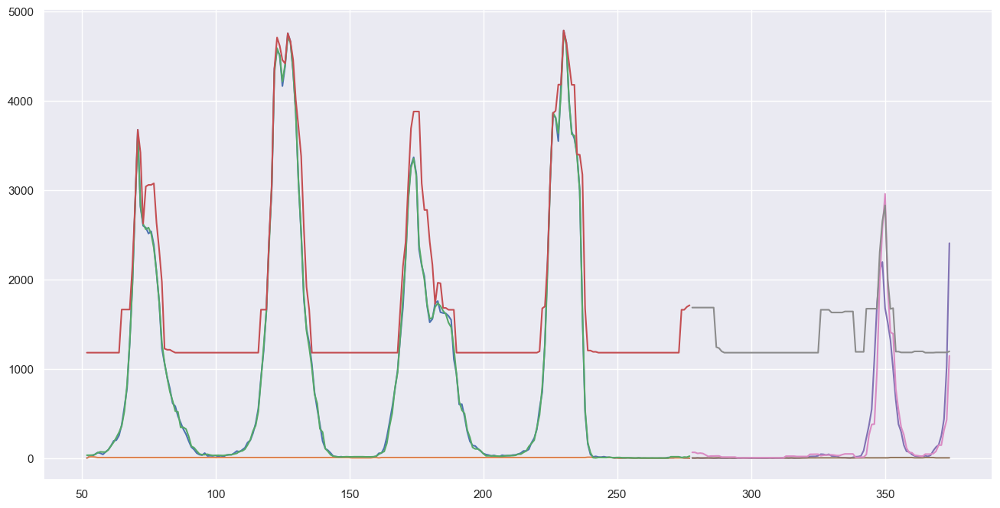

In [12]:
plt.figure()
plt.plot(predictions_train)
plt.plot(predictions_test)
# plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
# plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
# plt.title(f'{dataset} {week}-Week Ahead Influenza Predictions')
# plt.xlabel('Date')
# plt.ylabel('Cases')
# plt.legend()

In [13]:
def plot_intervals(predictions, mid=False, start=None, stop=None, title=None):
    """
    https://github.com/WillKoehrsen/Data-Analysis/blob/master/prediction-intervals/prediction_intervals.ipynb
    Function for plotting prediction intervals as filled area chart.
    
    :param predictions: dataframe of predictions with lower, upper, and actual columns (named for the target)
    :param whether to show the mid prediction
    :param start: optional parameter for subsetting start of predictions
    :param stop: optional parameter for subsetting end of predictions
    :param title: optional string title
    
    :return fig: plotly figure
    """
    # Subset if required
    predictions = (
        predictions.loc[start:stop].copy()
        if start is not None or stop is not None
        else predictions.copy()
    )
    data = []

    # Lower trace will fill to the upper trace
    trace_low = go.Scatter(
        x=predictions.index,
        y=predictions["lower"],
        fill="tonexty",
        line=dict(color="darkblue"),
        fillcolor="rgba(173, 216, 230, 0.4)",
        showlegend=True,
        name="lower",
    )
    # Upper trace has no fill
    trace_high = go.Scatter(
        x=predictions.index,
        y=predictions["upper"],
        fill=None,
        line=dict(color="orange"),
        showlegend=True,
        name="upper",
    )
    # Must append high trace first so low trace fills to the high trace
    data.append(trace_high)
    data.append(trace_low)
    
    if mid:
        trace_mid = go.Scatter(
        x=predictions.index,
        y=predictions["mid"],
        fill=None,
        line=dict(color="green"),
        showlegend=True,
        name="mid",
    )
        data.append(trace_mid)

    # Trace of actual values
    trace_actual = go.Scatter(
        x=predictions.index,
        y=predictions["actual"],
        fill=None,
        line=dict(color="black"),
        showlegend=True,
        name="actual",
    )
    data.append(trace_actual)

    # Layout with some customization
    layout = go.Layout(
        height=600,
        width=1200,
        title=dict(text="Prediction Intervals" if title is None else title),
        yaxis=dict(title=dict(text="Cases")),
        xaxis=dict(
            rangeselector=dict(
                buttons=list(
                    [
                        dict(count=1, label="1d", step="day", stepmode="backward"),
                        dict(count=7, label="1w", step="day", stepmode="backward"),
                        dict(count=1, label="1m", step="month", stepmode="backward"),
                        dict(count=1, label="YTD", step="year", stepmode="todate"),
                        dict(count=1, label="1y", step="year", stepmode="backward"),
                        dict(step="all"),
                    ]
                )
                ),
            rangeslider=dict(visible=True),
            type="date",
        ),
    )

    fig = go.Figure(data=data, layout=layout)

    # Make sure font is readable
    fig["layout"]["font"] = dict(size=15)
    fig.layout.template = "plotly_white"
    return fig

In [14]:
train_size = int(len(df_to_plot) *.7)
test_size = len(df_to_plot) - train_size

In [15]:
predictions_train['date'] = df_to_plot['Week Ending'].iloc[0:train_size]
predictions_test['date'] = df_to_plot['Week Ending'].iloc[train_size:len(df_to_plot)]

In [16]:
predictions_train = predictions_train.set_index('date')
predictions_test = predictions_test.set_index('date')

In [17]:
predictions_test

,actual,lower,mid,upper
date,,,,
2021-01-02,2.0,1.979927,65.061516,1686.226971
2021-01-09,0.0,1.979927,65.061516,1686.226971
2021-01-16,5.0,1.890354,53.417792,1686.226971
2021-01-23,0.0,2.510129,57.090945,1686.226971
2021-01-30,0.0,2.444890,52.379241,1686.226971
...,...,...,...,...
2022-10-08,149.0,3.839902,145.867601,1184.231468
2022-10-15,251.0,3.839902,145.867601,1184.231468
2022-10-22,438.0,3.839902,312.103626,1184.231468


In [18]:
predictions_train

,actual,lower,mid,upper
date,,,,
2016-09-03,2.0,2.000297,33.167223,1181.521424
2016-09-10,18.0,15.831784,33.167223,1181.521424
2016-09-17,23.0,16.089784,34.866208,1181.521424
2016-09-24,44.0,12.603177,40.285033,1181.521424
2016-10-01,63.0,6.797940,60.480550,1181.521424
...,...,...,...,...
2020-11-28,10.0,3.384408,16.065948,1181.521424
2020-12-05,8.0,4.032686,6.152239,1661.649758
2020-12-12,2.0,1.994088,13.073754,1661.649758


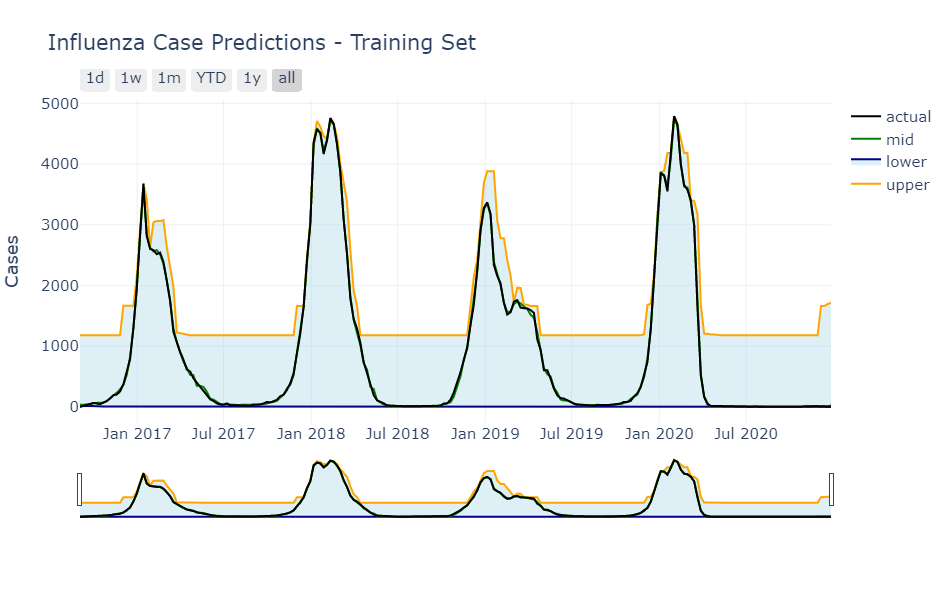

In [19]:
plot_intervals(predictions=predictions_train, start="2016-09-03", stop="2020-12-26", mid=True, title='Influenza Case Predictions - Training Set')

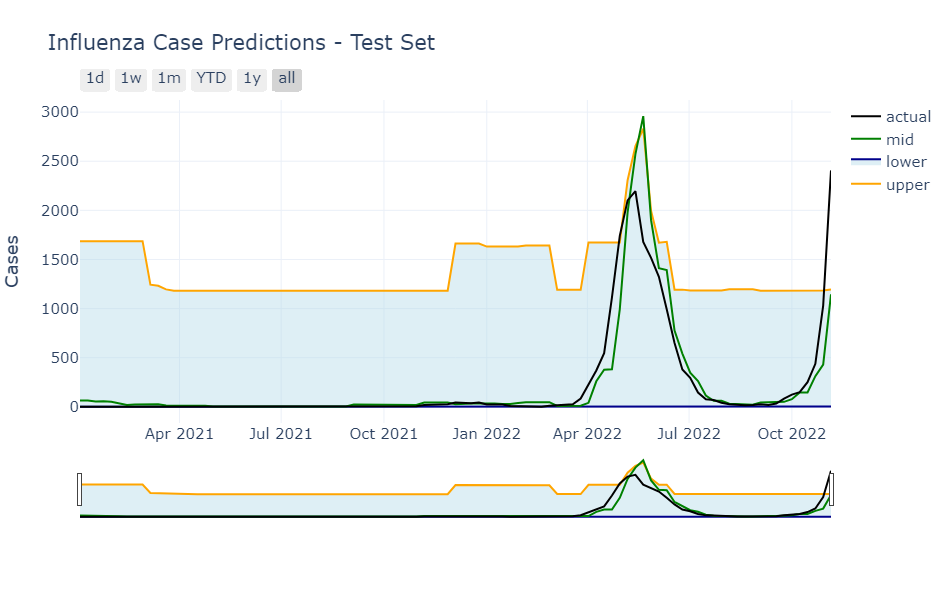

In [20]:
# plt.figure()
# plt.plot(predictions_train)
# plt.plot(predictions_test)

plot_intervals(predictions=predictions_test, start="2020-10-03", stop="2022-12-03", mid=True, title='Influenza Case Predictions - Test Set')

,Model,Dataset,Weeks-ahead Forecast,MSE_train,MSE_test,RMSE_train,RMSE_test,MAE_train,MAE_test,R2_train,R2_test
0,RF_test_2,Full Dataset,1,9026.51,415430.72,95.01,644.54,49.7,434.11,0.994843,-0.59194
0,RF_test_2,Full Dataset,2,12579.2,623953.6,112.16,789.91,57.12,538.03,0.992813,-0.492822
0,RF_test_2,Full Dataset,3,11496.91,944775.26,107.22,972.0,54.51,658.07,0.993432,-0.362659
0,RF_test_2,Full Dataset,4,12663.29,1495838.86,112.53,1223.04,56.55,823.48,0.992766,-0.187358
0,RF_test_2,Full Dataset,1,9026.51,415430.72,95.01,644.54,49.7,434.11,0.994843,-0.59194
0,RF_test_2,Full Dataset,2,12579.2,623953.6,112.16,789.91,57.12,538.03,0.992813,-0.492822
0,RF_test_2,Full Dataset,3,11496.91,944775.26,107.22,972.0,54.51,658.07,0.993432,-0.362659
0,RF_test_2,Full Dataset,4,12663.29,1495838.86,112.53,1223.04,56.55,823.48,0.992766,-0.187358
0,RF_test_2,Full Dataset,1,9026.51,415430.72,95.01,644.54,49.7,434.11,0.994843,-0.59194
0,RF_test_2,Full Dataset,2,12579.2,623953.6,112.16,789.91,57.12,538.03,0.992813,-0.492822


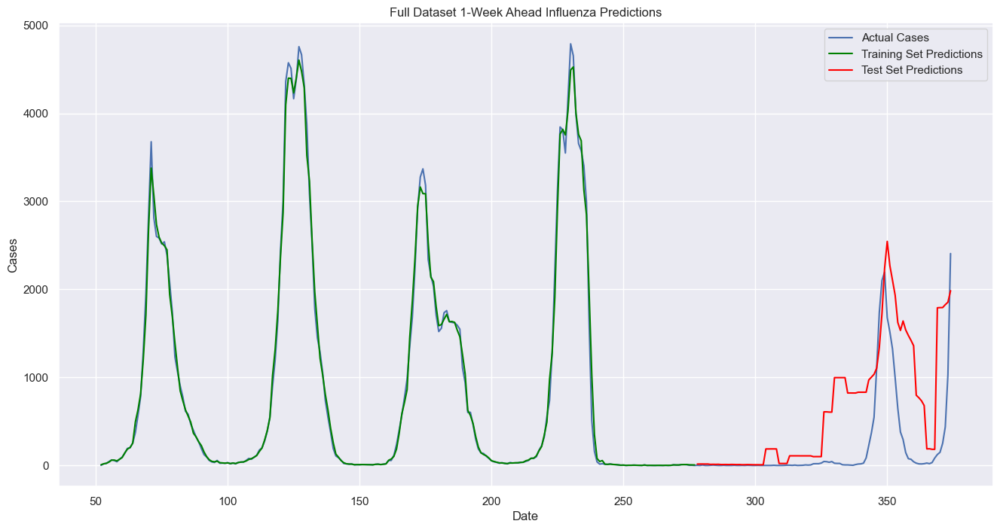

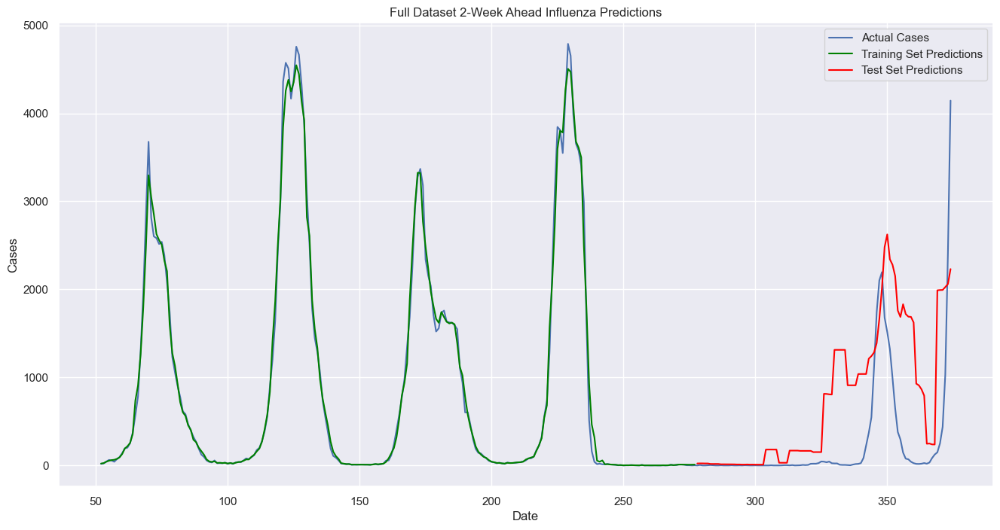

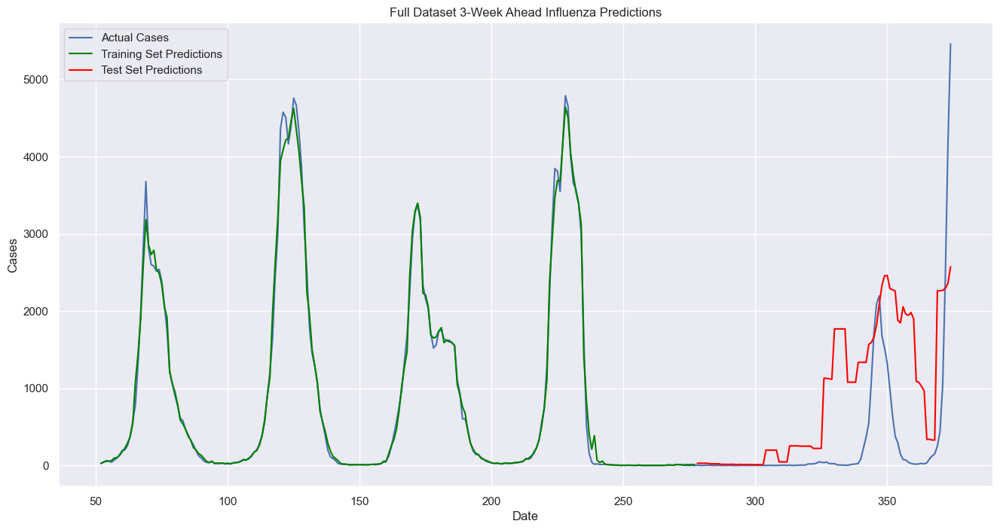

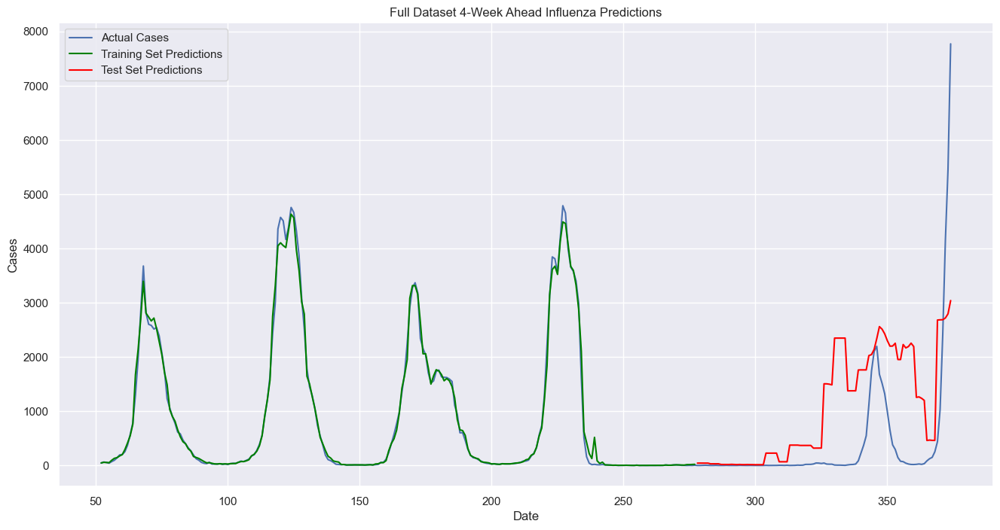

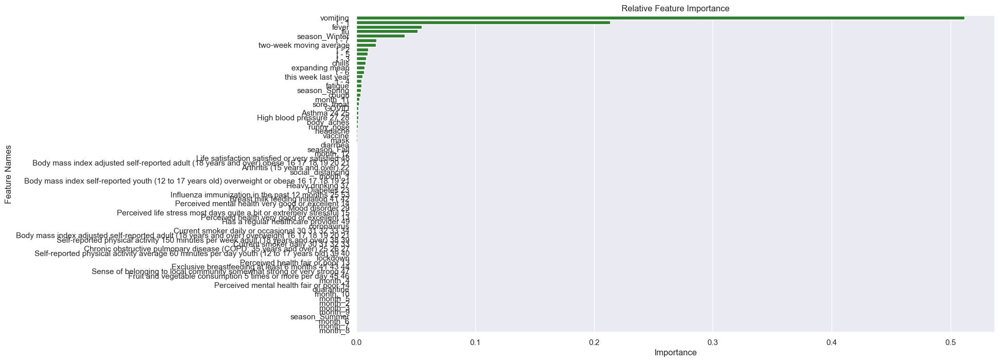

In [150]:
numeric_transform = Pipeline([('scaling', MinMaxScaler())])

categorical_transform = Pipeline([('one-hot-encode', OneHotEncoder(sparse=False))])

ct = make_column_transformer(
    (categorical_transform, cat_feats),
    (numeric_transform, num_feats),   
    remainder='passthrough')

pipeline = Pipeline(steps=[('preprocessing', ct), 
                          ('model', RandomForestRegressor(random_state=2023))])

pipeline.fit(train_X, train_y)

preds_test = pipeline.predict(test_X)
preds_test_df = pd.DataFrame(preds_test,columns=test_y.columns)
preds_train = pipeline.predict(train_X)
preds_train_df = pd.DataFrame(preds_train,columns=train_y.columns)

dataset = 'Full Dataset'
model = 'RF_test_2'

for i in range(1,5):
    results_matrix = evaluate_model(train=train_y, test=test_y, preds_train=preds_train, preds_test=preds_test, dataset=dataset, forecast_weeks=i, model=model)

# plot
week = 1
for target in preds_train_df.columns:
    plt.figure()
    plt.plot(df.index, df[target].values, label='Actual Cases')
    plt.plot(df.index[:train_size], preds_train_df[target], color='green', label='Training Set Predictions')
    plt.plot(df.index[train_size:], preds_test_df[target], color='red', label='Test Set Predictions')
    plt.title(f'{dataset} {week}-Week Ahead Influenza Predictions')
    plt.xlabel('Date')
    plt.ylabel('Cases')
    plt.legend()
    week += 1

# get feature importances from the model
# referenced https://stackoverflow.com/questions/38787612/how-to-extract-feature-importances-from-an-sklearn-pipeline
importance = pipeline.steps[1][1].feature_importances_
names = pipeline[:-1].get_feature_names_out()

df = pd.DataFrame({'Feature Names':names,'Importance':importance, })
df = df.sort_values(by='Importance', ascending = False)
df[['dtype','Feature Names']] = df['Feature Names'].str.split("__",expand=True)
df = df.drop(columns='dtype')
plt.figure()
sns.barplot(data=df, x='Importance', y='Feature Names', orient='h', color='forestgreen').set(title='Relative Feature Importance')

results_matrix

## Forecast

In [157]:
preds_future = pipeline_mid.predict(df_to_predict)
preds_future_df = pd.DataFrame(np.round(preds_future),columns=[test_y.columns[0]])
# preds_future_df = preds_future_df.rename(columns={'y1':'1-Week Forecast','y2':'2-Week Forecast','y3':'3-Week Forecast','y4':'4-Week Forecast'})

df_flu = pickle.load(open(r"..\data\flu_cases\df_flu_total.pkl", "rb" ))
dates = df_flu.index

from datetime import timedelta
dates = dates + timedelta(weeks=3)

In [160]:
preds_future_df

,y1
0,3810.0


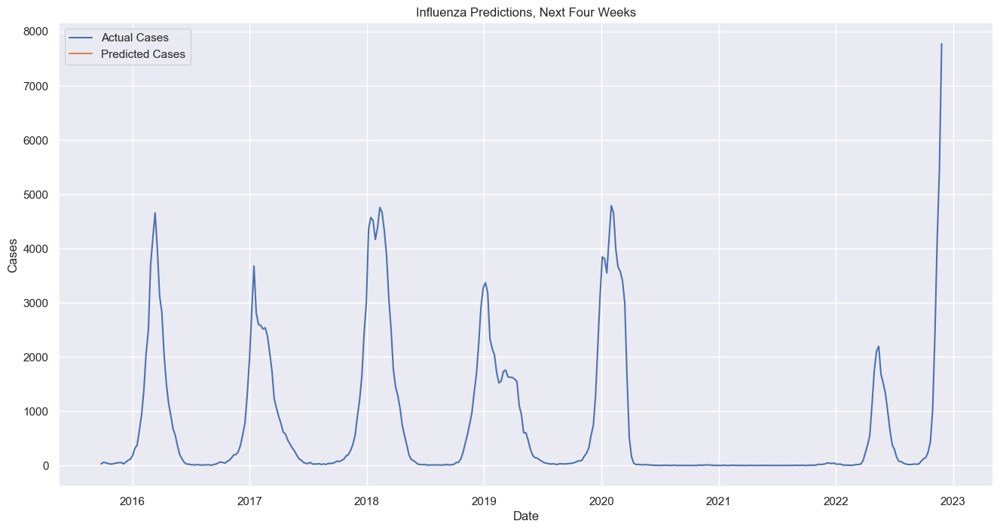

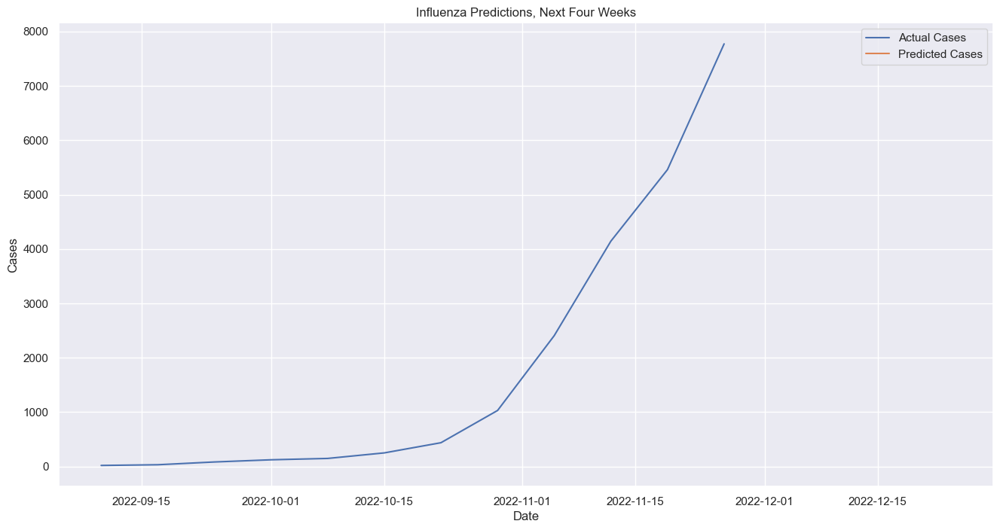

In [159]:
# all dates
plt.figure()
plt.plot(dates[:-4], df_flu[3:-1].values, label='Actual Cases')
plt.plot(dates[-1], preds_future_df.values, label='Predicted Cases')
plt.title(f'Influenza Predictions, Next Four Weeks')
plt.xlabel('Date')
plt.ylabel('Cases')
plt.legend()

# zoom plot
plt.figure()
plt.plot(dates[-16:-4], df_flu.iloc[-13:-1].values, label='Actual Cases')
plt.plot(dates[-1], preds_future_df.values, label='Predicted Cases')
plt.title(f'Influenza Predictions, Next Four Weeks')
plt.xlabel('Date')
plt.ylabel('Cases')
plt.legend()